# ***1. Intro to Perturbation Modelling (PertMod) - The GenKI paradigm***

We are going to demonstrate one of the most recent PertMod tools called GenKI (https://doi.org/10.1093/nar/gkad450) which is able to simulate digital Knock-Outs (KOs) in single-cell data, after reconstruction of Gene Regulatory Networks (GRNs) and Deep Learning modelling.

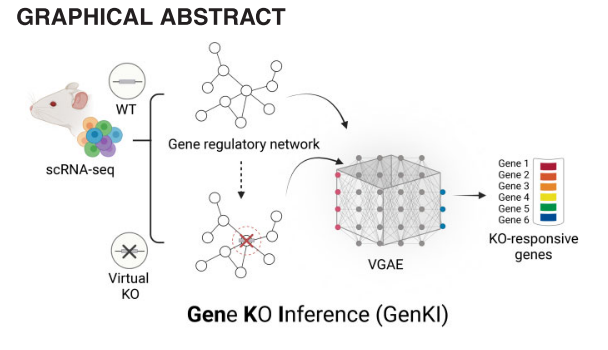

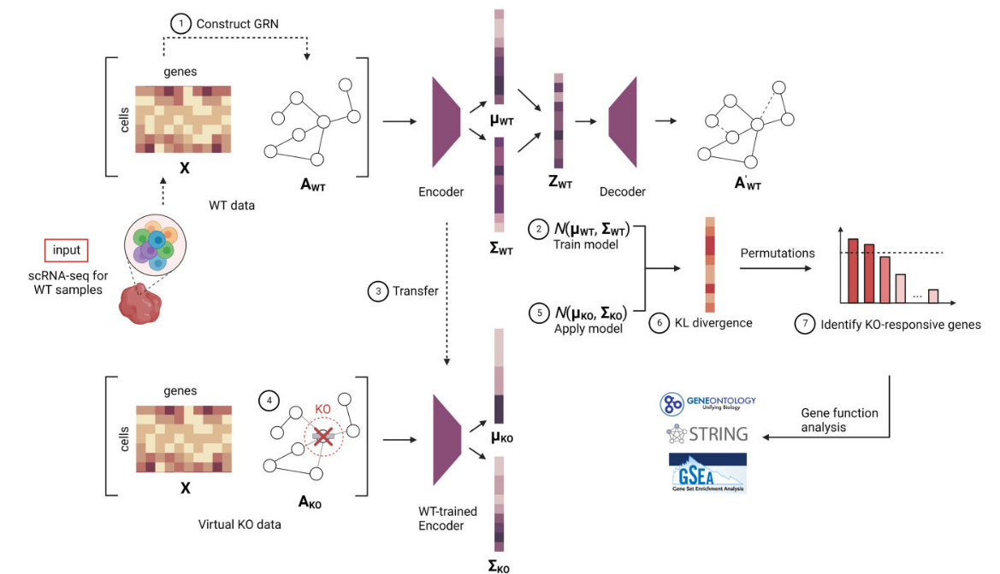

The pipeline contains seven steps:

*   ( 1 ) construction of WT scGRN,
*   ( 2 ) training VGAE (Variational Graph Autoencoder)model

*   ( 3 ) transfer the trained VGAE model
*   ( 4 ) construction of virtual KO data

*   ( 5 ) latent embeddings of WT and virtual KO data,
*   ( 6 ) calculation of KL di v ergence

*   ( 7 ) identification of KO-responsive genes
for function annotation and analysis.

The VGAE model receives as input the virtual KO data and obtains the latent distribution of the g-th gene for the KO samples. Then, the model calculates the KL (Kullback-Leibler) divergence between these two normal distributions. The procedure is repeated for all genes. The top 5% of genes ranked by the KL divergence were preserved.

Kullback-Leibler divergence metric (relative entropy) is a statistical measurement from information theory that is commonly used to quantify the difference between one probability distribution from a reference probability distribution.

In [9]:
import os
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc

sc.settings.verbosity = 0

In [10]:
import GenKI as gk
from GenKI.preprocesing import build_adata
from GenKI.dataLoader import DataLoader
from GenKI.train import VGAE_trainer
from GenKI import utils


/home/katzalis/thesis/ssh/mongoose/.venv/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2024-09-13 11:19:32,599	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


In [11]:
# Import STRINGdb for PPI network models and Networkx for visualisation and potential graph analysis
import stringdb
import networkx as nx

In [12]:
data_path = "./data"
saved_results = "./saved_results"

In [13]:
# Download the GenKI demo adata object about microglia
#!gdown  1PRsaaDUk8qFBpwUDhxSwRWmSAv6aajSU

# https://doi.org/10.1016/j.neuron.2019.12.007
import gdown
from pathlib import Path

file_id = '1PRsaaDUk8qFBpwUDhxSwRWmSAv6aajSU'
url = f'https://drive.google.com/uc?id={file_id}'
file_path = f"{data_path}/genki_demo_microglia_adata.h5ad"

if not Path(file_path).exists():
    gdown.download(url, file_path, quiet=False)

In [14]:
# subset data as an example
adata = build_adata(file_path)
adata = adata[:100, :300].copy()
adata

load counts from ./data/genki_demo_microglia_adata.h5ad


AnnData object with n_obs × n_vars = 100 × 300
    obs: 'sce_source', 'treatment', 'trem2_genotype', 'snn_cluster', 'nCount_RNA', 'nFeature_RNA'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    layers: 'norm'

In [15]:
# Assemble the data_wrapper which controls aspects of the digital KO experiment
data_wrapper =  DataLoader(
                adata, # adata object
                target_gene = ["TUBG1"], # KO gene name
                target_cell = None, # obsname for cell type, if none use all
                obs_label = "ident", # colname for genes
                GRN_file_dir = f"{saved_results}/GRNs", # folder name for GRNs
                rebuild_GRN = True, # whether build GRN by pcNet
                pcNet_name = "pcNet_example", # GRN file name
                verbose = True, # whether verbose
                )

data_wt = data_wrapper.load_data()
data_ko = data_wrapper.load_kodata()

use all the cells (100) in adata
build GRN


execution time of making pcNet: 15.67 s
GRN has been built and saved in "./saved_results/GRNs/pcNet_example.npz"
init completed



In [16]:
# init trainer

hyperparams = {"epochs": 100,
               "lr": 7e-4,
               "beta": 1e-4,
               "seed": 8096}
log_dir=None

sensei = VGAE_trainer(data_wt,
                     epochs=hyperparams["epochs"],
                     lr=hyperparams["lr"],
                     log_dir=log_dir,
                     beta=hyperparams["beta"],
                     seed=hyperparams["seed"],
                     verbose=True,
                     )

In [17]:
# %%timeit
sensei.train()

Epoch: 000, Loss: 1.5681, AUROC: 0.8432, AP: 0.7509
Epoch: 001, Loss: 1.5673, AUROC: 0.8448, AP: 0.7544
Epoch: 002, Loss: 1.5720, AUROC: 0.8464, AP: 0.7575
Epoch: 003, Loss: 1.5512, AUROC: 0.8483, AP: 0.7609
Epoch: 004, Loss: 1.5657, AUROC: 0.8502, AP: 0.7642
Epoch: 005, Loss: 1.5604, AUROC: 0.8521, AP: 0.7675
Epoch: 006, Loss: 1.5299, AUROC: 0.8541, AP: 0.7710
Epoch: 007, Loss: 1.5718, AUROC: 0.8561, AP: 0.7743
Epoch: 008, Loss: 1.5200, AUROC: 0.8582, AP: 0.7776
Epoch: 009, Loss: 1.5129, AUROC: 0.8604, AP: 0.7811
Epoch: 010, Loss: 1.5164, AUROC: 0.8625, AP: 0.7841
Epoch: 011, Loss: 1.5040, AUROC: 0.8644, AP: 0.7870
Epoch: 012, Loss: 1.5447, AUROC: 0.8663, AP: 0.7897
Epoch: 013, Loss: 1.5118, AUROC: 0.8682, AP: 0.7926
Epoch: 014, Loss: 1.4879, AUROC: 0.8702, AP: 0.7954
Epoch: 015, Loss: 1.4923, AUROC: 0.8721, AP: 0.7981
Epoch: 016, Loss: 1.4709, AUROC: 0.8741, AP: 0.8012
Epoch: 017, Loss: 1.4713, AUROC: 0.8760, AP: 0.8044
Epoch: 018, Loss: 1.4760, AUROC: 0.8780, AP: 0.8074
Epoch: 019, 

In [18]:
# get distance between wt and ko
z_mu_wt, z_std_wt = sensei.get_latent_vars(data_wt)
z_mu_ko, z_std_ko = sensei.get_latent_vars(data_ko)
dis = gk.utils.get_distance(z_mu_ko, z_std_ko, z_mu_wt, z_std_wt, by="KL")
print(dis.shape)

(300,)


In [19]:
# raw ranked gene list
res_raw = utils.get_generank(data_wt, dis, rank=True)
res_raw.head(10)

,dis,rank
TUBG1,2.533548,1
TYROBP,0.002345,2
LST1,0.002067,3
YBX1,0.002055,4
CYBA,0.001994,5
LAT2,0.001671,6
GM11808,0.001466,7
EPB41L2,0.001451,8
CRELD2,0.001379,9
STRA13,0.001375,10


In [20]:
# # if permutation test
null = sensei.pmt(data_ko, n=100, by="KL")
res = utils.get_generank(data_wt, dis, null)
res

Permutating: 100%|██████████| 100/100 [00:02<00:00, 47.03it/s]


,dis,index,hit,rank
TUBG1,2.533548,163,100,1


In [21]:
# Use STRINGdb to build a PPI network for the KO-responsive genes
genes = list(res_raw.index[1:10,])

string_ids = stringdb.get_string_ids(genes, species = 10090)   # human is 'species=9606'
network_df = stringdb.get_network(string_ids.queryItem, species = 10090, required_score=200)

In [22]:
# Focus on the top-10 genes from GenKI output
genes = list(res_raw.index[1:10,])

In [23]:
# Perform pathway enrichment
enrichment_df = stringdb.get_enrichment(string_ids.queryItem, species = 10090)
enrichment_df

,category,term,number_of_genes,number_of_genes_in_background,ncbiTaxonId,inputGenes,preferredNames,p_value,fdr,description
0,WikiPathways,WP3626,2,41,10090,"CYBA,TYROBP","Cyba,Tyrobp",0.00014,0.0269,Microglia pathogen phagocytosis pathway


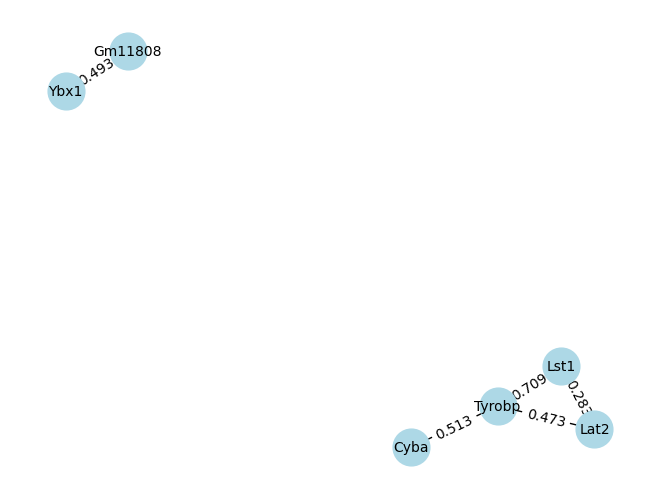

In [24]:
# Create a Networkx model
df = network_df

G = nx.Graph()

#Add edges to the graph from the DataFrame
for index, row in df.iterrows():
    G.add_edge(row['preferredName_A'], row['preferredName_B'], weight=row['score'])

# Draw the graph
pos = nx.spring_layout(G)  # positions for all nodes
nx.draw(G, pos, with_labels=True, node_size=700, node_color='lightblue', font_size=10)

# Draw edge labels with weights
edge_labels = nx.get_edge_attributes(G, 'weight')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.show()

# ***2. Intro in Multi-Task Learning (MTL)***

In this hands-on example, we are going to compare multi-task learning with single-task learning for flower type identification. In the multi-task learning approach, we will combine flower type identification with flower color identification. The input data are a subset of the Kaggle flowers dataset (https://www.kaggle.com/datasets/alxmamaev/flowers-recognition) that were previously annotated for flower type and that we have additionaly annotated with flower color.

We will start with loading the required packages and functions. All come pre-installed within Google Colab.

In [1]:
# Import required packages
from tensorflow.keras.preprocessing.image import img_to_array
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
import tensorflow as tf
import numpy as np
from imutils import paths
import cv2
import random
import os

2024-09-13 14:54:08.749482: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-13 14:54:08.768935: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-13 14:54:08.774832: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-13 14:54:08.789604: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-09-13 14:54:10.676064: W tensorflow/comp

In [2]:
# Set global variables
IMAGE_DIMS = (128, 128, 3) # dimensions for resizing of the figures
RANDOM_SEED = 123
EPOCHS = 10
BATCH_SIZE = 32

data_path = "./data"
saved_results = "./saved_results"

In [3]:
import gdown
from pathlib import Path
import zipfile


file_id = '1jD-ffliDLOhwqO0HP_R22KUdjw77dEMR'
url = f'https://drive.google.com/uc?id={file_id}'
file_path = f"{data_path}/Flowers.zip"

if not Path(file_path).exists():
    gdown.download(url, file_path, quiet=False)
    
    with zipfile.ZipFile(f"{file_path}", 'r') as zip_ref:
        zip_ref.extractall(data_path)

In [4]:
# Set dataset
dataset = f"{data_path}/Flowers"

# Set random seed for reproducible results
random.seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

# grab the image paths and randomly shuffle them
imagePaths = sorted(list(paths.list_images(dataset)))
random.shuffle(imagePaths)

# initialize the data and labels
data = []
labels = []

# loop over the input images
for imagePath in imagePaths:
	# load the image, pre-process it, and store it in the data list
	image = cv2.imread(imagePath)
	image = cv2.resize(image, (IMAGE_DIMS[1], IMAGE_DIMS[0]))
	image = img_to_array(image)
	data.append(image)
	# extract set of class labels from the image path and update the
	# labels list
	l = label = imagePath.split(os.path.sep)[-2].split("_")
	labels.append(l)
data = np.array(data)

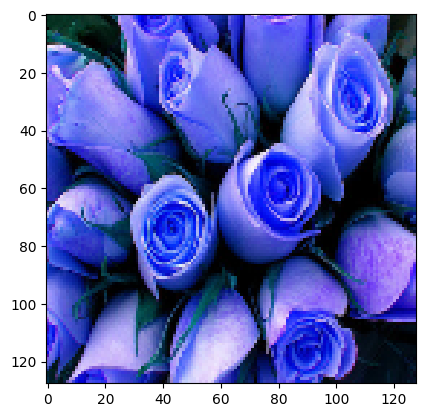

In [5]:
from matplotlib import pyplot as plt
image = cv2.imread(imagePath)
image = cv2.resize(image, (IMAGE_DIMS[1], IMAGE_DIMS[0]))
plt.imshow(image, interpolation='nearest')

In [6]:
# determine labels for the two seperate tasks
labels_color = [item[0] for item in labels]
labels_flower = [item[1] for item in labels]

In [7]:
# binarize labels
lb_color = LabelBinarizer()
labels_color = lb_color.fit_transform(labels_color)
lb_flower = LabelBinarizer()
labels_flower = lb_flower.fit_transform(labels_flower)

In [8]:
# Ensure that labels are one-hot encoded correctly
if labels_flower.shape[1] == 1:
    labels_flower = tf.keras.utils.to_categorical(labels_flower)
if labels_color.shape[1] == 1:
    labels_color = tf.keras.utils.to_categorical(labels_color)

In [9]:
# define train and test sets for the two distinct tasks
(x_train, x_test, y_train_flower, y_test_flower, y_train_color, y_test_color) = train_test_split(data,
	labels_flower, labels_color, test_size=0.2, random_state=RANDOM_SEED)
x_train = np.array(x_train)
x_test = np.array(x_test)
y_train_flower = np.array(y_train_flower)
y_test_flower = np.array(y_test_flower)
y_train_color = np.array(y_train_color)
y_test_color = np.array(y_test_color)

In [10]:
# Single-task learning model for flower type recognition
def create_single_task_model():
    model = tf.keras.models.Sequential([
        # tf.keras.layers.Conv2D(16, (3, 3), activation='relu', input_shape=IMAGE_DIMS),
        # tf.keras.layers.MaxPooling2D((2, 2)),
        tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=IMAGE_DIMS),
        tf.keras.layers.MaxPooling2D((2, 2)),
        tf.keras.layers.Conv2D(64, (3, 3), activation='relu'),
        tf.keras.layers.MaxPooling2D((2, 2)),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(128, activation='relu'),
        tf.keras.layers.Dense(len(lb_flower.classes_), activation='softmax')  # Number of flower type classes
    ])

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

single_task_model = create_single_task_model()
single_task_model.summary()

# Train the single-task model
single_task_history = single_task_model.fit(
    x_train, y_train_flower,
    validation_data=(x_test, y_test_flower),
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

/home/katzalis/thesis/ssh/mongoose/.venv/lib/python3.9/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(
2024-09-13 14:54:30.363325: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2343] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 126, 126, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 61, 61, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 30, 30, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 57600)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │     7,372,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           258 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,392,578 (28.20 MB)

 Trainable params: 7,392,578 (28.20 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - accuracy: 0.4541 - loss: 823.8669 - val_accuracy: 0.5909 - val_loss: 856.9471
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - accuracy: 0.7006 - loss: 382.1185 - val_accuracy: 0.4091 - val_loss: 49.8569
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - accuracy: 0.3523 - loss: 43.0158 - val_accuracy: 0.4091 - val_loss: 3.2933
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - accuracy: 0.7631 - loss: 2.0612 - val_accuracy: 0.5909 - val_loss: 5.1898
Epoch 5/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step - accuracy: 0.7437 - loss: 2.3325 - val_accuracy: 0.6818 - val_loss: 0.7448
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step - accuracy: 0.9569 - loss: 0.1120 - val_accuracy: 0.4545 - val_loss: 1.2236
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.9706 - loss: 0.1414 - val_accuracy: 0.5455 - val_loss: 1.3931
Epoch 8/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step - accuracy: 0.9804 - loss: 0.1165 - val_accuracy: 0.5909 - val_loss

In [11]:
# Multi-task learning model for flower type and flower color recognition
def create_multi_task_model():
    input_layer = tf.keras.layers.Input(shape=IMAGE_DIMS)
    # Shared layers
    # x = tf.keras.layers.Conv2D(16, (3, 3), activation='relu')(input_layer)
    # x = tf.keras.layers.MaxPooling2D((2, 2))(x)
    x = tf.keras.layers.Conv2D(32, (3, 3), activation='relu')(input_layer)
    x = tf.keras.layers.MaxPooling2D((2, 2))(x)
    x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu')(x)
    x = tf.keras.layers.MaxPooling2D((2, 2))(x)
    x = tf.keras.layers.Flatten()(x)
    x = tf.keras.layers.Dense(128, activation='relu')(x)

    # Task 1: Flower type recognition
    flower_type_output = tf.keras.layers.Dense(len(lb_flower.classes_), activation='softmax', name='flower_type')(x)

    # Task 2: Flower color recognition
    flower_color_output = tf.keras.layers.Dense(len(lb_color.classes_), activation='softmax', name='flower_color')(x)

    model = tf.keras.models.Model(inputs=input_layer, outputs=[flower_color_output, flower_type_output])

    model.compile(optimizer='adam',
                  loss={'flower_type': 'categorical_crossentropy', 'flower_color': 'categorical_crossentropy'},
                  metrics={'flower_type': 'accuracy', 'flower_color': 'accuracy'})
    return model

multi_task_model = create_multi_task_model()
multi_task_model.summary()

# Train the multi-task model
multi_task_history = multi_task_model.fit(
    x_train, {'flower_type': y_train_flower, 'flower_color': y_train_color},
    validation_data=(x_test, {'flower_type': y_test_flower, 'flower_color': y_test_color}),
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 126, 126,  │        896 │ input_layer_1[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 63, 63,    │          0 │ conv2d_2[0][0]    │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 61, 61,    │     18,496 │ max_pooling2d_2[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 30, 30,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_1 (Flatten) │ (None, 57600)     │          0 │ max_pooling2d_3[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 128)       │  7,372,928 │ flatten_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flower_color        │ (None, 3)         │        387 │ dense_2[0][0]     │
│ (Dense)             │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flower_type (Dense) │ (None, 2)         │        258 │ dense_2[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 7,392,965 (28.20 MB)

 Trainable params: 7,392,965 (28.20 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 175ms/step - flower_color_accuracy: 0.3386 - flower_type_accuracy: 0.5987 - loss: 788.2289 - val_flower_color_accuracy: 0.3636 - val_flower_type_accuracy: 0.5909 - val_loss: 1243.7601
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - flower_color_accuracy: 0.1958 - flower_type_accuracy: 0.7006 - loss: 1164.7729 - val_flower_color_accuracy: 0.3636 - val_flower_type_accuracy: 0.6818 - val_loss: 74.5846
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - flower_color_accuracy: 0.3915 - flower_type_accuracy: 0.7455 - loss: 74.2504 - val_flower_color_accuracy: 0.6364 - val_flower_type_accuracy: 0.7727 - val_loss: 49.9896
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - flower_color_accuracy: 0.7807 - flower_type_accuracy: 0.7222 - loss: 19.2500 - val_flower_color_accuracy: 0.5000 - val_flower_type_accuracy: 0.6818 - val_loss: 20.6068
Epoch 5/10
1/3 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step - flower_color_accuracy: 0.8438 - flower_type_accuracy: 0.8438 - los

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - flower_color_accuracy: 0.7338 - flower_type_accuracy: 0.8415 - loss: 4.0952 - val_flower_color_accuracy: 0.5909 - val_flower_type_accuracy: 0.8182 - val_loss: 7.1654
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - flower_color_accuracy: 0.7163 - flower_type_accuracy: 0.9941 - loss: 6.5174 - val_flower_color_accuracy: 0.6364 - val_flower_type_accuracy: 0.8636 - val_loss: 9.4777
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - flower_color_accuracy: 0.8904 - flower_type_accuracy: 0.9472 - loss: 1.9383 - val_flower_color_accuracy: 0.6818 - val_flower_type_accuracy: 0.7727 - val_loss: 10.2771
Epoch 8/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - flower_color_accuracy: 0.9726 - flower_type_accuracy: 1.0000 - loss: 0.7638 - val_flower_color_accuracy: 0.8636 - val_flower_type_accuracy: 0.7727 - val_loss: 4.8446
Epoch 9/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - flower_color_accuracy: 0.9374 - flower_type_accuracy: 1.0000 - loss: 0.6052 - val_flower_co

In [12]:
# Evaluate single-task model performance
single_task_eval = single_task_model.evaluate(x_test, y_test_flower, verbose=0)
print(f"Single-task model flower type loss: {single_task_eval[0]}")
print(f"Single-task model flower type accuracy: {single_task_eval[1]*100:.2f}%")


Single-task model flower type loss: 1.053435206413269
Single-task model flower type accuracy: 59.09%


In [21]:
# Evaluate multi-task model performance (only flower type output)
multi_task_eval = multi_task_model.evaluate(x_test, {'flower_type': y_test_flower, 'flower_color': y_test_color}, verbose=0, return_dict=True)
print(f"Multi-task model overall loss: {multi_task_eval['loss']}")
print(f"Multi-task model flower type accuracy: {multi_task_eval['flower_type_accuracy']*100:.2f}%")
print(f"Multi-task model flower color accuracy: {multi_task_eval['flower_color_accuracy']*100:.2f}%")

Multi-task model overall loss: 5.420475006103516
Multi-task model flower type accuracy: 77.27%
Multi-task model flower color accuracy: 77.27%


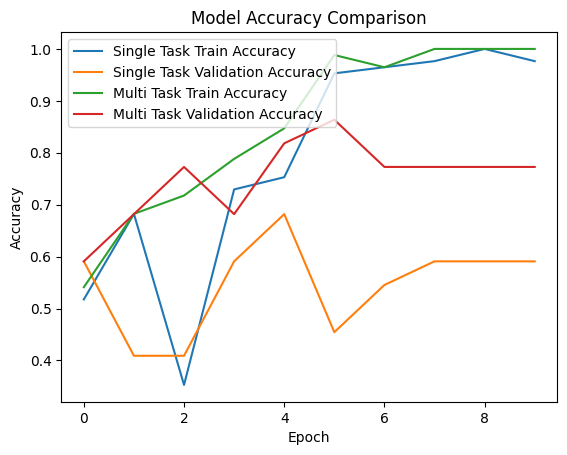

In [22]:
# Plotting accuracy for comparison
plt.plot(single_task_history.history['accuracy'], label='Single Task Train Accuracy')
plt.plot(single_task_history.history['val_accuracy'], label='Single Task Validation Accuracy')
plt.plot(multi_task_history.history['flower_type_accuracy'], label='Multi Task Train Accuracy')
plt.plot(multi_task_history.history['val_flower_type_accuracy'], label='Multi Task Validation Accuracy')
plt.title('Model Accuracy Comparison')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

# ***3. The Mongoose prototype***

For this demonstration of the Mongoose prototype, we will try to connect PertMod to MTL by combining:

*   An established MTL approach like **UnitedNet**
*   A PertMod tool like **GenKI** for digital KOs

Objective:
*   Retrieve KO-responsive genes by GenKI
*   Trace these genes to different micro-anatomical regions on the DBiT-seq through SHAP explainability





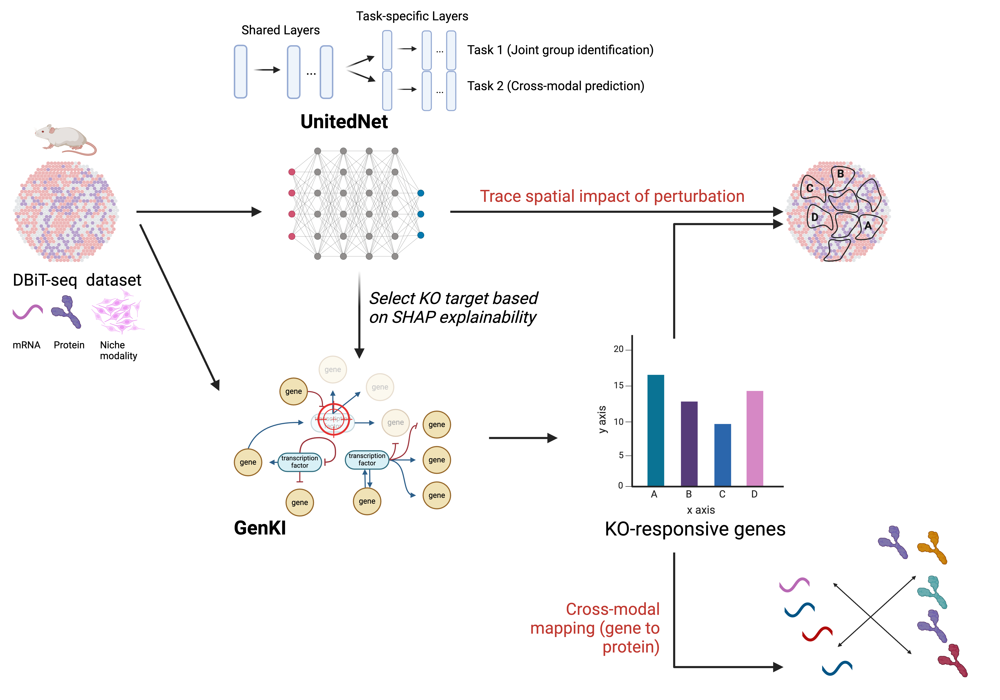

This is an overview on what we are trying to accomplish here. Showcasing the added value of pursuing multi-task learning in perturbation modelling by combining an existing MTL arcitecture (UnitedNet) with a perturbation modelling tool like GenKI to:

*   Trace the spatial impact of a digital KO
*   Trace the impact of the digital KO across modalities (genes, proteins)



# 3.1 Digital KOs with GenKI on DBiT-seq



Our dataset of choice is the DBiT-seq dataset concerning a mouse embryo, which stands for deterministic barcoding in tissue for spatial omics sequencing (DBiT-seq) for co-mapping of mRNAs and proteins in a formaldehyde-ﬁxed tissue slide via next-generation sequencing (NGS) (https://doi.org/10.1016/j.cell.2020.10.026)

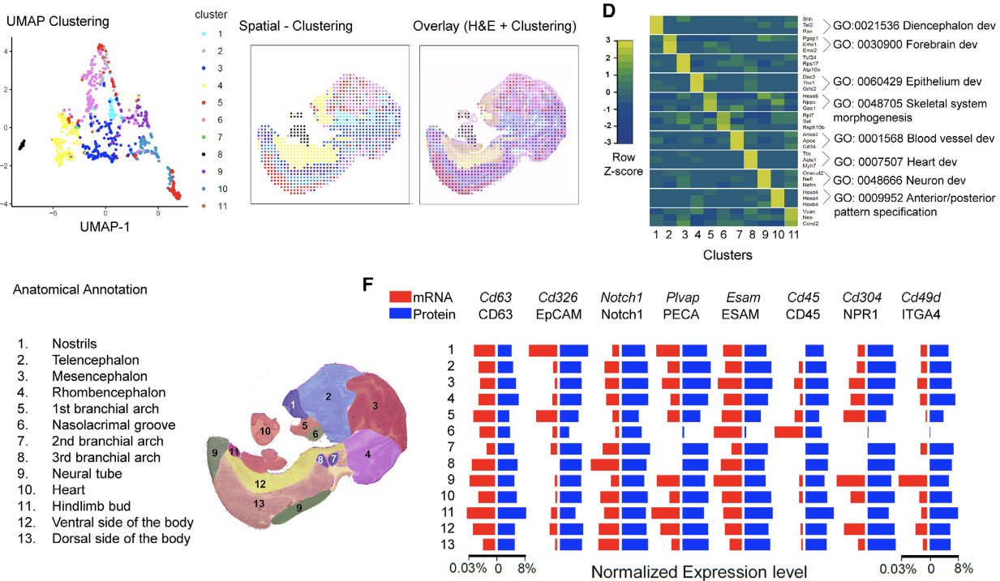

In [43]:
# Libraries for data wrangling on the adata object
import scanpy as sc
from scipy.sparse import csr_matrix
from scipy.sparse import issparse
import GenKI as gk
from GenKI.preprocesing import build_adata
from GenKI.dataLoader import DataLoader
from GenKI.train import VGAE_trainer
from GenKI import utils
import stringdb
import math
import networkx as nx

In [28]:
data_path = "./data"
saved_results = "./saved_results"

In [29]:
# Download the DBiT-seq dataset suitable for this workshop

import gdown
from pathlib import Path

file_id = '1D3AIjshsAiIOktmFrvMgqKO1UKiQSPbu'
url = f'https://drive.google.com/uc?id={file_id}'
file_path = "/g/kreshuk/katzalis/data/DBiTseq_UnitedNet.h5ad"

if not Path(file_path).exists():
    gdown.download(url, file_path, quiet=False)

# Assemble adata object for single-cell analysis
adata = sc.read(file_path)
adata

AnnData object with n_obs × n_vars = 936 × 568
    obs: 'id', 'array_row', 'array_col', 'cell_type', 'batch', 'imagecol', 'imagerow', 'label', 'sample'
    var: 'gene_ids-0', 'gene_ids-1'
    obsm: 'spatial'

Our experiment consists of perturbing the transcription factor ***Six2*** which is a member of the vertebrate gene family which encode proteins homologous to the Drosophila 'sine oculis' homeobox protein. The encoded protein is a transcription factor which, like other members of this gene family, may be involved in limb or eye development. Six2 is also involved in malignancies like the Wilms tumor which is also known as nephroblastoma, the most common cancer of the kidneys in children. (https://doi.org/10.1016/j.devcel.2012.07.008)

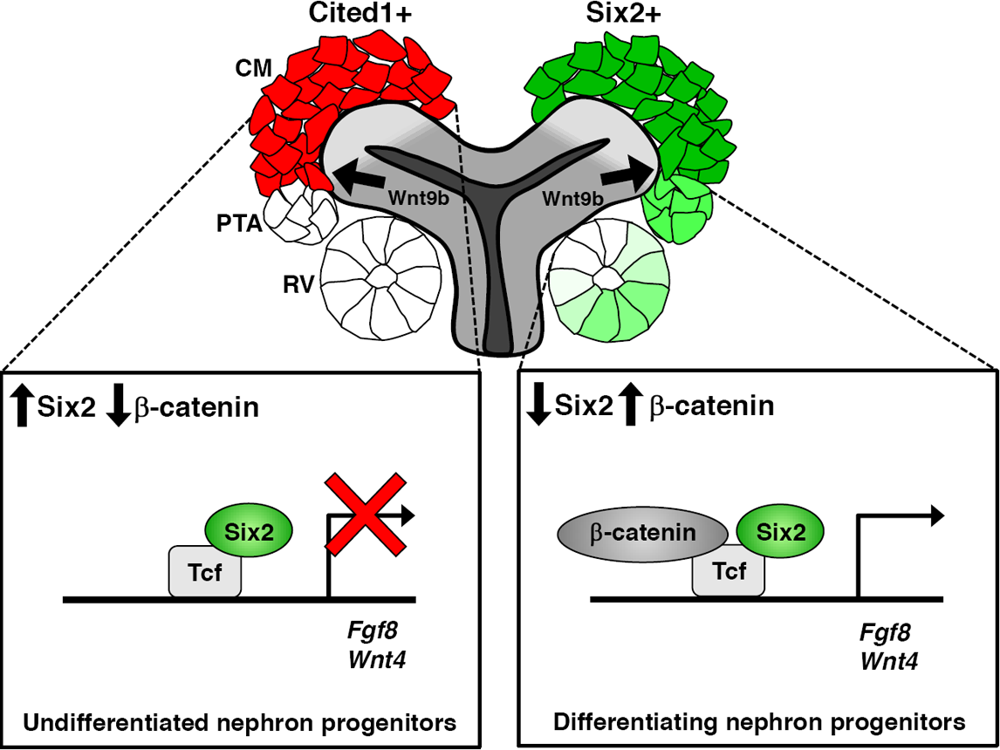

In [30]:
# Let's commence with creating a digital KO of Six2 expression in the DBiT-seq mouse embryo dataset.
gene_of_interest = "Six2"

# Verify that the gene of interest is part of the rownames in adata.var
if gene_of_interest in adata.var.index:
    print(f"The gene {gene_of_interest} is present in the rownames of adata.var.")
else:
    print(f"The gene {gene_of_interest} is not present in the rownames of adata.var.")

The gene Six2 is present in the rownames of adata.var.


In [31]:
# adata pre-processing to prepare for input in the GenKI tool
adata.layers["norm"] = adata.X.copy()

# The adata.X should be normalised-scaled AND in sparse matrix format!
if not issparse(adata.X):
    sparse_matrix = csr_matrix(adata.X)
    adata.X = sparse_matrix
    print("Converted adata.X to a sparse matrix.")
else:
    print("adata.X is already a sparse matrix.")

Converted adata.X to a sparse matrix.


In [32]:
# load data

data_wrapper =  DataLoader(
                adata, # adata object
                target_gene = [gene_of_interest], # KO gene name
                target_cell = None, # obsname for cell type, if none use all
                obs_label = "ident", # colname for genes
                GRN_file_dir = f"{saved_results}/GRNs", # folder name for GRNs
                rebuild_GRN = True, # whether build GRN by pcNet
                pcNet_name = "DBiTseq_example", # GRN file name
                verbose = True, # whether verbose
                n_cpus = 8, # multiprocessing
                )

data_wt = data_wrapper.load_data()
data_ko = data_wrapper.load_kodata()

use all the cells (936) in adata
build GRN


2024-09-13 16:01:12,618	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 8 CPUs
execution time of making pcNet: 109.00 s
GRN has been built and saved in "./saved_results/GRNs/DBiTseq_example.npz"
init completed



In [33]:
#Changed the hyperparameters to better adapt to the spatial dataset in hand

hyperparams = {
    "epochs": 300,  # Increased epochs for more training
    "lr": 5e-2,  # Adjusted learning rate
    "beta": 5e-4,  # Increased beta for stronger regularization
    "seed": 8096  # Trying a different seed
}


log_dir = None

sensei = VGAE_trainer(
    data_wt,
    epochs=hyperparams["epochs"],
    lr=hyperparams["lr"],
    log_dir=log_dir,
    beta=hyperparams["beta"],
    seed=hyperparams["seed"],
    verbose=False,
)

In [34]:
# %%timeit
sensei.train()

In [35]:
# get distance between wt and ko

z_mu_wt, z_std_wt = sensei.get_latent_vars(data_wt)
z_mu_ko, z_std_ko = sensei.get_latent_vars(data_ko)
dis = gk.utils.get_distance(z_mu_ko, z_std_ko, z_mu_wt, z_std_wt, by="KL")
print(dis.shape)

(568,)


In [36]:
# raw ranked gene list

res_raw = utils.get_generank(data_wt, dis, rank=True)
res_raw.head(10)

,dis,rank
Six2,5555.918966,1
Col3a1,4.460941,2
Vcan,2.737119,3
Col1a2,2.451330,4
Gpc3,1.876026,5
Col4a1,1.864033,6
Lgals1,1.832983,7
Rbp1,1.625187,8
Fbn2,1.540968,9
Cxcl12,1.518356,10


Top 10 Pathways:
18         Branching morphogenesis of an epithelial tube
17                                    Limb morphogenesis
16                           Skeletal system development
164    Immunoregulatory interactions between a Lympho...
43                        Fibrillar collagen, C-terminal
14                                    Tissue development
15                                      Tube development
40                              ECM-receptor interaction
8                                    Extracellular space
163               Signaling by Receptor Tyrosine Kinases
Name: description, dtype: object


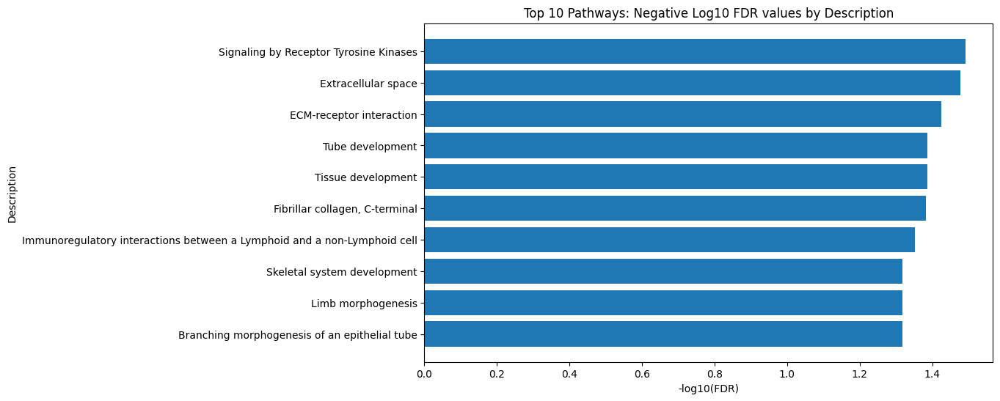

In [41]:
# Let's create a STRINGdb network of the targets affected by the Six2 digital KO on the DBiT-seq dataset
genes = list(res_raw.index[1:10,])

string_ids = stringdb.get_string_ids(genes, species = 10090)   # human is 'species=9606'

# Performe pathway enrichment
enrichment_df = stringdb.get_enrichment(string_ids.queryItem, species = 10090)
enrichment_df
df = enrichment_df
sorted_df = df.sort_values(by='fdr', ascending=False)

# Select the top 10 pathways to visualise
top_10_pathways = sorted_df['description'].head(10)

print("Top 10 Pathways:")
print(top_10_pathways)

# Plotting negative log10 of FDR values against description to discern most significant pathways
plt.figure(figsize=(10, 6))
plt.barh(sorted_df['description'].head(10), -1 * sorted_df['fdr'].head(10).apply(lambda x: math.log10(x)))
plt.xlabel('-log10(FDR)')
plt.ylabel('Description')
plt.title('Top 10 Pathways: Negative Log10 FDR values by Description')
plt.show()

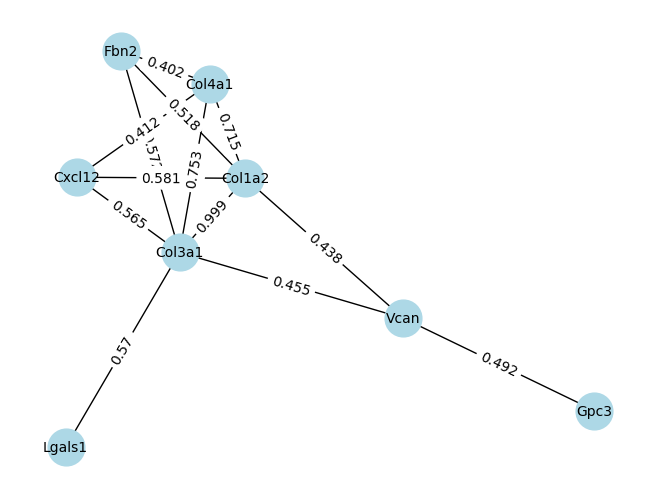

In [44]:
# Preparing visualization of STRINGdb network with Networkx
network_df = stringdb.get_network(string_ids.queryItem, species = 10090, required_score=400)
df = network_df
G = nx.Graph()
for index, row in df.iterrows():
    G.add_edge(row['preferredName_A'], row['preferredName_B'], weight=row['score'])

# Draw the graph
pos = nx.spring_layout(G)  # positions for all nodes
nx.draw(G, pos, with_labels=True, node_size=700, node_color='lightblue', font_size=10)

# Draw edge labels with weights
edge_labels = nx.get_edge_attributes(G, 'weight')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.show()

# 3.2 UnitedNet on DBiT-seq

Spatial omics simultaneously measure spatially resolved multi-omics data in intact tissue networks. UnitedNet extracts the cell neighborhood information as an additional modality together with other modalities for unsupervised/supervised group identiﬁcation and cross-
modal prediction.

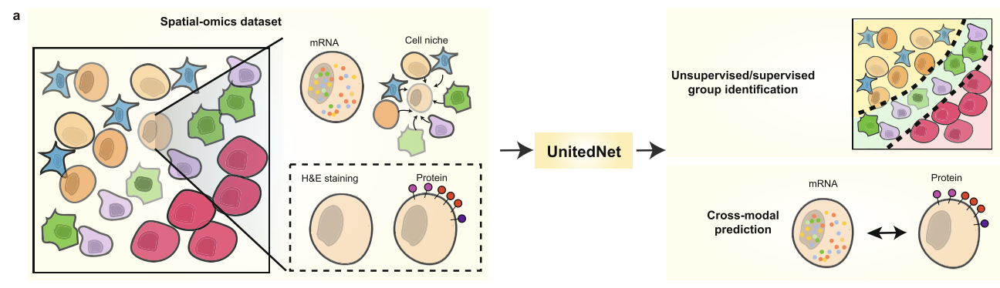

UnitedNet introduces the context "Niche Modality":


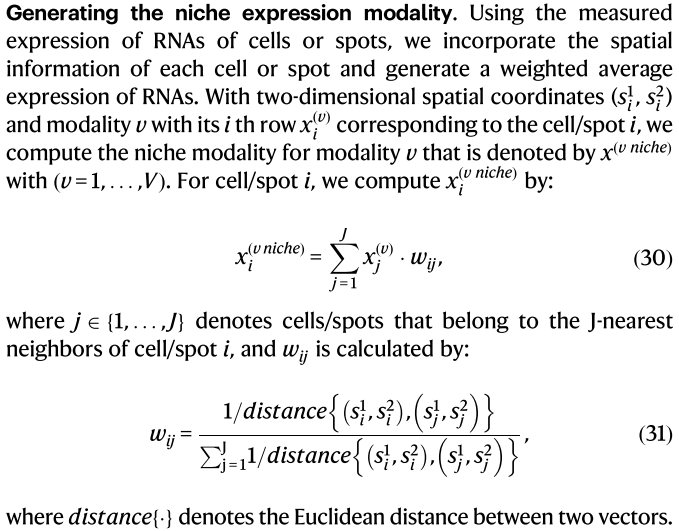

In [46]:
# Import libraries from general conda environment
import anndata as ad
import numpy as np
import scanpy as sc
import pandas as pd
from scipy.stats import spearmanr, pearsonr
from sklearn.metrics import adjusted_rand_score, confusion_matrix, accuracy_score
from sklearn.utils.multiclass import unique_labels
from scipy.optimize import linear_sum_assignment
import copy as copy
import pickle
from functools import reduce

# Import libraries from UnitedNet
import sys
import os
from unitednet.interface import UnitedNet
from unitednet.configs import *
from unitednet.data import partitions,save_umap,generate_adata
from unitednet.scripts import ordered_cmat,assignmene_align

# Import for SHAPs
import shap
import torch
import torch.nn as nn
from unitednet.modules import submodel_trans, submodel_clus
from unitednet.data import save_obj, load_obj, type_specific_mean
from unitednet.plots import markers_chord_plot,type_relevance_chord_plot,feature_relevance_chord_plot,merge_sub_feature

# Import for plotting
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.neighbors import NearestNeighbors

# Import for more detailed plotting
import matplotlib as mpl
from  matplotlib.ticker import FuncFormatter

# Import STRINGdb for PPI network models and Networkx for visualisation and potential graph analysis
import stringdb
import networkx as nx
import math

In [47]:
from sklearn import preprocessing
def change_label(adata,batch):
    adata.obs['batch'] = batch
    adata.obs['imagecol'] = adata.obs['array_col']
    adata.obs['imagerow'] = adata.obs['array_row']
    adata.obs['label'] = adata.obs['cell_type']
    return adata


def pre_ps(adata_list,sc_pre = None):
    adata_list_all = [ad_x.copy() for ad_x in adata_list]
    scalars = []
    assert (adata_list_all[0].X>=0).all(), "poluted input"
    for idx, mod in enumerate(adata_list_all):
        t_x = mod.X
        if sc_pre != None:
            scaler = sc_pre[idx]
        else:
            scaler = preprocessing.StandardScaler().fit(t_x)
        t_x = scaler.transform(t_x)
        mod.X = t_x
        adata_list_all[idx] = mod
        scalars.append(scaler)

    return adata_list_all,scalars

In [50]:
# Prepare for cpu processing (GPU is also an option...)
technique = 'dbitseq'
data_path = f"./data/{technique}"
root_save_path = f"./saved_results/{technique}"
device = "cuda:0"
# device = "cpu"

In [52]:
# Load input datasets

# RNA Modality
adata_rna_train = sc.read_h5ad(f'{data_path}/adata_rna_train.h5ad')
adata_rna_test = sc.read_h5ad(f'{data_path}/adata_rna_test.h5ad')

# Protein Modality
adata_protein_train = sc.read_h5ad(f'{data_path}/adata_protein_train.h5ad')
adata_protein_test = sc.read_h5ad(f'{data_path}/adata_protein_test.h5ad')

# Niche Modality
adata_niche_rna_train = sc.read_h5ad(f'{data_path}/adata_niche_rna_train.h5ad')
adata_niche_rna_test = sc.read_h5ad(f'{data_path}/adata_niche_rna_test.h5ad')

In [53]:
# Prepare train and testing datasets for UnitedNet
adata_rna_train = change_label(adata_rna_train,'train')
adata_protein_train=change_label(adata_protein_train,'train')
adata_niche_rna_train=change_label(adata_niche_rna_train,'train')

adata_rna_test = change_label(adata_rna_test,'test')
adata_protein_test = change_label(adata_protein_test,'test')
adata_niche_rna_test = change_label(adata_niche_rna_test,'test')

# Merge the 3 modalities of DBiT-seq data into 1 adata object for training and testing data
adatas_train = [adata_rna_train, adata_protein_train, adata_niche_rna_train]
adatas_test = [adata_rna_test, adata_protein_test, adata_niche_rna_test]

# Merge train and test
adatas_all = []
for ad_train, ad_test in zip(adatas_train,adatas_test):
    ad_all = ad_train.concatenate(ad_test,batch_key='sample')
    ad_all = change_label(ad_all,'test')
    adatas_all.append(ad_all)
adatas_all,_ = pre_ps(adatas_all)

adatas_train,_ = pre_ps(adatas_train)
adatas_test,_ = pre_ps(adatas_test)

X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.


In [59]:

train_model = True # False = Model already trained and saved in saved_results folder
model = UnitedNet(root_save_path, device=device, technique=dbitseq_config)

if train_model:
    model.train(adatas_train,verbose=True)
    model.finetune(adatas_all,verbose=True)
    #model.transfer(adatas_train, adatas_transfer = adatas_test, verbose=True)

else:
    model.load_model(f"{root_save_path}/train_best.pt", device=device)

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


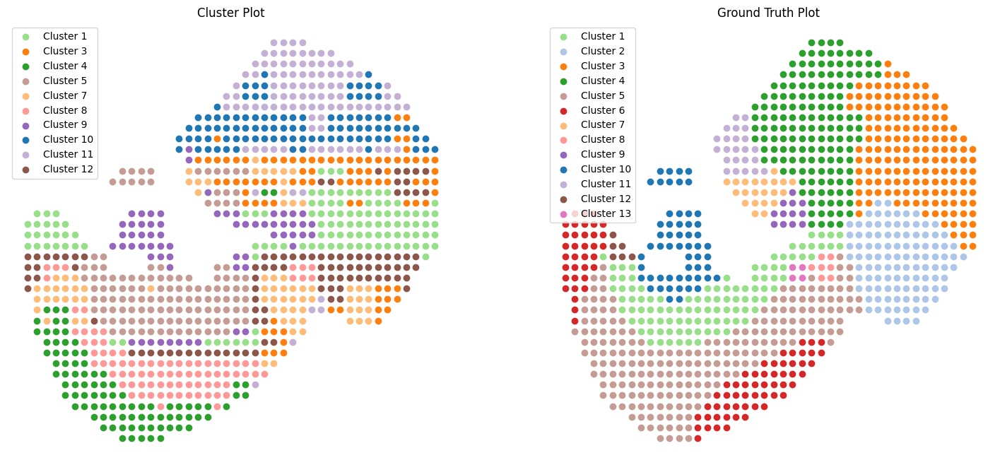

In [60]:
# Predict the spatial domains on DBiT-seq dataset based on the UnitedNet model
predict_label = model.predict_label(adatas_all)

# Smooth and Plot results
coord = np.array((list(adatas_all[0].obs['array_row'].astype('int')),
                  list(adatas_all[0].obs['array_col'].astype('int')))).T

united_clus = list(predict_label)

unique_predicted_clusters = np.unique(united_clus)

# Perform NearestNeighbors to complete domain identification
# nbrs = NearestNeighbors(n_neighbors=35, algorithm='brute', metric= "minkowski").fit(coord)
# distances,indices = nbrs.kneighbors(coord)

nbrs = NearestNeighbors(n_neighbors=5, algorithm='ball_tree').fit(coord)
distances,indices = nbrs.kneighbors(coord)

united_clus_new = []
for indi, i in enumerate(united_clus):
    occurence_count = Counter(np.array(united_clus)[indices[indi]])
    united_clus_new.append(occurence_count.most_common(1)[0][0])

cluster_pl = sns.color_palette('tab20', 20)
color_list = [cluster_pl[5],
              cluster_pl[1],
              cluster_pl[2],
              cluster_pl[4],
              cluster_pl[11],
              cluster_pl[6],
              cluster_pl[3],
              cluster_pl[7],
              cluster_pl[8],
              cluster_pl[0],
              cluster_pl[9],
              cluster_pl[10],
              cluster_pl[12]]

# Plotting the DBiT-seq spatially clustered data
fig, axes = plt.subplots(1, 2, figsize=(18, 8))

# Plotting the first subplot (Cluster scatter plot)
for idx, clus_id in enumerate(set(united_clus_new)):
    axes[0].scatter(
        adatas_all[0].obs['array_row'][united_clus_new == clus_id],
        adatas_all[0].obs['array_col'][united_clus_new == clus_id],
        color=color_list[clus_id],
        cmap='tab20',
        label=f"Cluster {clus_id + 1}"
    )

axes[0].axis('off')
axes[0].legend()
axes[0].invert_yaxis()
axes[0].set_title("Cluster Plot")

# Plotting the second subplot (Ground truth scatter plot)
for idx in range(13):
    cluster_ids = adatas_all[0].obs['cell_type'] == idx
    axes[1].scatter(
        adatas_all[0].obs['array_row'][cluster_ids],
        adatas_all[0].obs['array_col'][cluster_ids],
        color=color_list[idx],
        cmap='tab20',
        label=f"Cluster {idx + 1}"
    )

axes[1].axis('off')
axes[1].legend()
axes[1].invert_yaxis()
axes[1].set_title("Ground Truth Plot")

# Display the plots
plt.show()

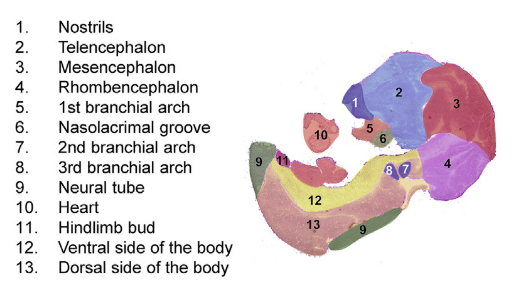

These are the ground-truth labels provided by the original DBiT-seq dataset

Cluster 0
['Aagab' 'Adgrl2' 'Ccdc34' 'Dclk1' 'Echs1' 'Edf1' 'Fzd2' 'Hdac4' 'Irx2'
 'Kdm6b' 'Larp7' 'Lhx1' 'Ncam1' 'Nsg2' 'Polr1b' 'Rpl17-ps8' 'Sdf2l1'
 'Six2' 'Tcf7l2' 'Tomm6' 'CD102.ICAM2' 'CD117.KIT' 'CD201.EPCR'
 'CD304.NPR1' 'CD309.KDR' 'CD41.ITGA2B' 'CD45.PTPRC' 'CD63' 'ESAM'
 'FCER1A' 'Folate.Receptor' 'Ly.6A.E' 'MAdCAM.1' 'NK.1.1.KLRB1' 'Notch1'
 'P2RY12' 'SiglecH.SIGLEC' 'ErythroidCells.LY76' 'CD326.Ep.CAM'
 'PanendothelialCellAntigen' 'Adgrl2' 'Cand2' 'Ccdc34' 'Cd2bp2' 'Dnajc3'
 'Epb41l3' 'Gldc' 'Irx2' 'Limch1' 'Mif' 'Pkdcc' 'Rchy1' 'Rest' 'Sall2'
 'Tenm3' 'Tgfbi' 'Wls' 'Zeb2' 'Zfp157' 'Zyx' '0']
Cluster 10
['Aldh1a3' 'Alx3' 'Angptl2' 'Bcl11a' 'C130093G08Rik' 'Edf1' 'Larp7'
 'Ncam1' 'Nr2e1' 'Olig2' 'Pak3' 'Pdgfa' 'Plpp3' 'Prox1' 'Rpl17-ps8'
 'Sap30' 'Sdf2l1' 'Six2' 'Tomm6' 'Zeb2' 'CD102.ICAM2' 'CD117.KIT'
 'CD201.EPCR' 'CD304.NPR1' 'CD309.KDR' 'CD41.ITGA2B' 'CD45.PTPRC' 'CD55'
 'CD63' 'ESAM' 'FCER1A' 'Folate.Receptor' 'Ly.6A.E' 'NK.1.1.KLRB1'
 'Notch1' 'P2RY12' 'SiglecH.SIGLEC

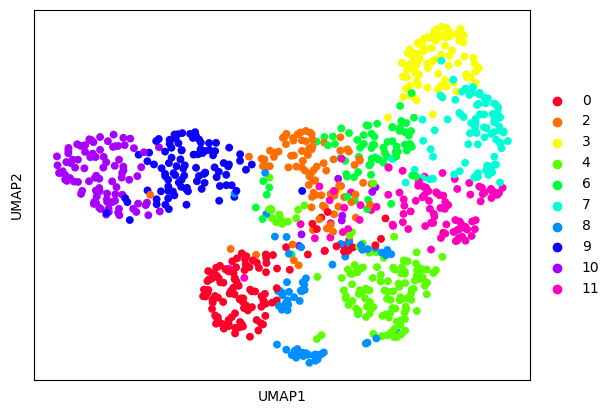

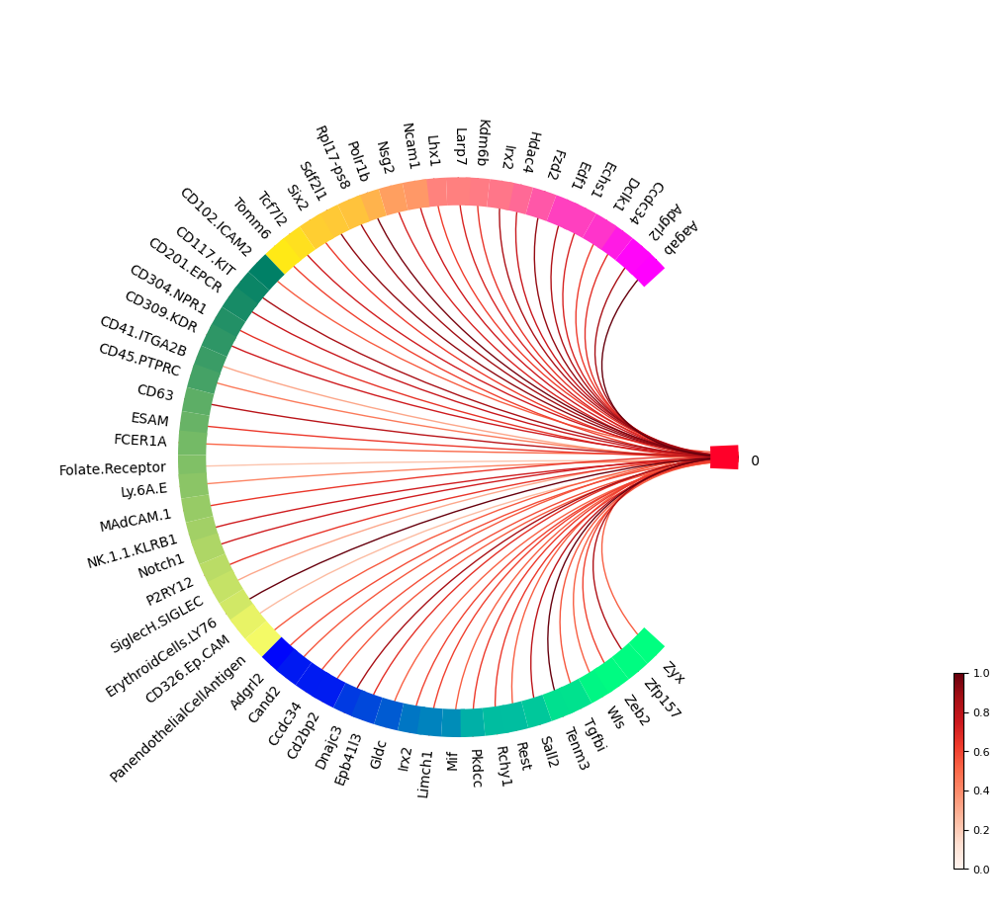

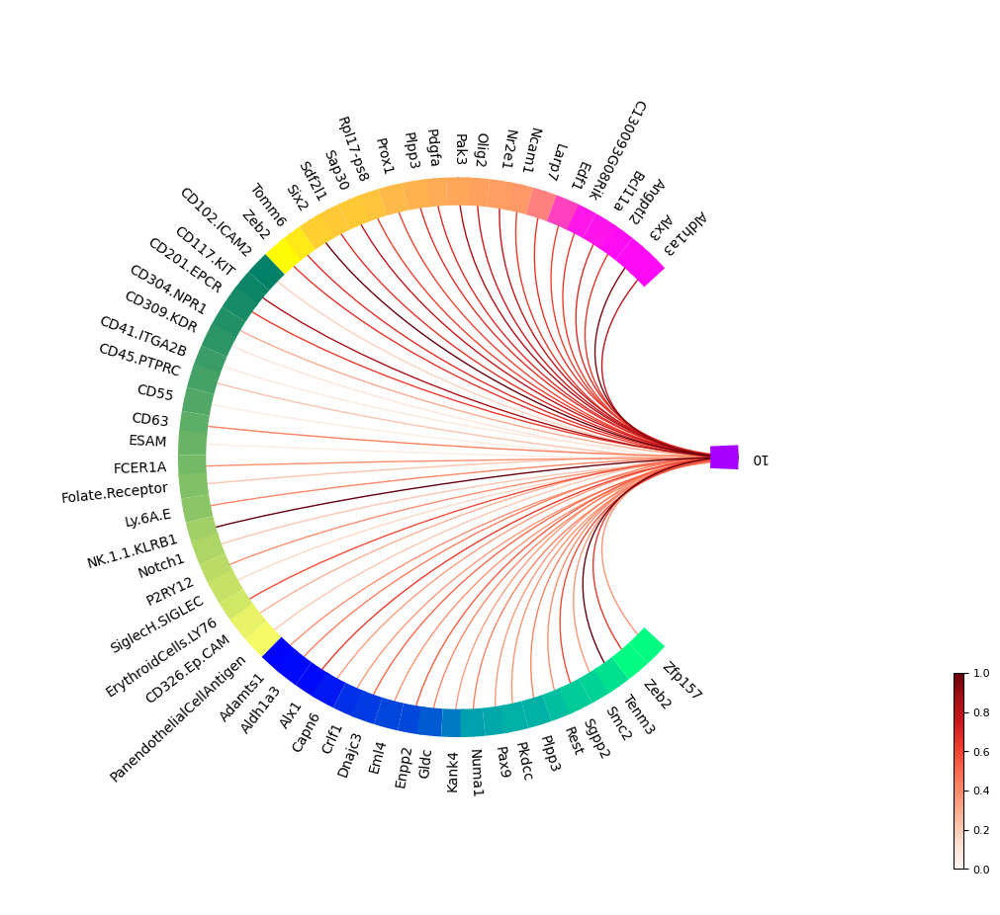

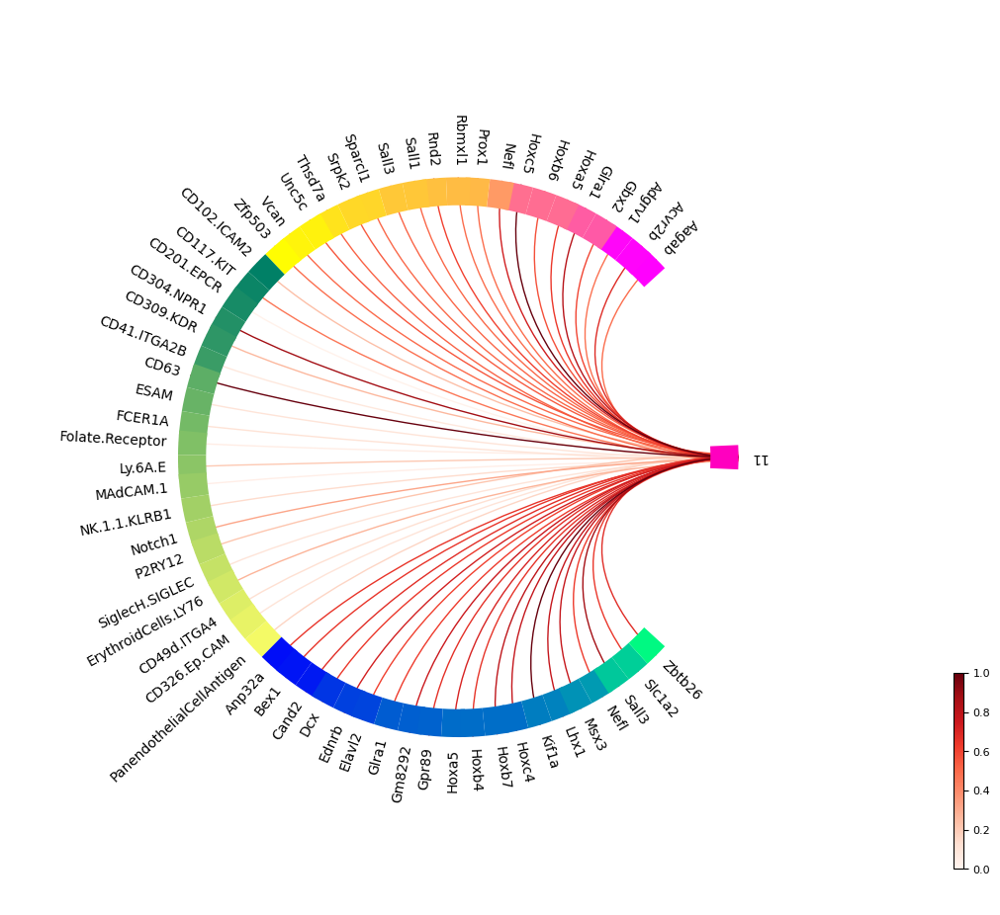

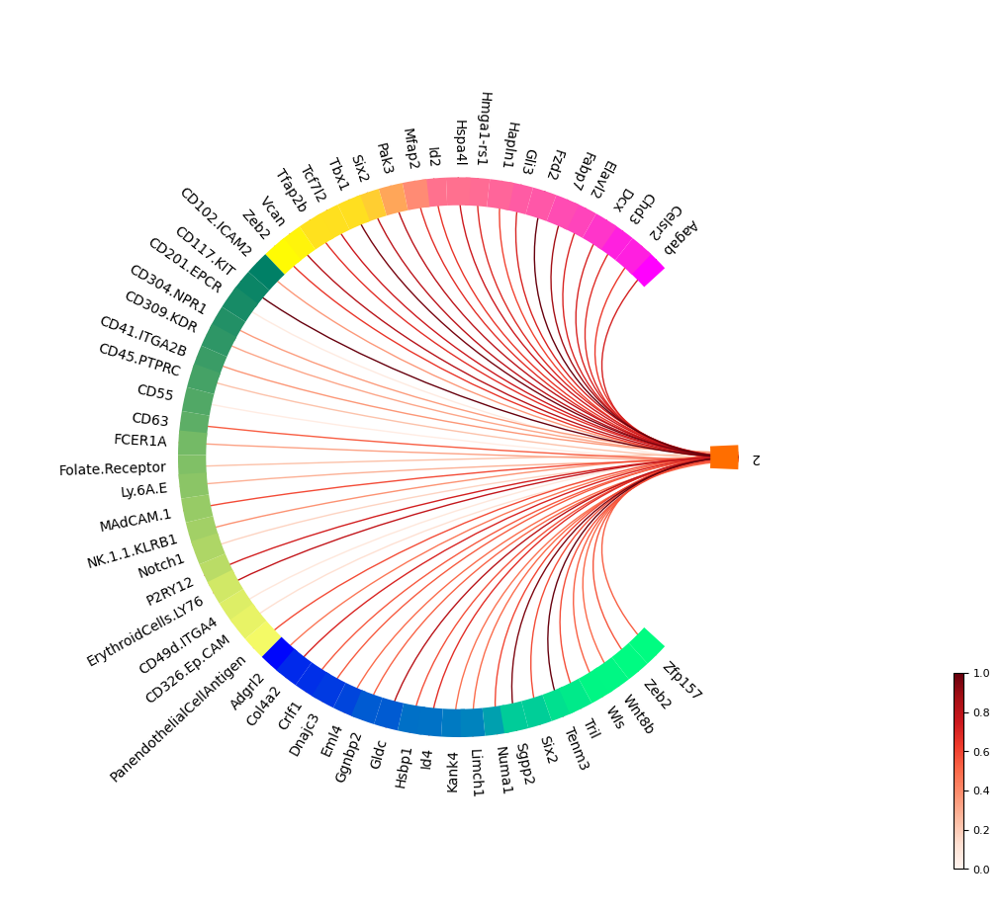

...

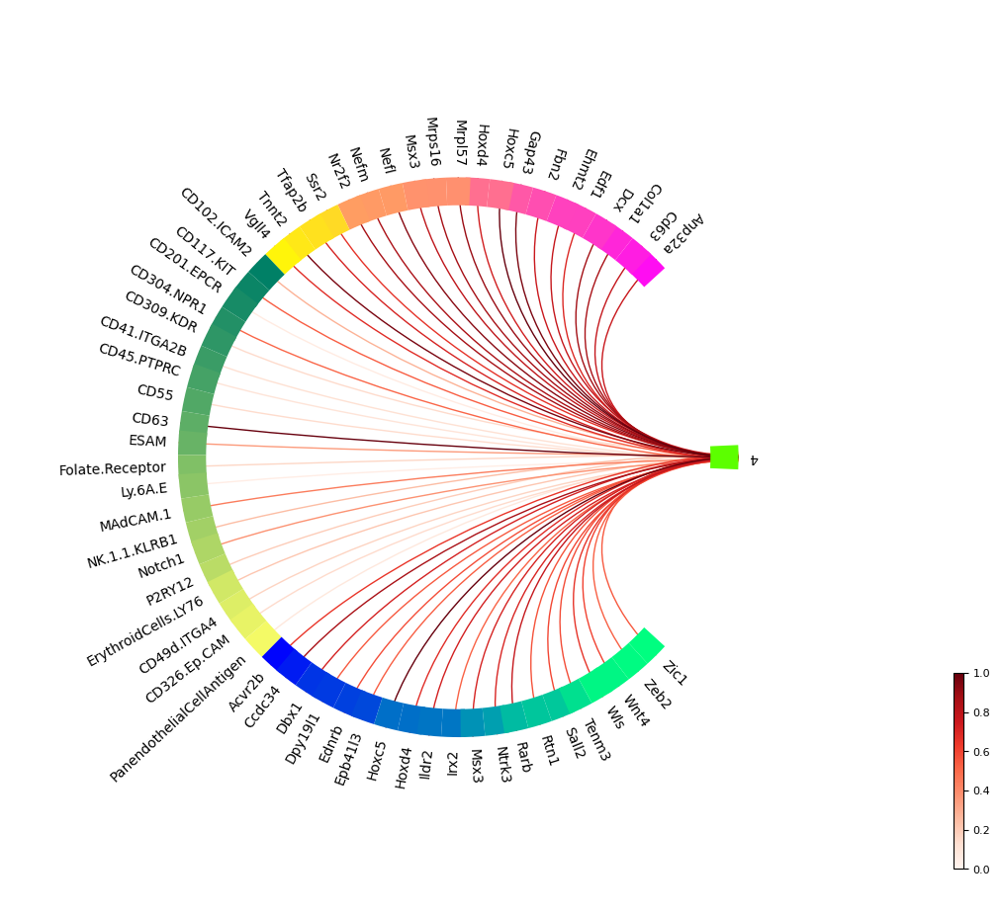

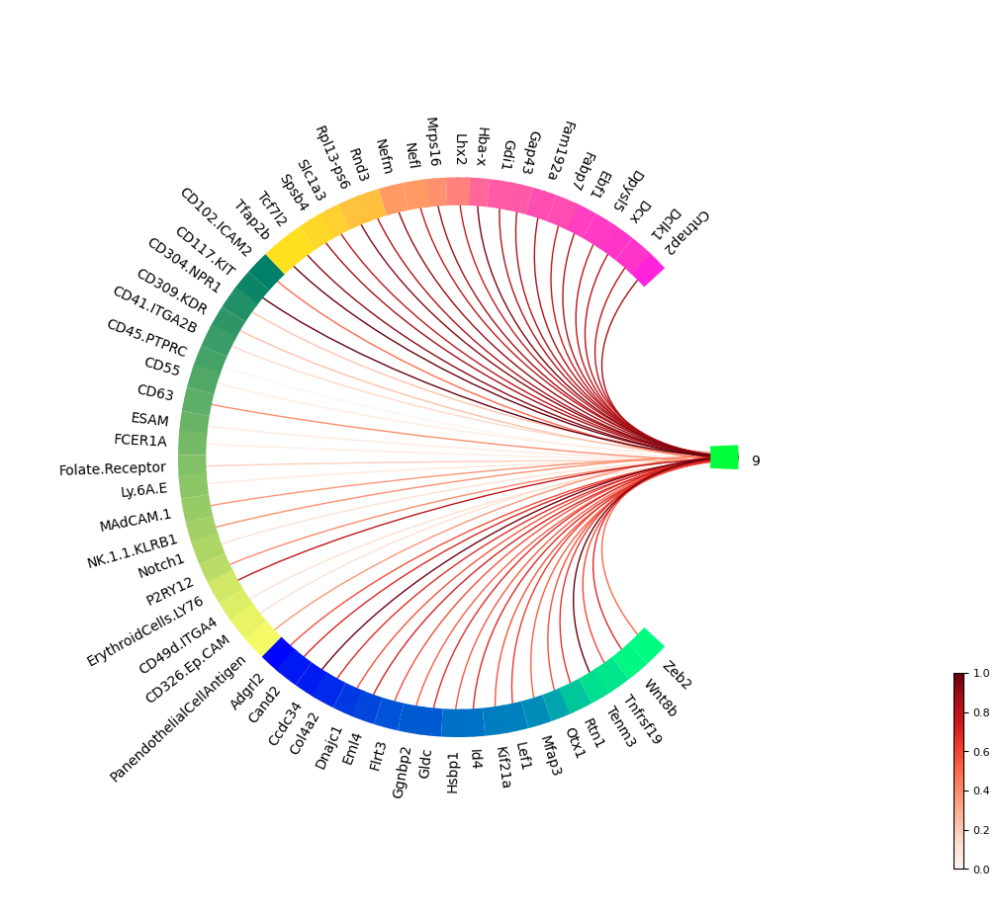

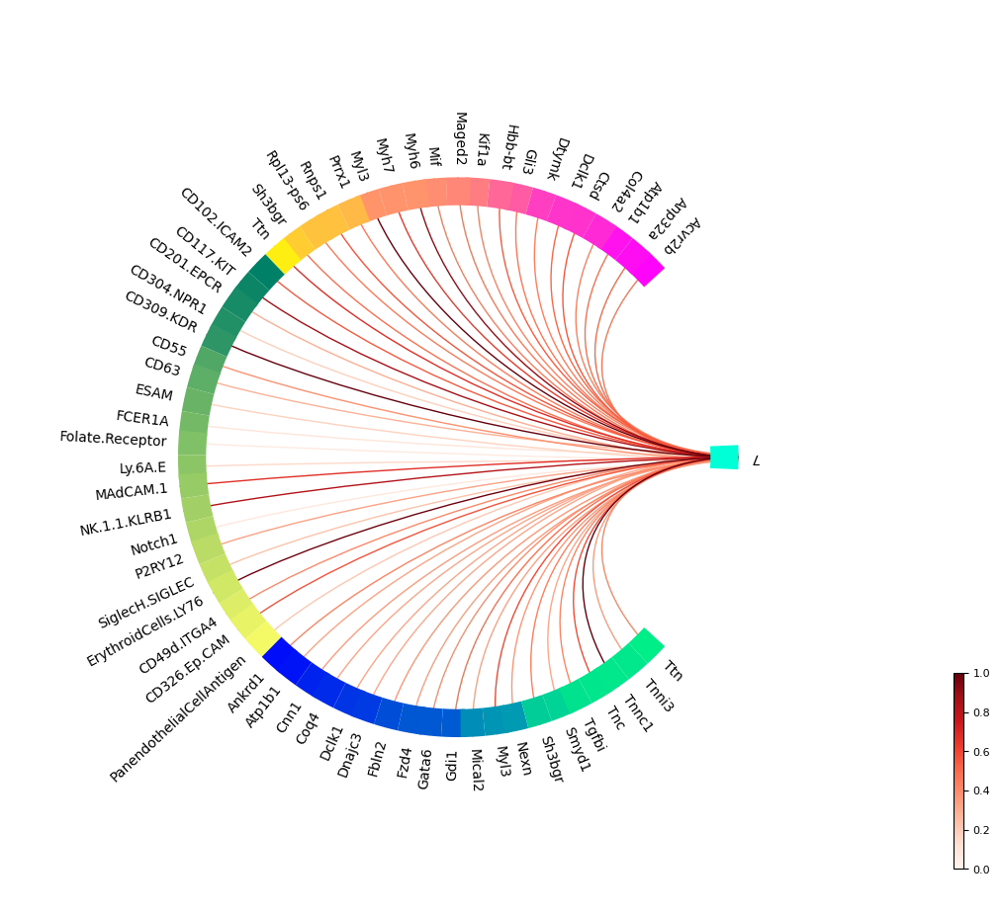

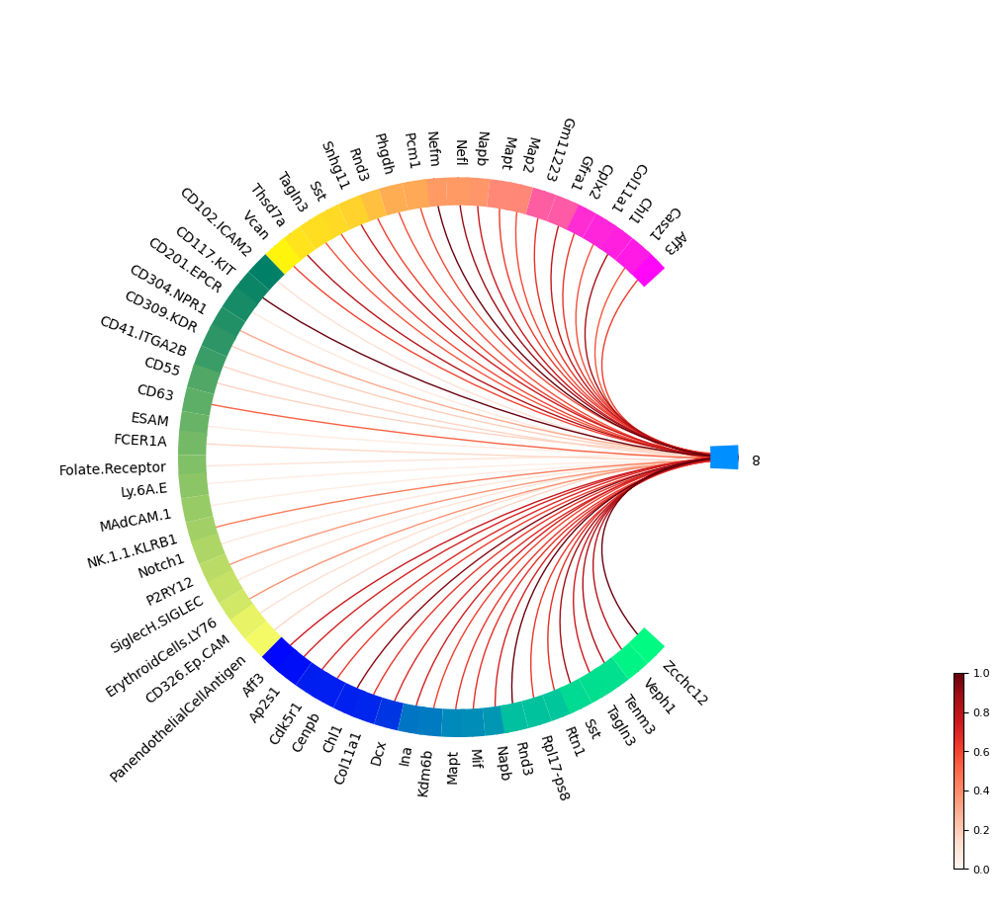

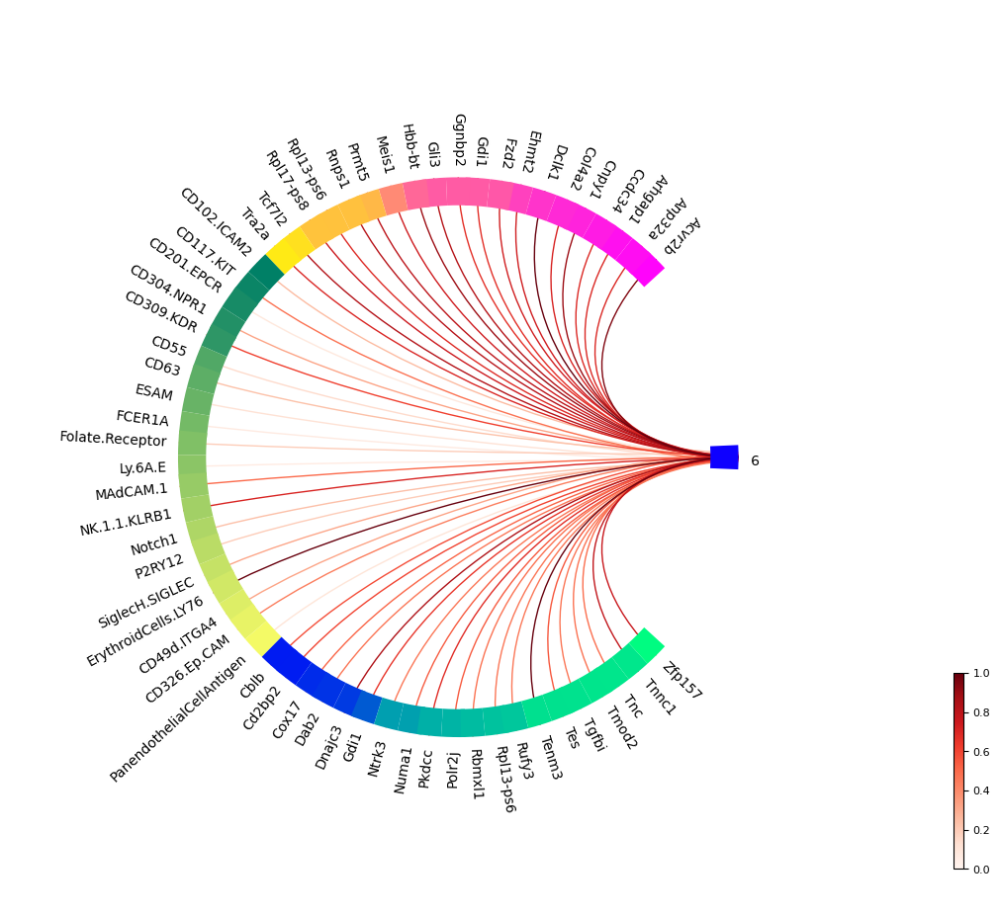

In [61]:
# SHAP values for joint feature-to-group relevance

# Define the modality names
modality_names = ["RNA", "PROTEINS", "NICHE"]

# Extract spatial domain names
cluster_prototype_features = [
    type_specific_mean(ad_x, "label").to(device=model.device) for ad_x in adatas_all
]

# Define modalities
test_type = [
    torch.tensor(adatas_all[0].X, device=model.device),
    torch.tensor(adatas_all[1].X, device=model.device),
    torch.tensor(adatas_all[2].X, device=model.device),
]

# Define the predict_label based on the previous NearestNeighbor results
predict_label = np.array(united_clus_new)
adata_fused = model.infer(adatas_all)
adata_fused.obs["predicted_label"] = pd.Categorical(united_clus_new)
predict_label_anno = adata_fused.obs["predicted_label"]
adata_fused.obs["label"] = list(adatas_all[0].obs["label"])

# Path to save SHAP values results
root_save_path_relev = f"{root_save_path}/type_relevance"

# Load pre-calculated SHAP values for the workshop
calculate_shap = True  # False = SHAP values already calculated and saved in saved_results folder

if calculate_shap:
    sub = submodel_clus(model.model).to(model.device)
    background = cluster_prototype_features
    e = shap.DeepExplainer(sub, background)
    shap_values = e.shap_values(test_type, check_additivity=True)
    with open(f"{root_save_path}/shap_values.pkl", "wb") as f:
        pickle.dump(shap_values, f)
else:
    with open(f"{root_save_path}/shap_values.pkl", "rb") as f:
        shap_values = pickle.load(f)


# Define clusters
major_dict = {
    cluster_id: f"Cluster {cluster_id}" for cluster_id in unique_predicted_clusters
}

# Plotting begins..
adatas_all_new, p_fe, p_fe_idx, p_l_less, pr_ty_dict = markers_chord_plot(
    adatas_all, predict_label, predict_label_anno, major_dict, subset_feature=False
)

all_less_type = np.unique(p_l_less)
if "predicted_label_colors" not in adata_fused.uns.keys():
    sc.pl.umap(
        adata_fused,
        color=["predicted_label"],
        palette="gist_rainbow",
        show=False,
        title="",
    )
    
colors_type = dict(
    zip(
        adata_fused.obs["predicted_label"].cat.categories,
        adata_fused.uns["predicted_label_colors"],
    )
)

top_k_important = 20
all_type_features, scores, aggregated_shap = type_relevance_chord_plot(
    shap_values,
    p_fe,
    p_fe_idx,
    p_l_less,
    predict_label,
    colors_type,
    all_less_type,
    f"{technique}",
    pr_ty_dict,
    thres=top_k_important,
    only_show_good=True,
    linewidth=1,
    linecolormap="Reds",
    node_width=5,
    make_plot=True,
    fontsize_names=10,
    potential_coloarmaps=["spring", "summer", "winter", "autumn"],
)

In [62]:
# all_type_features -> for every cluster, and for every modality, the names of the 20 most important features (names) 
# scores -> for every cluster, and for every modality, the scores of the 20 most important features
# aggregated_shap -> for every cluster, the shap values of the 60 most important features (20 per modality)

# Loop through each cluster

id2modality = {0: 'RNA', 1: 'Protein', 2: 'Niche'}
rows = []
for cluster_id, modalities in all_type_features.items():
    for modality_id, features in modalities.items():
        scores_for_modality = scores[cluster_id][modality_id]
        
        for i, feature in enumerate(features):
            shap_value_index = modality_id * 20 + i
            shap_value = aggregated_shap[cluster_id][shap_value_index]
            rows.append({
                'Cluster': cluster_id,
                'Modality': id2modality[modality_id],
                'Feature': feature,
                'Score': scores_for_modality[i],
                'SHAP Value': shap_value
            })

# Create the DataFrame
df = pd.DataFrame(rows)
print(df)
df.to_csv(f'{saved_results}/type_feature_importance.csv', index=False)

     Cluster Modality Feature     Score  SHAP Value
0          0      RNA   Aagab  1.000000    0.081011
1          0      RNA  Adgrl2  0.862485    0.054165
2          0      RNA  Ccdc34  0.664980    0.015608
3          0      RNA   Dclk1  0.626069    0.008012
4          0      RNA   Echs1  0.708945    0.024191
..       ...      ...     ...       ...         ...
595        9    Niche   Tgfbi  0.460981    0.000203
596        9    Niche   Tmod2  0.474925    0.001692
597        9    Niche     Tnc  0.486373    0.002915
598        9    Niche   Tnnc1  0.782623    0.034555
599        9    Niche  Zfp157  0.761104    0.032257

[600 rows x 5 columns]


In [63]:
# change names of niche features to not be confused with the naming of the genes
import copy
new_all_type_features = {}
for cluster_id, cluster_features in all_type_features.items():
    new_all_type_features[cluster_id] = copy.deepcopy(cluster_features)
    gene_modality_names = np.array([feature_name + "- G" for feature_name in cluster_features[0]])
    protein_modality_names = np.array([feature_name + "- P" for feature_name in cluster_features[1]])
    niche_modality_names = np.array([feature_name + "- N" for feature_name in cluster_features[2]])
    new_all_type_features[cluster_id] = {0: gene_modality_names, 1: protein_modality_names, 2: niche_modality_names}    
    

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


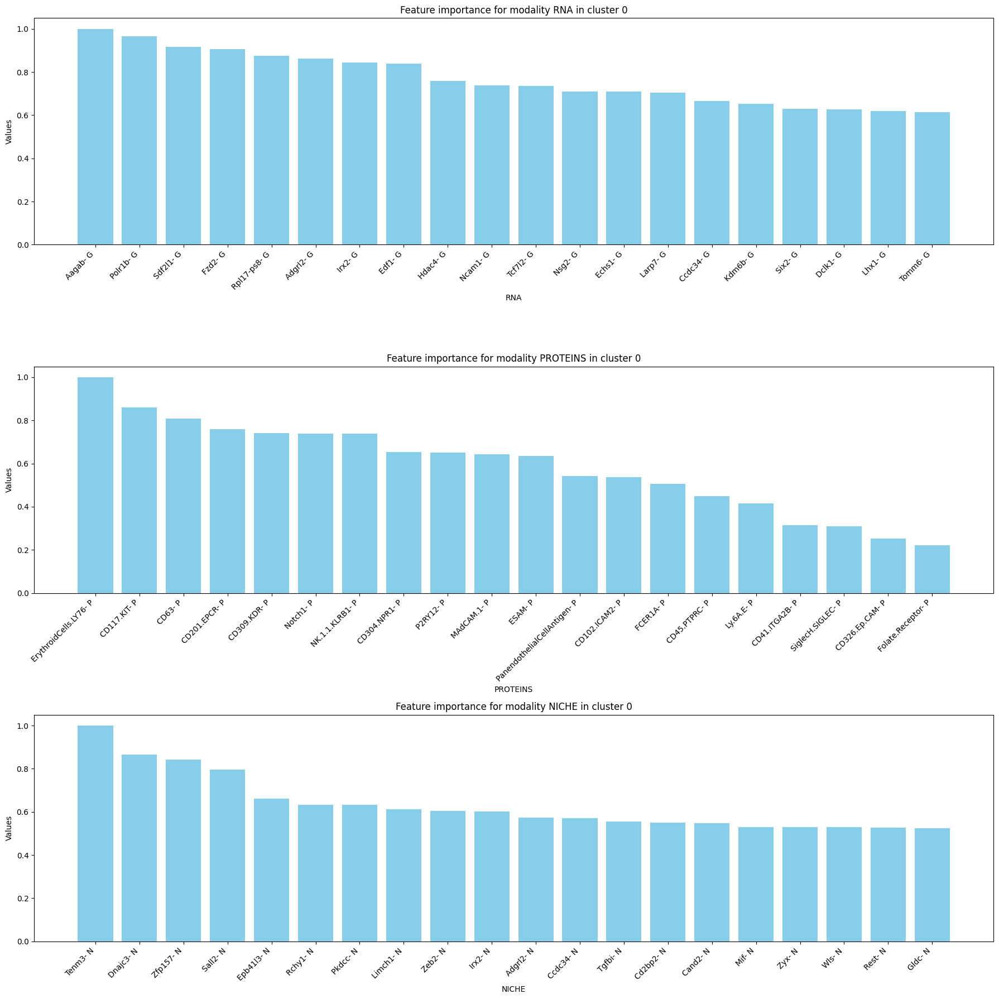

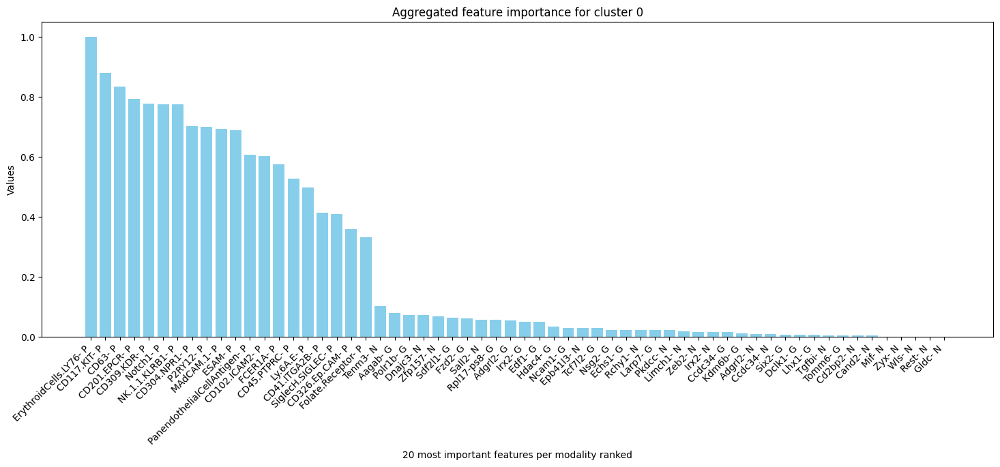

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


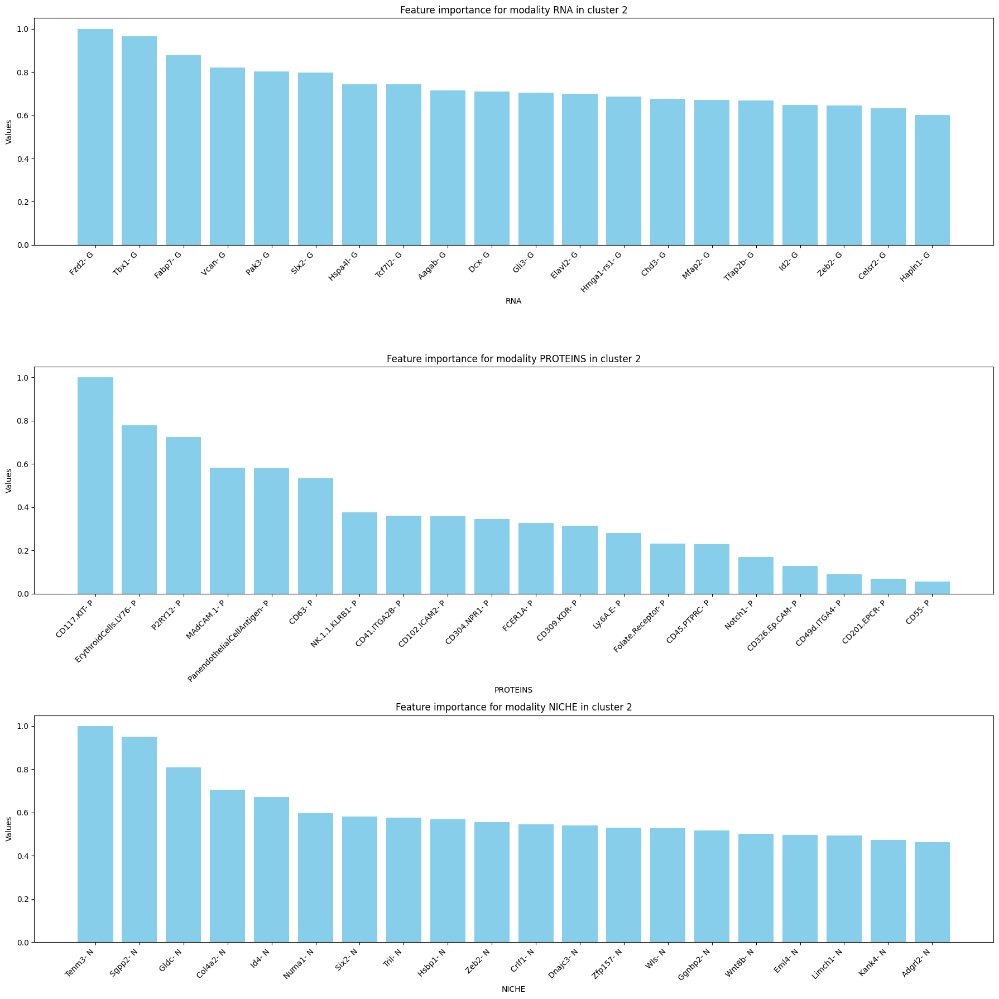

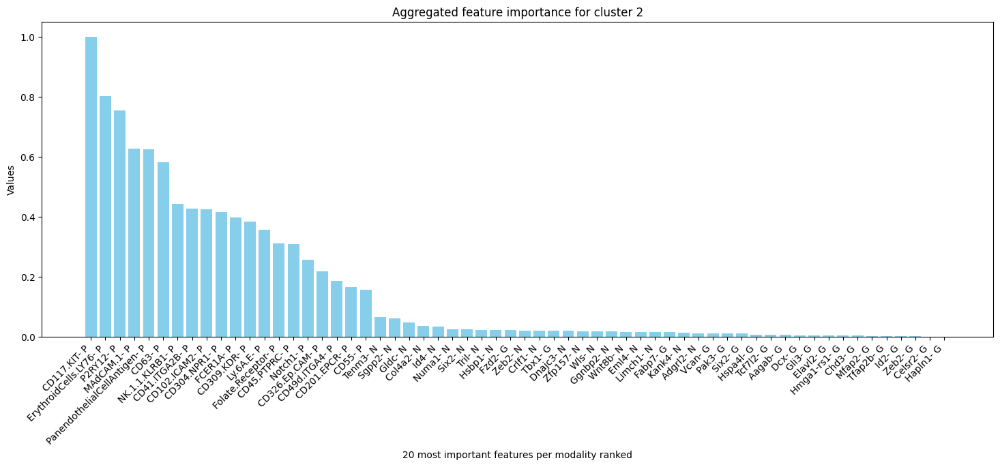

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


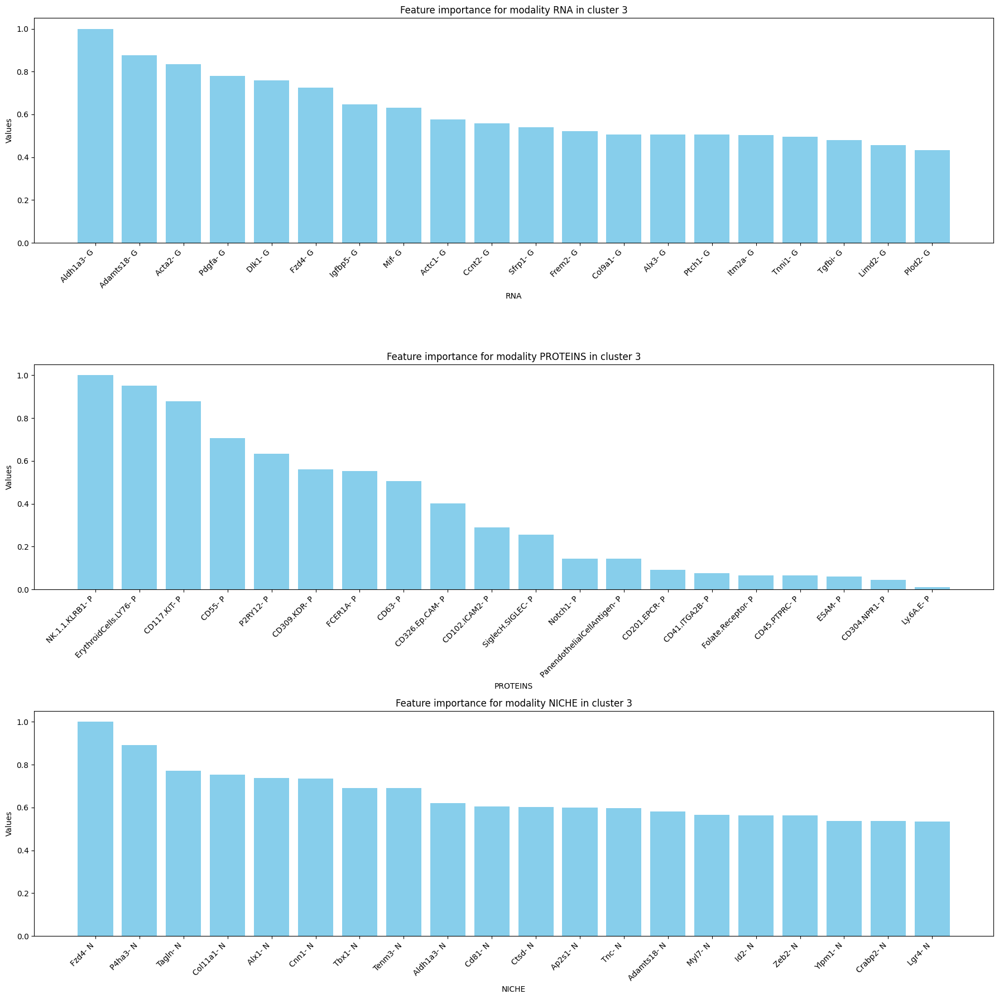

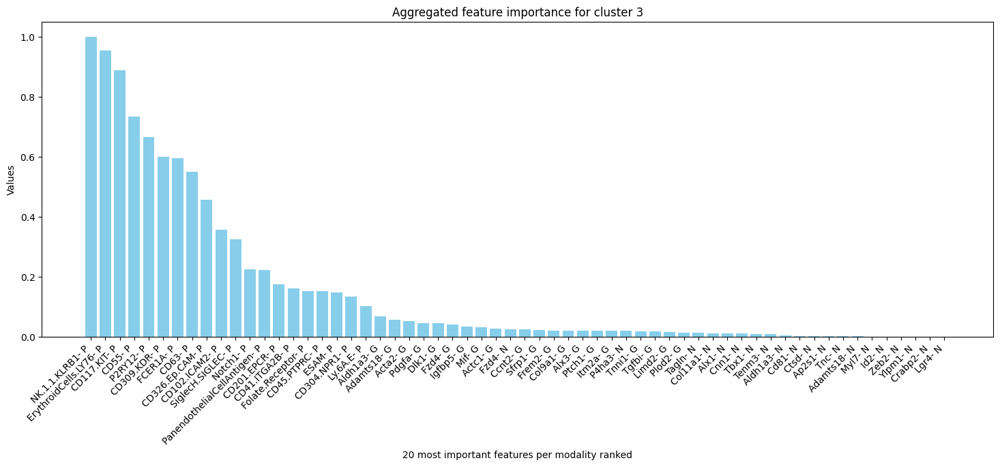

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


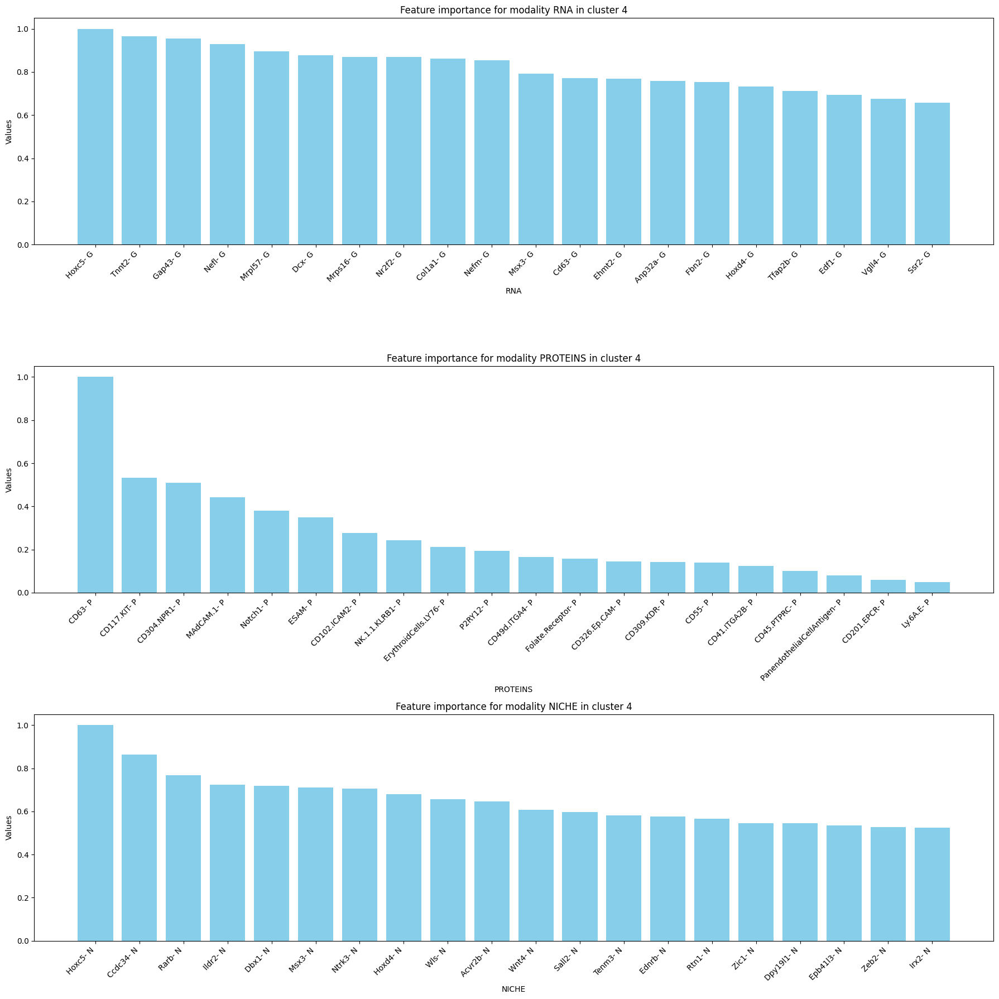

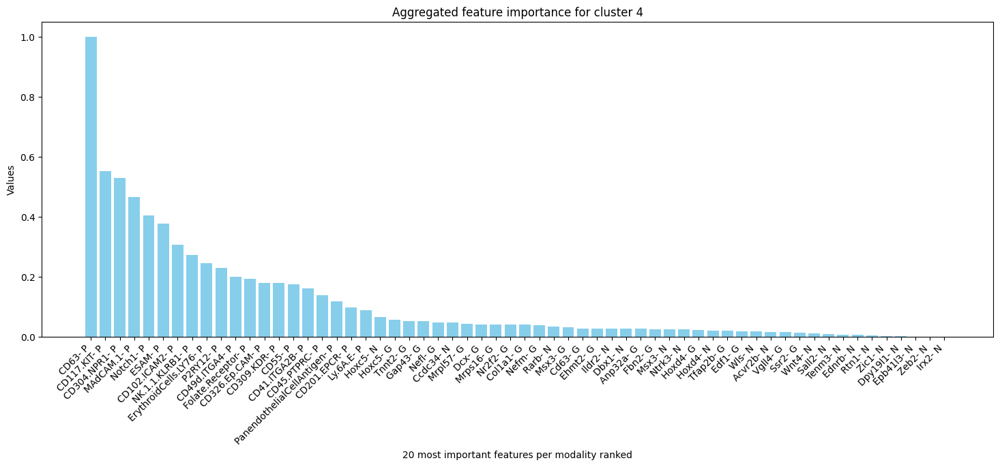

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


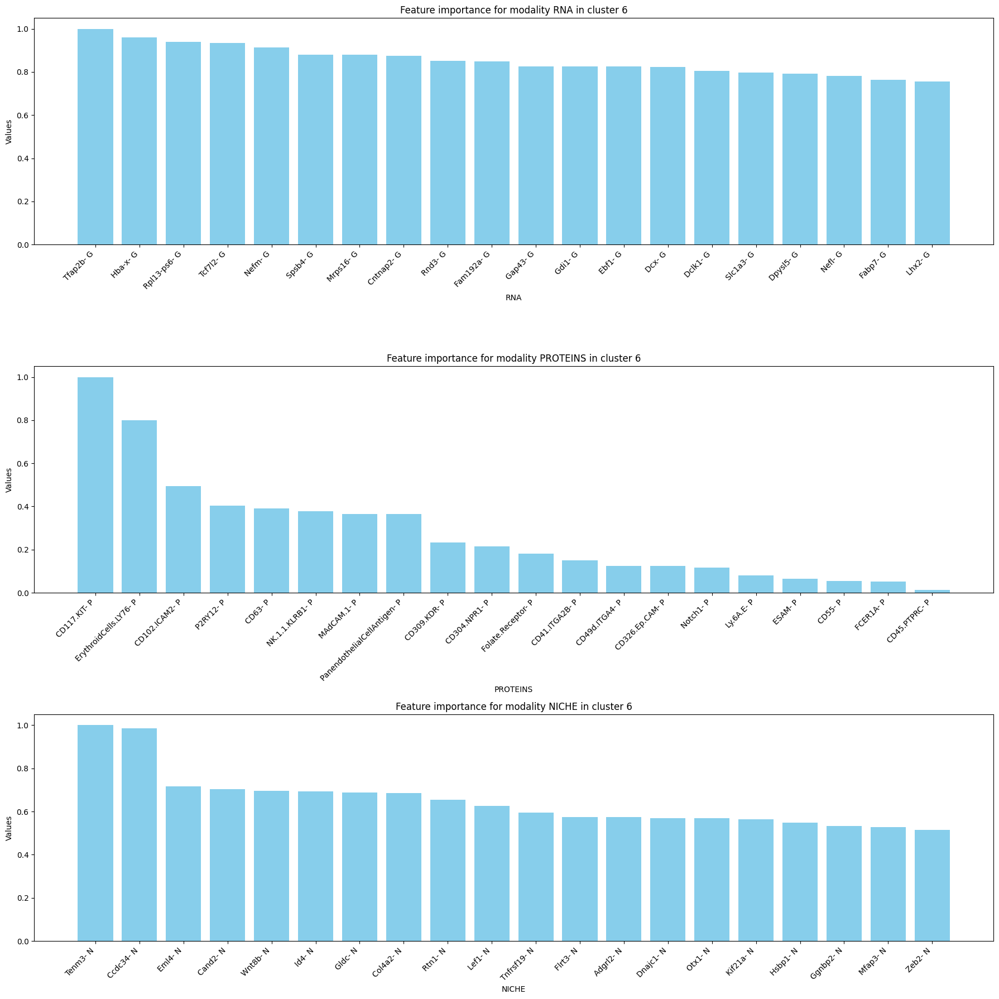

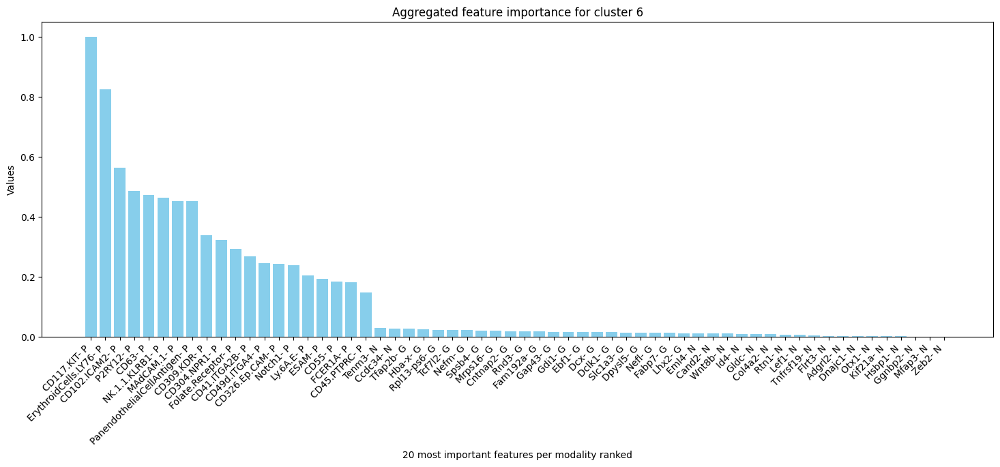

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


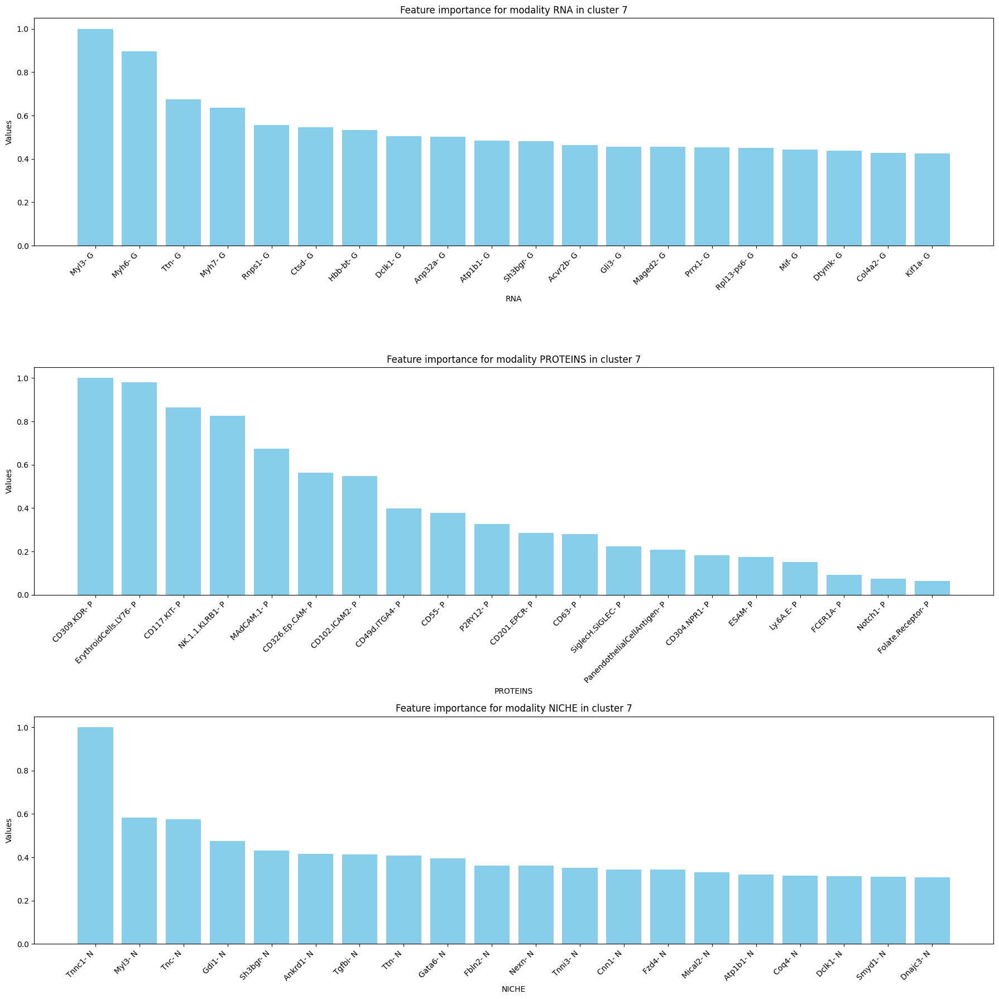

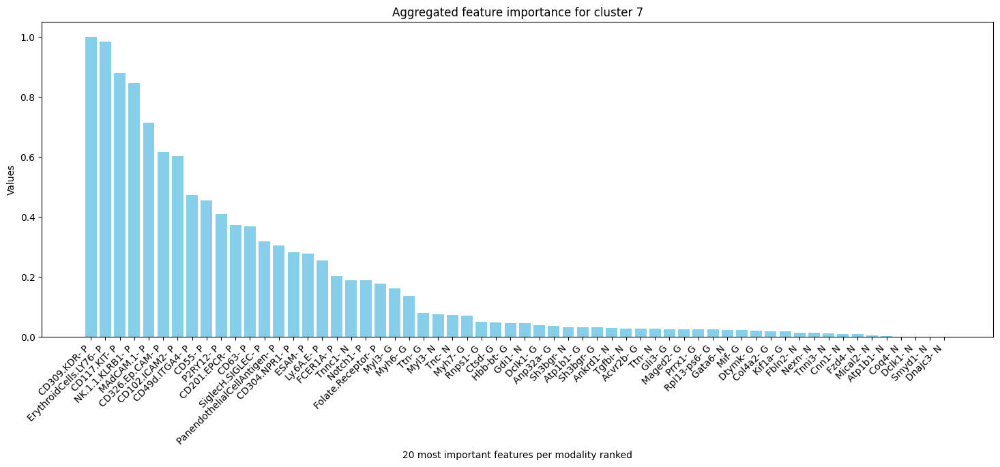

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


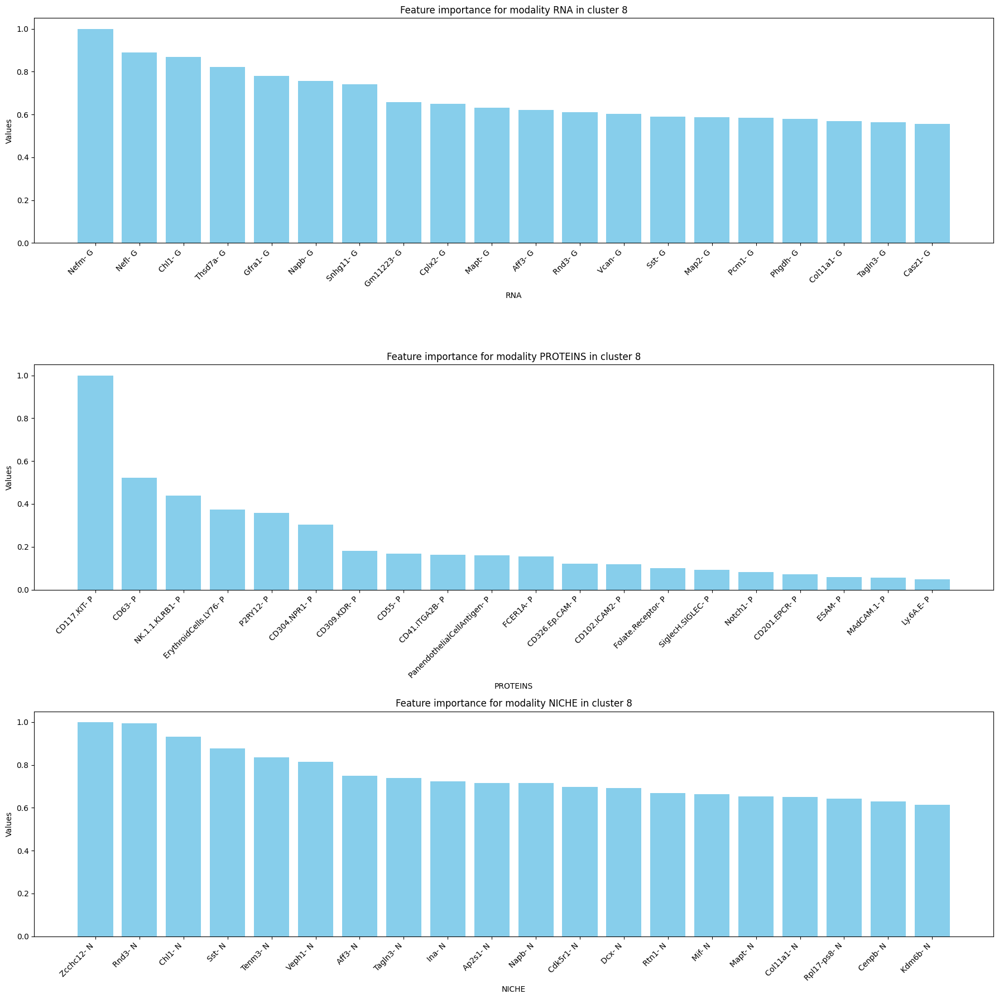

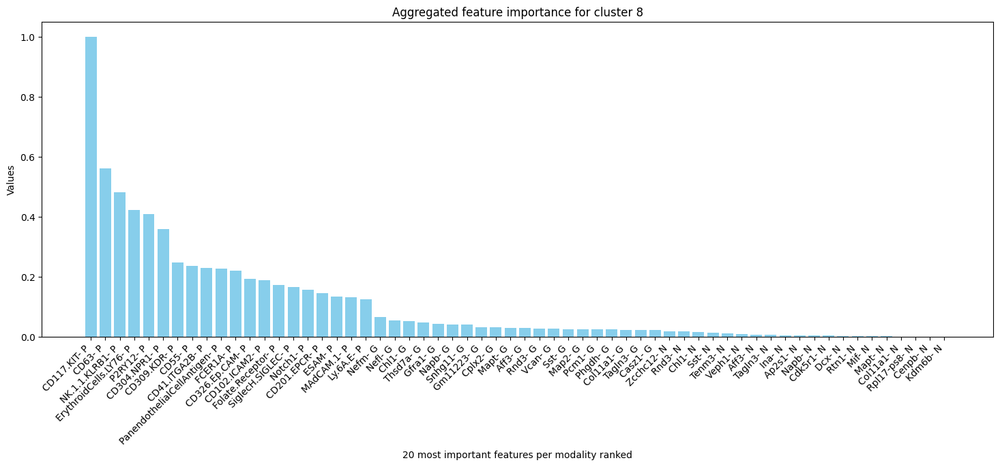

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


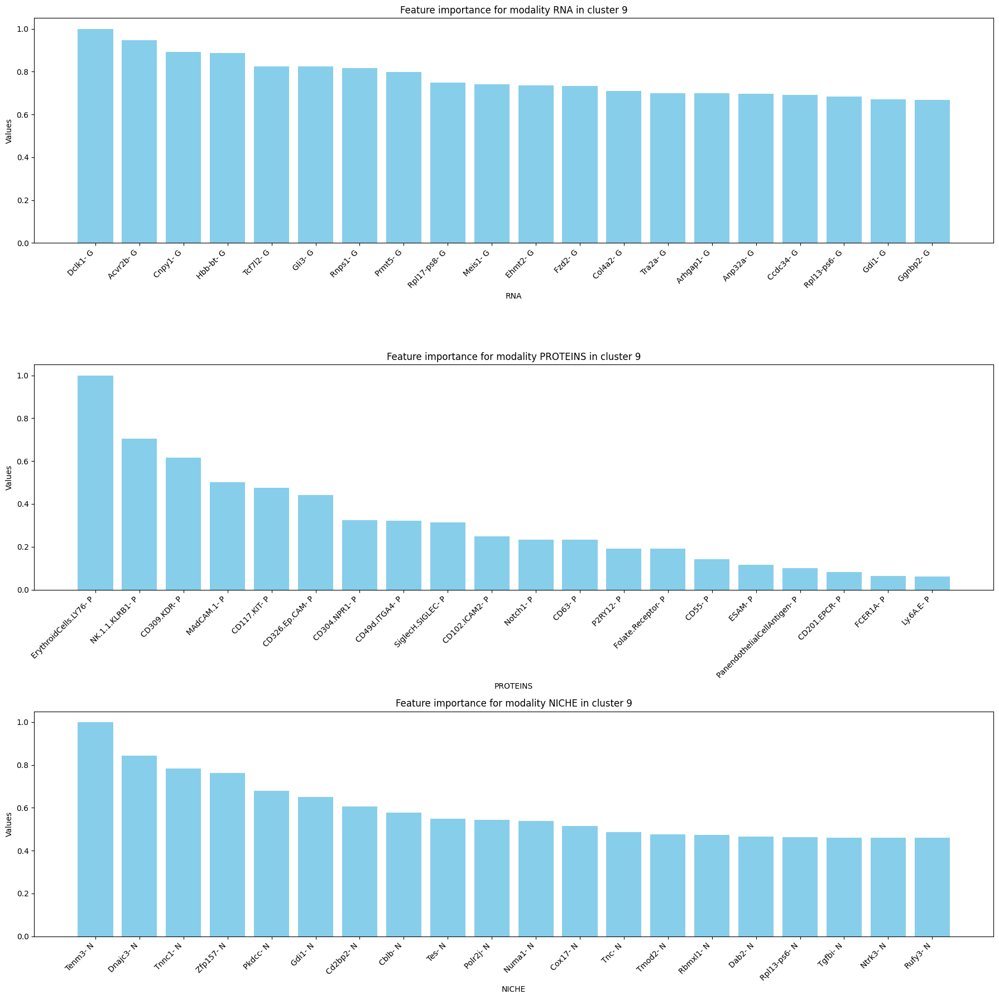

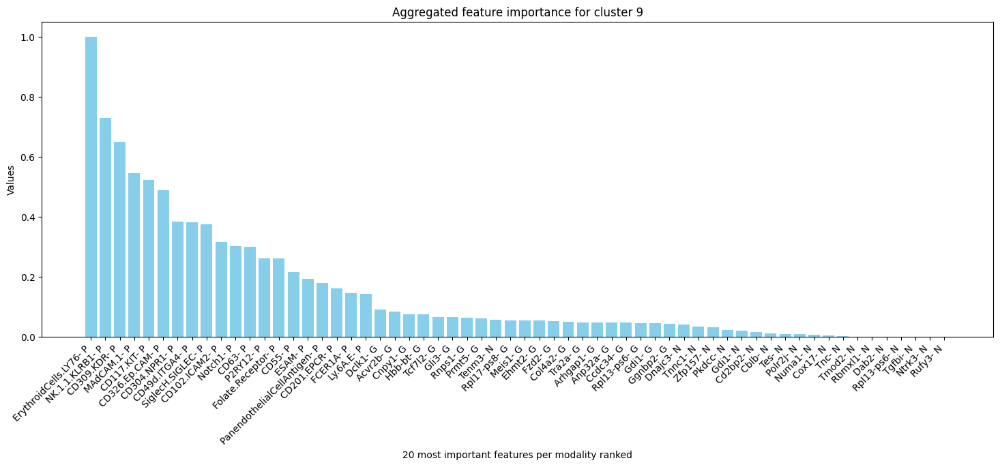

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


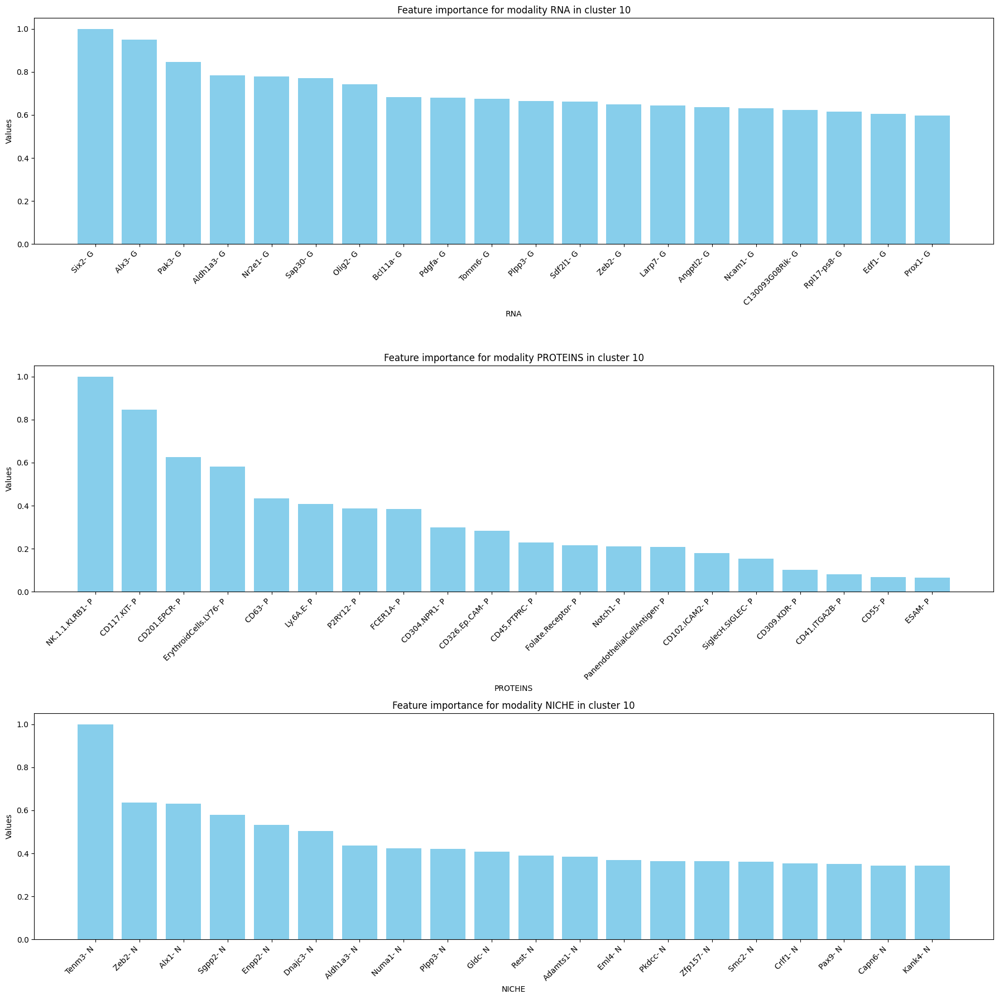

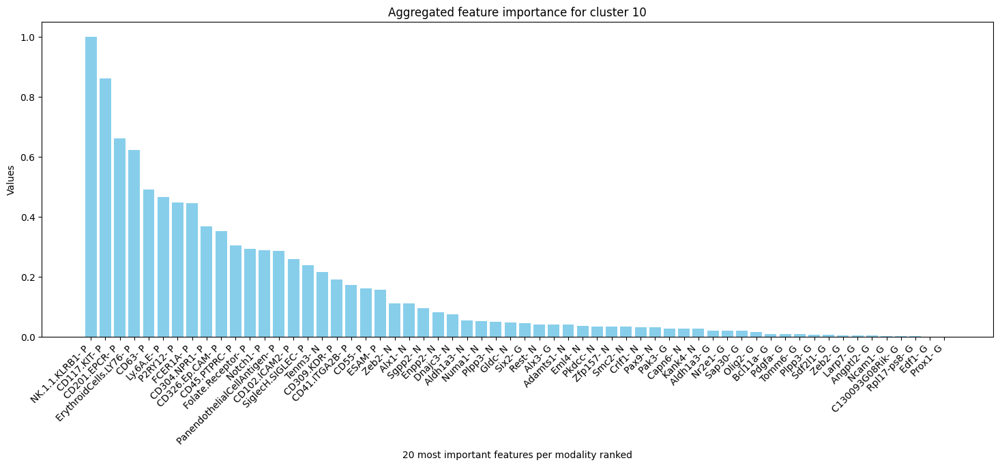

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


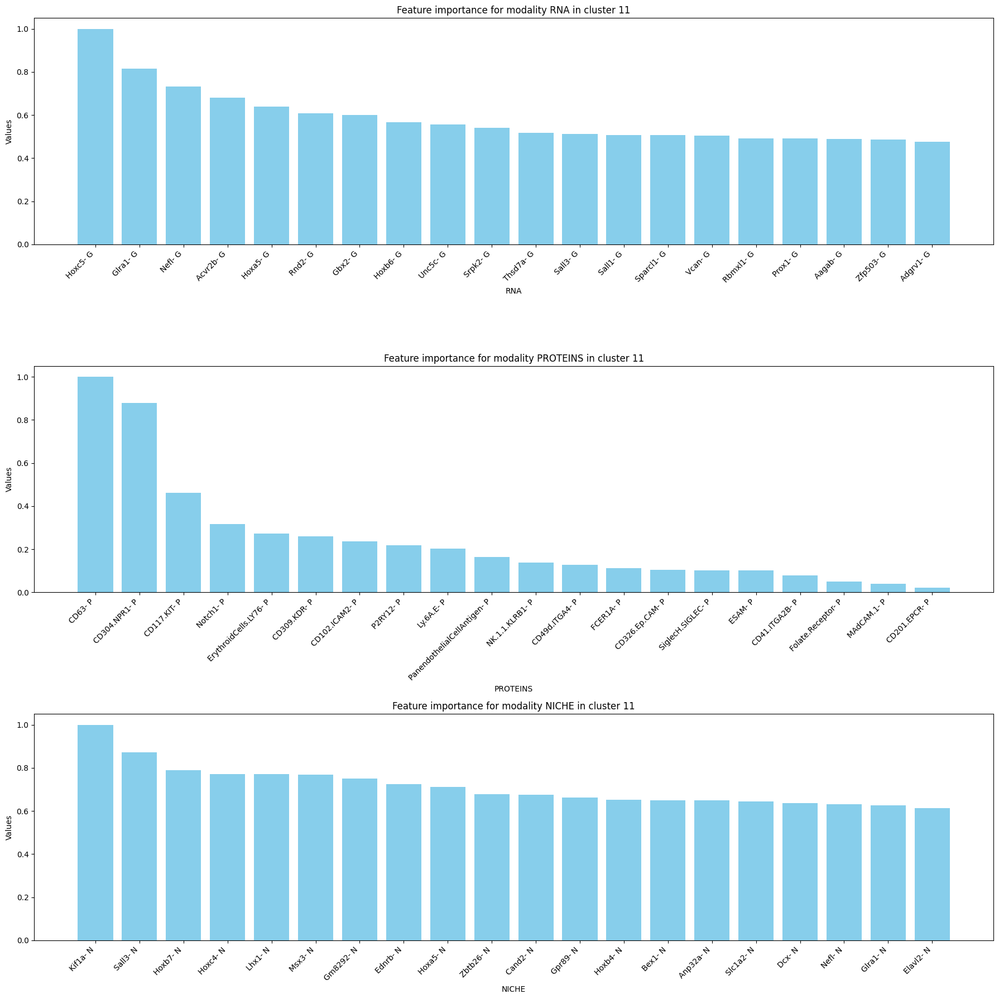

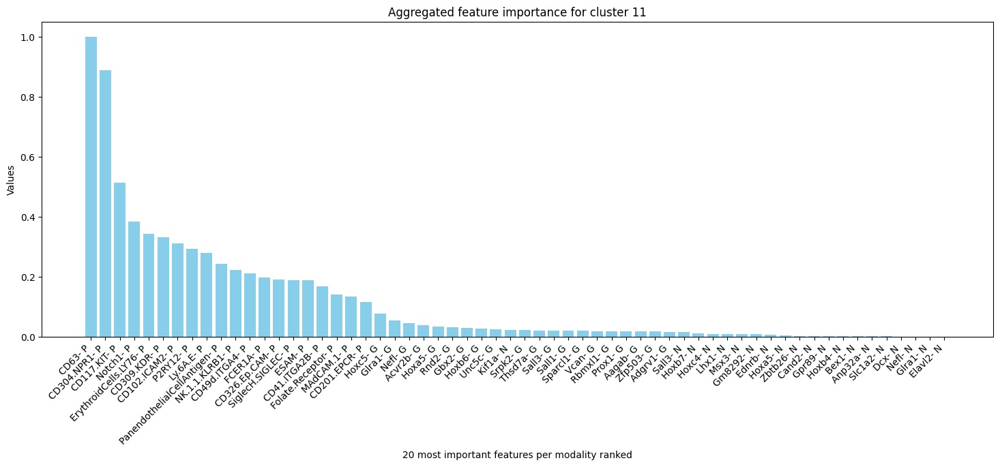

In [64]:
# 20 most important features for a specific cluster and a specific modality
def plot_feature_importance(cluster_id):
    scores_for_all_modalities_per_cluster = scores[cluster_id]
    features_for_all_modalities_per_cluster = new_all_type_features[cluster_id]
    
    def per_modality(ax, modality_id):
        scores_per_modality = scores_for_all_modalities_per_cluster[modality_id]
        features_per_modality = features_for_all_modalities_per_cluster[modality_id]
        sorted_indices = np.argsort(scores_per_modality)[::-1]

        ax.bar(features_per_modality[sorted_indices], scores_per_modality[sorted_indices], color='skyblue')
        ax.set_xticklabels(features_per_modality[sorted_indices], rotation=45, ha='right')
        ax.set_xlabel(modality_names[modality_id])
        ax.set_ylabel('Values')
        ax.set_title(f"Feature importance for modality {modality_names[modality_id]} in cluster {cluster_id}")
    
    # Create a figure with 3 subplots (one for each modality)
    fig, axes = plt.subplots(3, 1, figsize=(18, 18))
    
    per_modality(axes[0], 0)
    per_modality(axes[1], 1)
    per_modality(axes[2], 2)
    
    plt.tight_layout()  # Adjust layout to prevent overlapping
    
    all_features_for_all_modalities_per_cluster = np.concatenate(
        list(features_for_all_modalities_per_cluster.values())
    )
    aggregated_shap_per_cluster = aggregated_shap[cluster_id]
    sorted_indices = np.argsort(aggregated_shap_per_cluster)[::-1]

    plt.figure(figsize=(18, 6))
    ax = plt.gca()
    plt.bar(all_features_for_all_modalities_per_cluster[sorted_indices], aggregated_shap_per_cluster[sorted_indices], color='skyblue')
    ax.set_xticklabels(all_features_for_all_modalities_per_cluster[sorted_indices], rotation=45, ha='right')
    plt.xlabel('20 most important features per modality ranked')
    plt.ylabel('Values')
    plt.title(f"Aggregated feature importance for cluster {cluster_id}")
    plt.show()
    
for cluster_id, _ in major_dict.items():
    plot_feature_importance(cluster_id)

In [65]:
# spatial type specific feature-to-feature relevance

calculate_shap = True # True to calculate shap values, False to load them

rna_index = 0
protein_index = 1
niche_index = 2

cluster_prototype_features = [torch.tensor(type_specific_mean(ad_x,'label'),device=model.device) for ad_x in adatas_all]
source_modality = rna_index
target_modality = protein_index


def shap_translation(source_modality, target_modality):
    if calculate_shap:
        sub = submodel_trans(model.model, [source_modality, target_modality]).to(model.device)
        background = cluster_prototype_features[source_modality]
        e = shap.DeepExplainer(sub, background)
        test_type = torch.tensor(adatas_all[source_modality].X,device=model.device)
        shap_values = e.shap_values(test_type,check_additivity=True)
        with open(f'{root_save_path}/shap_values_{source_modality}_{target_modality}.pkl', 'wb') as f:
            pickle.dump(shap_values, f)
    else:
        with open(f'{root_save_path}/shap_values_{source_modality}_{target_modality}.pkl', 'rb') as f:
            shap_values = pickle.load(f)
    return shap_values

shap_genes_to_protein = shap_translation(rna_index, protein_index)
shap_genes_to_niche = shap_translation(rna_index, niche_index)
shap_protein_to_niche = shap_translation(protein_index, niche_index)

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


In [66]:
var_names_all = [ad.var_names.values for ad in adatas_all]

shap_values = {
    "0_1": shap_genes_to_protein,
    "0_2": shap_genes_to_niche,
    "1_2": shap_protein_to_niche,
}


def feature_feature_relevance(source_id: int, target_id: int, make_plot=False):
    var_names = [var_names_all[source_id], var_names_all[target_id]]
    return feature_relevance_chord_plot(
        shap_values[f"{source_id}_{target_id}"],
        unique_predicted_clusters,
        var_names,
        all_type_features,
        f"{technique}_average",
        direction=f"{source_id}to{target_id}",
        in_mod=0,
        thres=None,
        make_plot=make_plot,
        potential_coloarmaps=["spring", "summer", "winter", "autumn"],
    )

({0: array([[0.44473469, 0.40659224, 0.59927921, 0.48371893, 0.51564059,
          0.52629186, 0.59409493, 0.451952  , 0.42572013, 0.54650642,
          0.49853696, 0.47663693, 0.58376116, 0.55015577, 0.4760526 ,
          0.45669713, 0.51585967, 0.50015383, 0.50682549, 0.44181143],
         [0.55271386, 0.58987152, 0.71460797, 0.69637228, 0.7164551 ,
          0.60548115, 0.73005014, 0.82743631, 0.67164017, 0.72691658,
          0.71868998, 0.70016689, 0.75245006, 0.81108906, 0.86591041,
          0.72938537, 0.76707541, 0.79360219, 0.67188208, 0.63471555],
         [0.46715023, 0.49965033, 0.44231121, 0.56063507, 0.62292688,
          0.49438026, 0.61855011, 0.64731003, 0.57050865, 0.62842135,
          0.66061589, 0.60036032, 0.57004237, 0.62393337, 0.7165645 ,
          0.44687035, 0.61169552, 0.58657966, 0.56125698, 0.53392728],
         [0.25053737, 0.30261318, 0.21631925, 0.29477598, 0.30092768,
          0.32185974, 0.25070889, 0.20694939, 0.21312791, 0.29602508,
          0.31

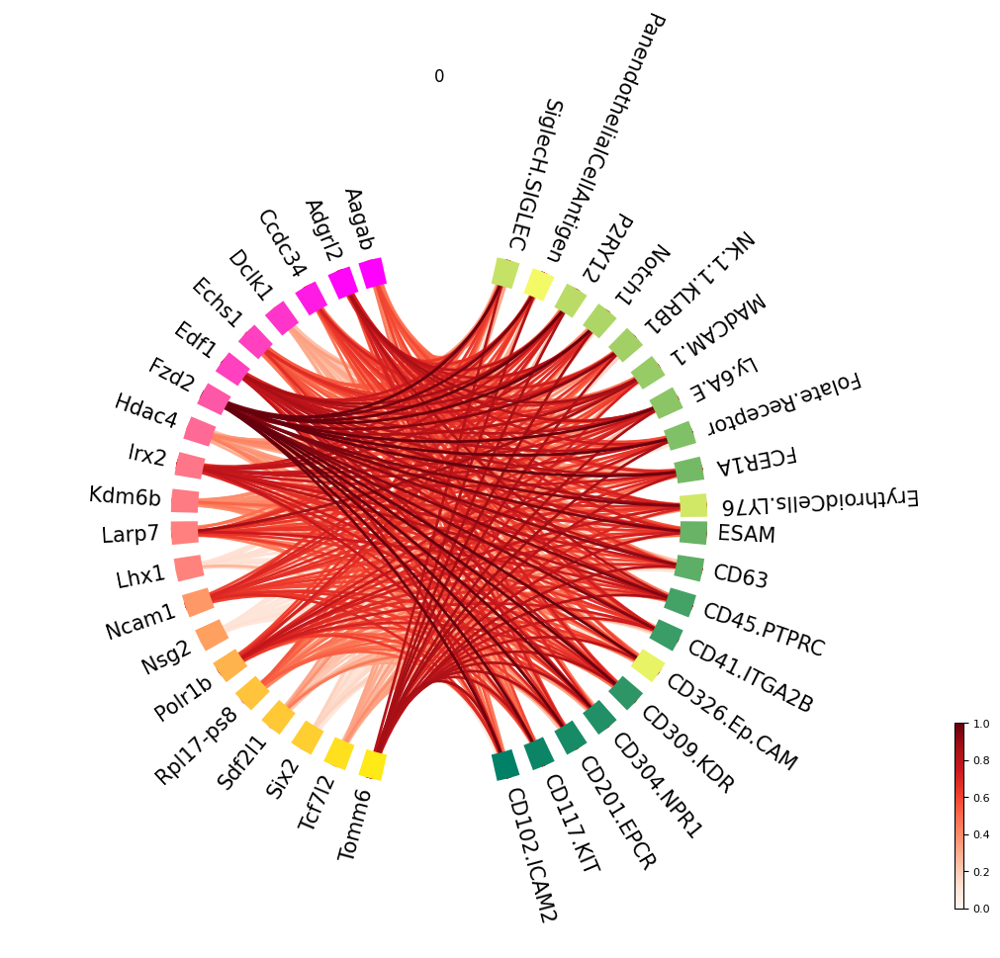

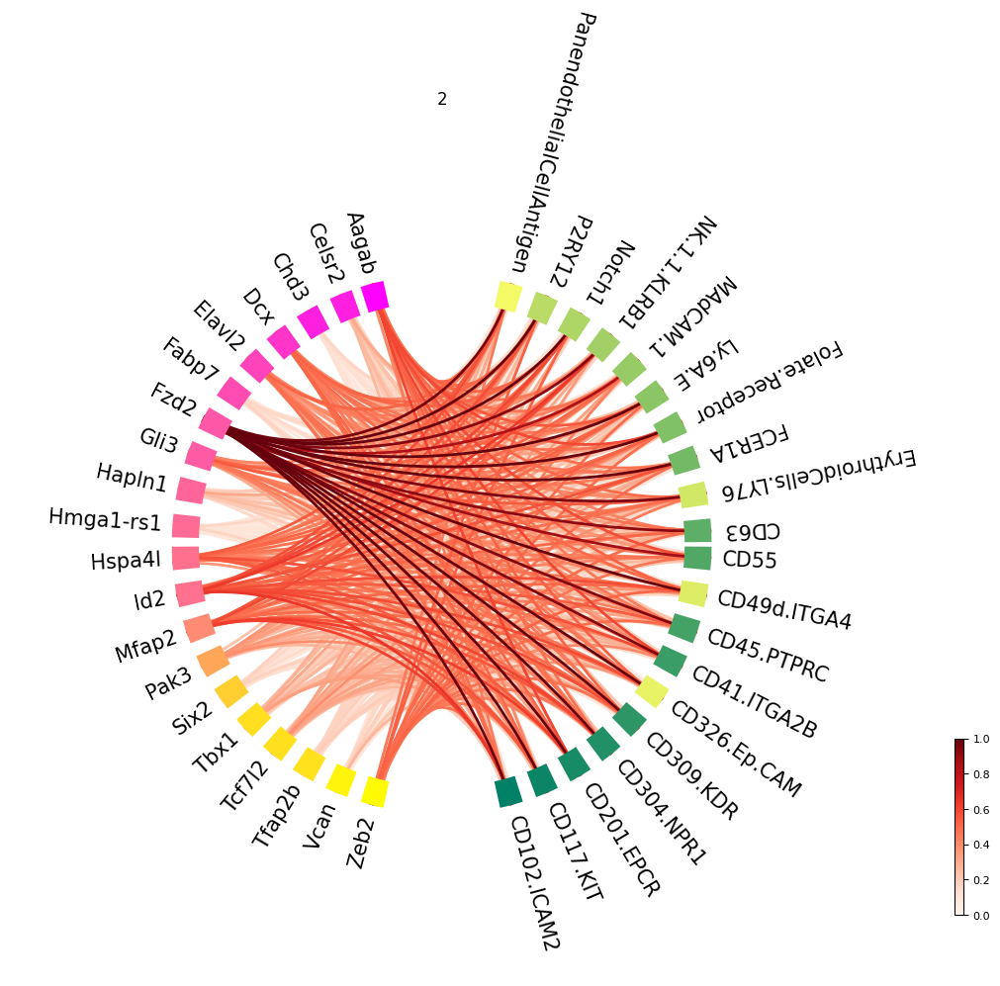

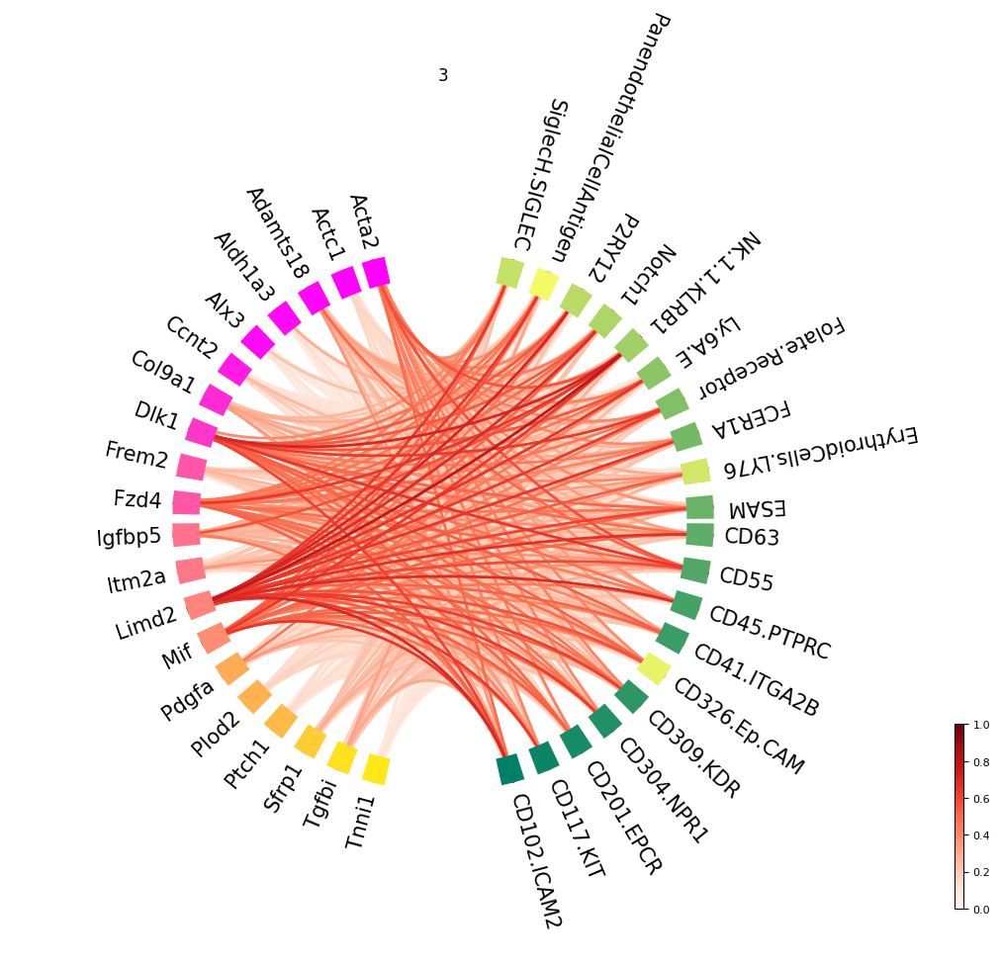

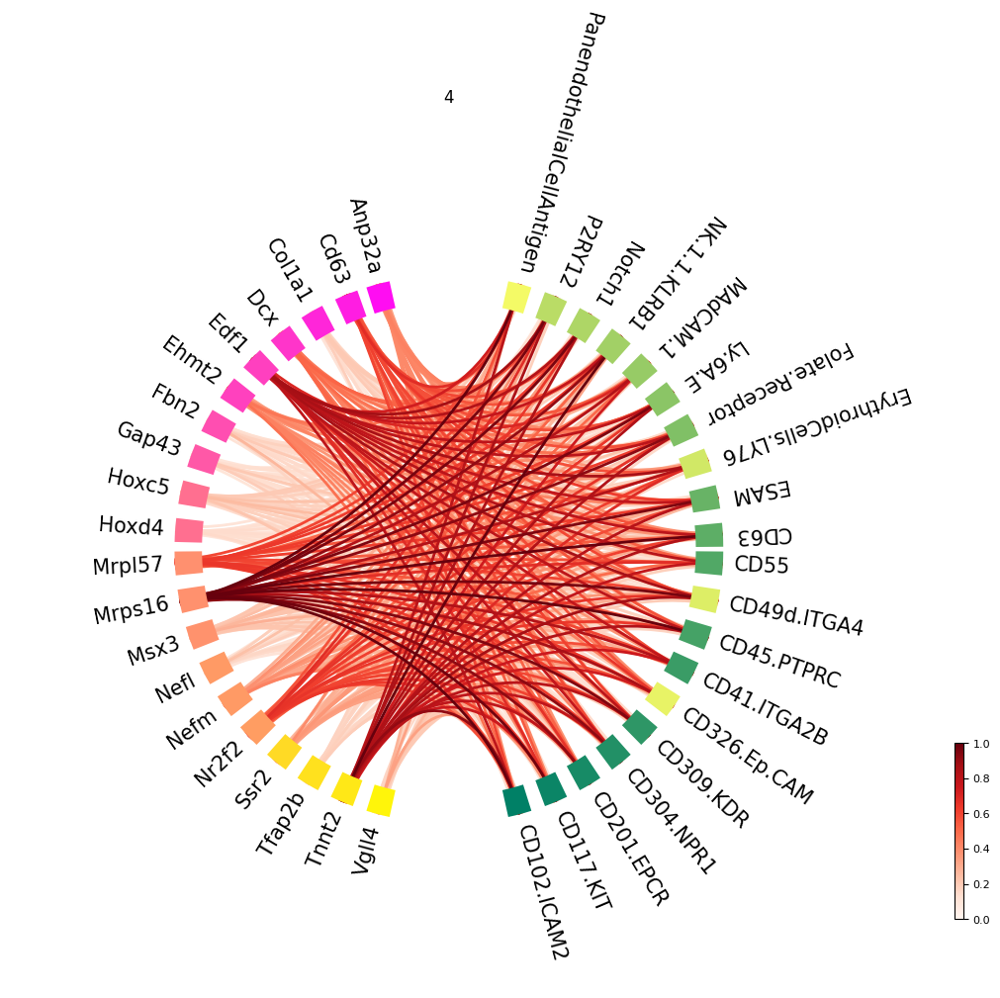

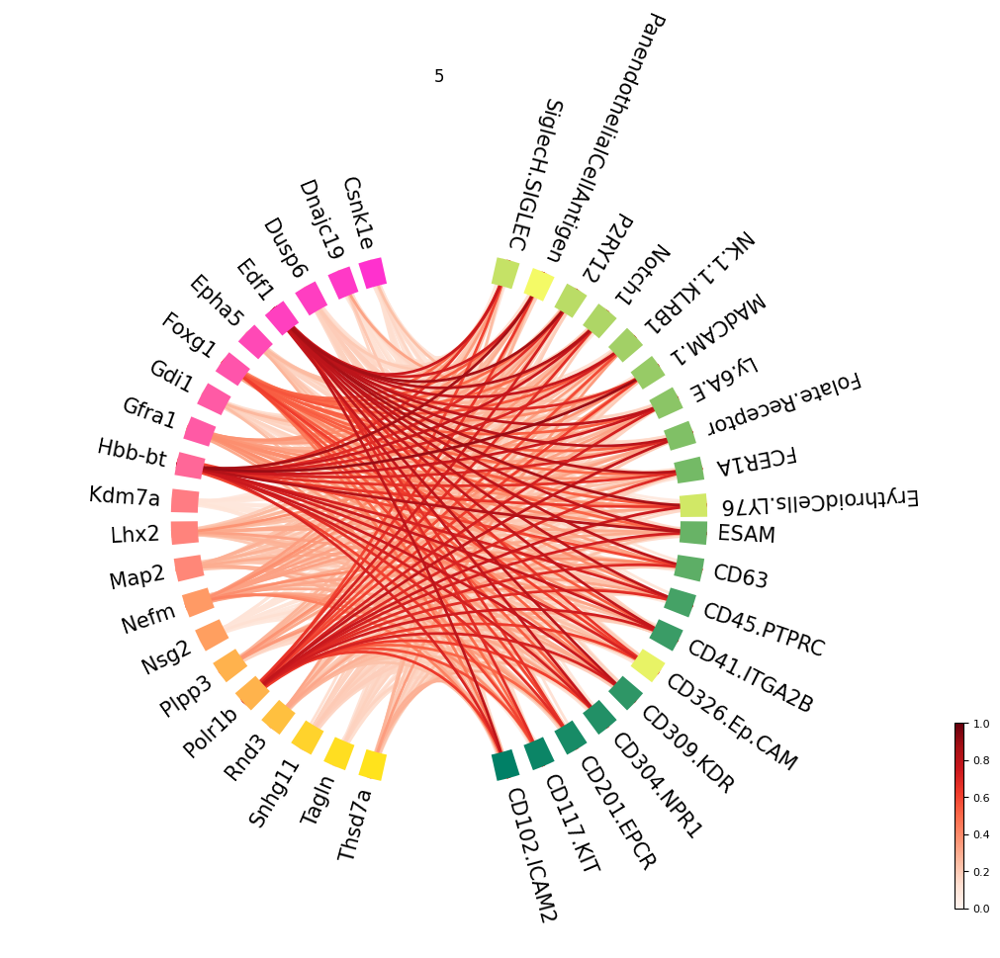

...

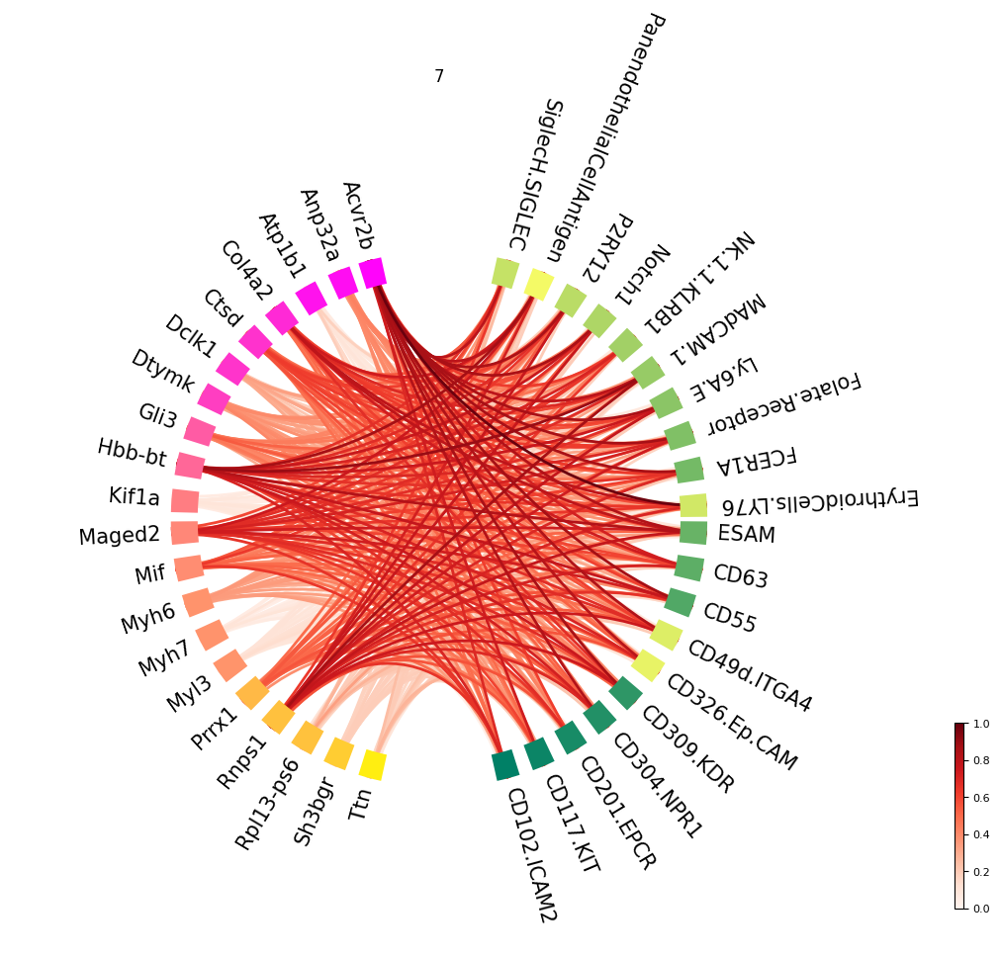

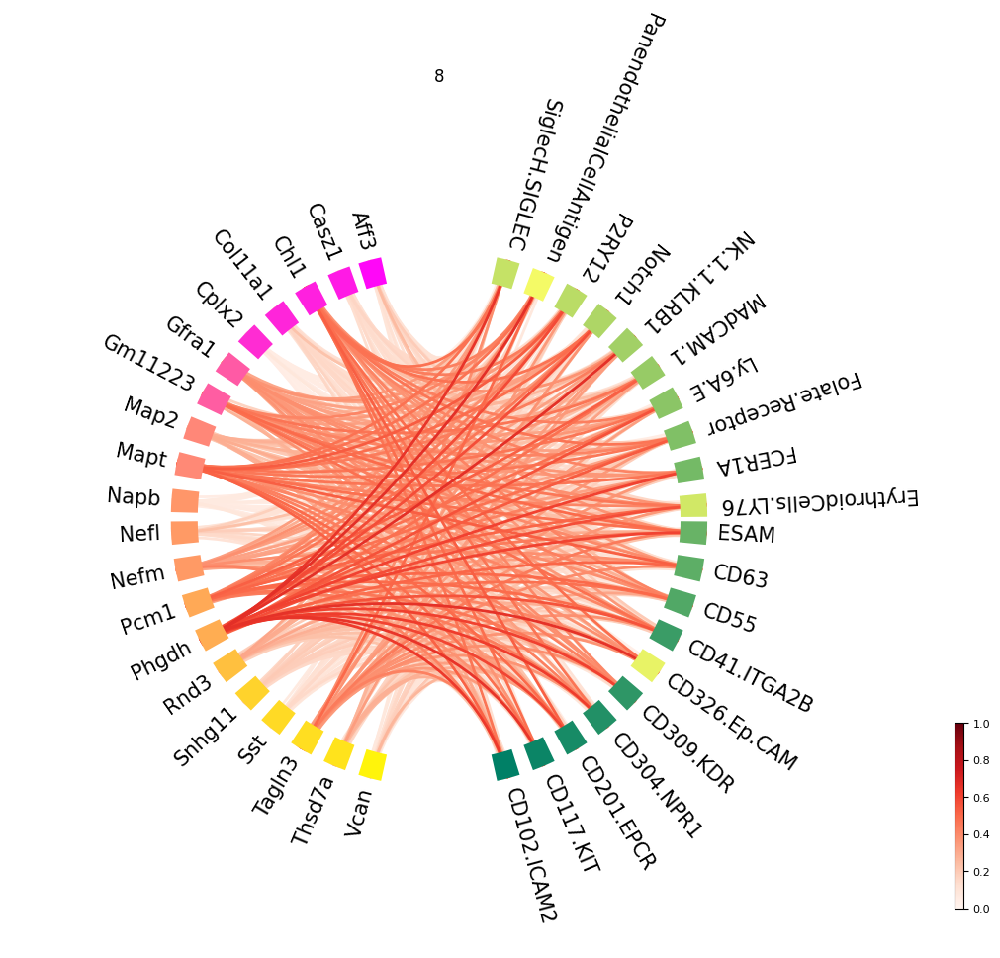

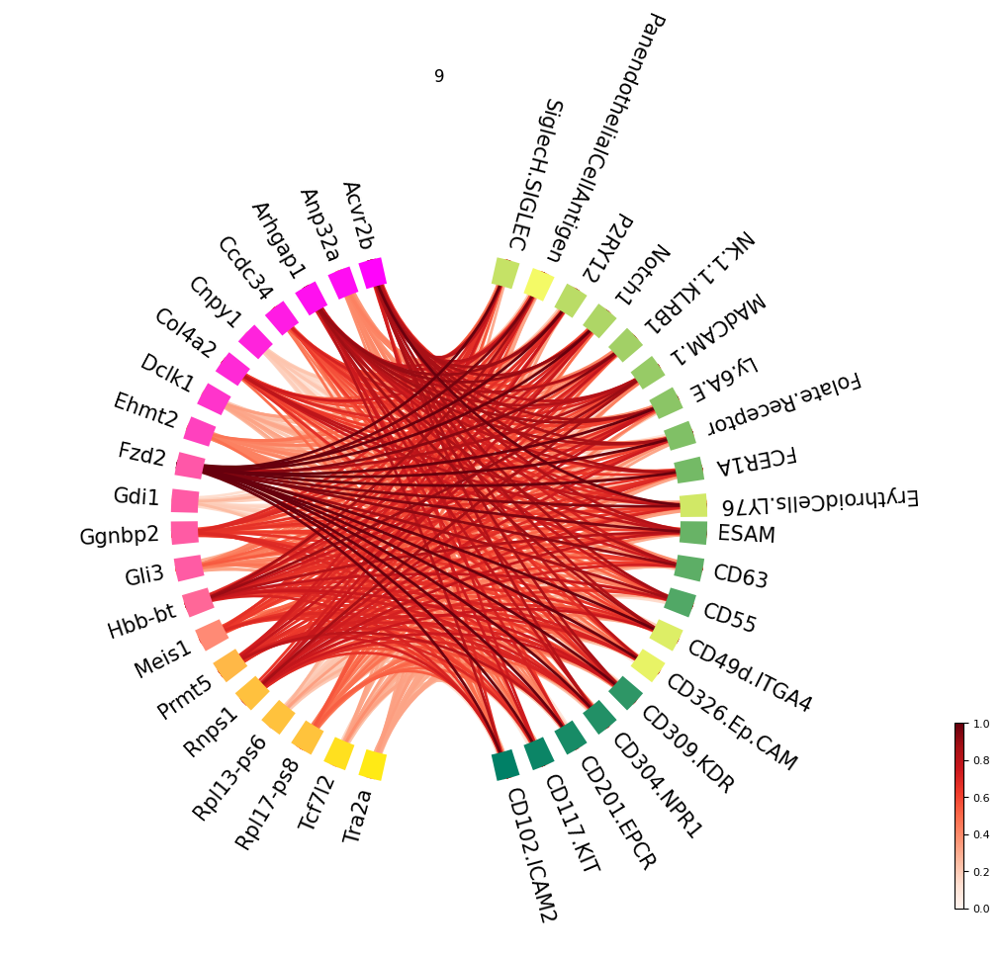

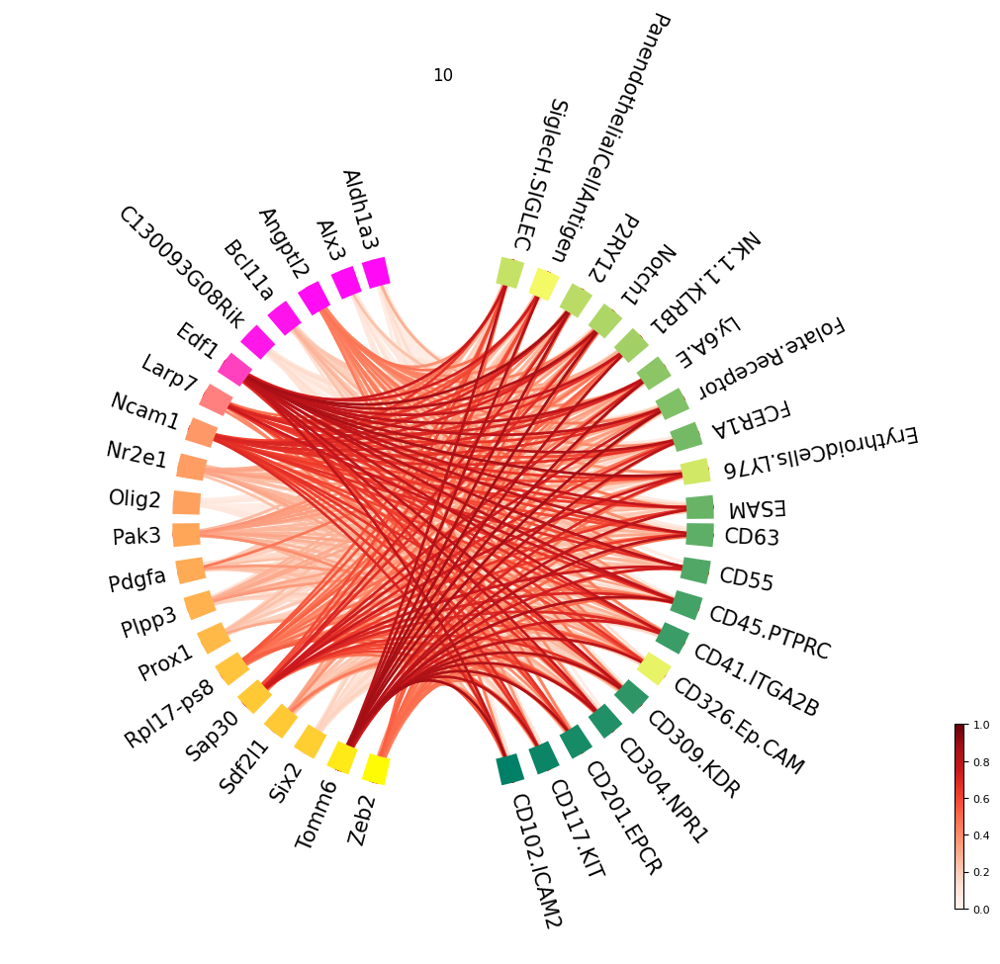

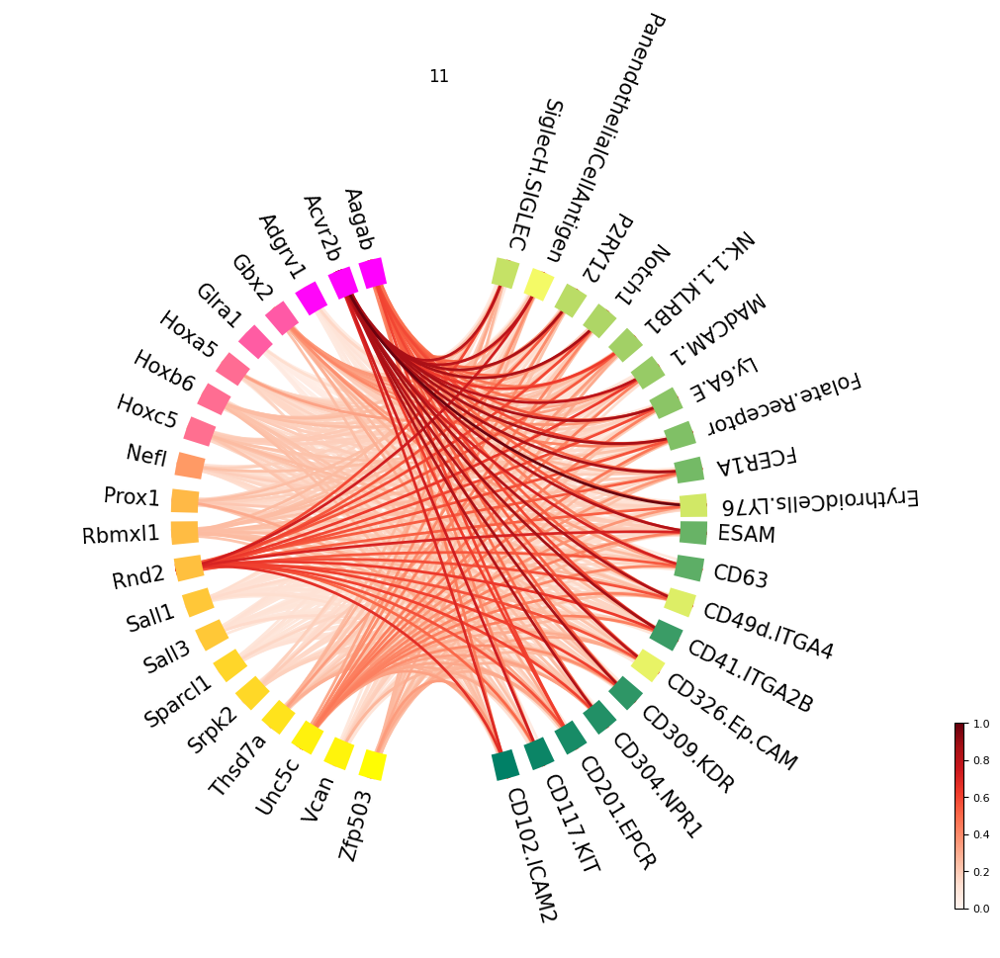

In [39]:
feature_feature_relevance(rna_index, protein_index, make_plot = True)

({0: array([[0.28347543, 0.27660784, 0.22883197, 0.25837513, 0.28602802,
          0.54202031, 0.53617351, 0.35608673, 0.27401079, 0.19014597,
          0.30840436, 0.28009578, 0.37677947, 0.53863277, 0.25224621,
          0.18256334, 0.29071662, 0.34196093, 0.32814363, 0.28497587],
         [0.40085949, 0.28225551, 0.22511474, 0.22912025, 0.32205537,
          0.53412138, 0.22768424, 0.33139414, 0.45438777, 0.14086106,
          0.35190577, 0.37598336, 0.50235881, 0.24933311, 0.29740177,
          0.28241447, 0.31056168, 0.44458382, 0.41579691, 0.28617125],
         [0.43086026, 0.30004904, 0.41655775, 0.15211472, 0.38834228,
          0.29078777, 0.17829053, 0.26403439, 0.23941888, 0.19860498,
          0.22107832, 0.27327767, 0.24414679, 0.1958126 , 0.19249746,
          0.18843989, 0.44274498, 0.32141393, 0.33301723, 0.18202731],
         [0.65287455, 0.38241459, 0.71899269, 0.55122427, 0.39760951,
          0.4447385 , 0.68792677, 0.53634902, 0.16665227, 0.574404  ,
          0.36

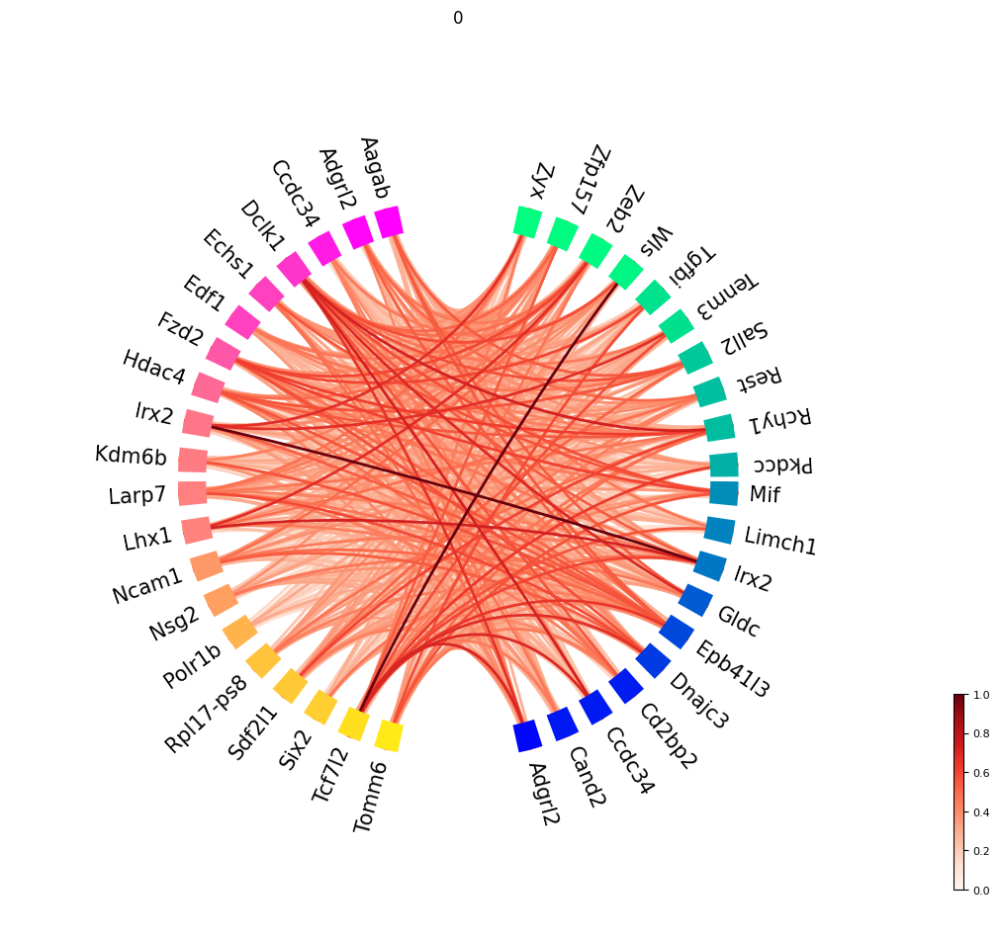

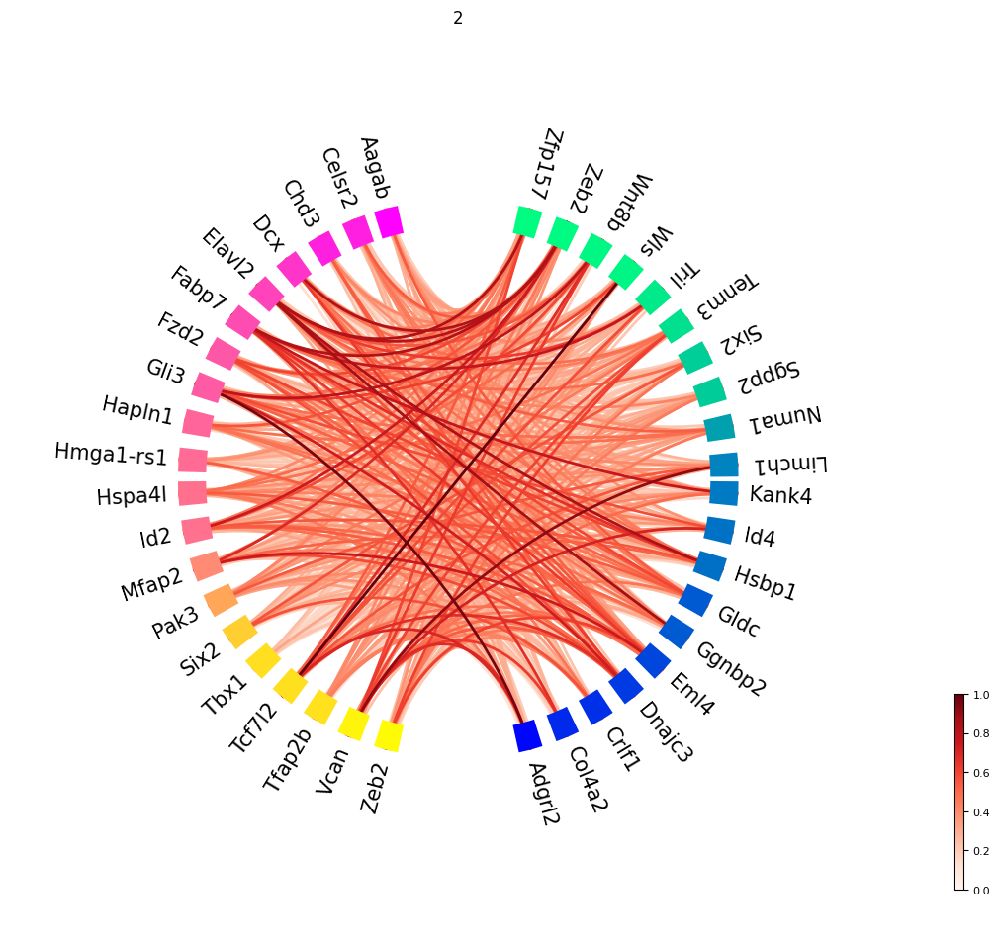

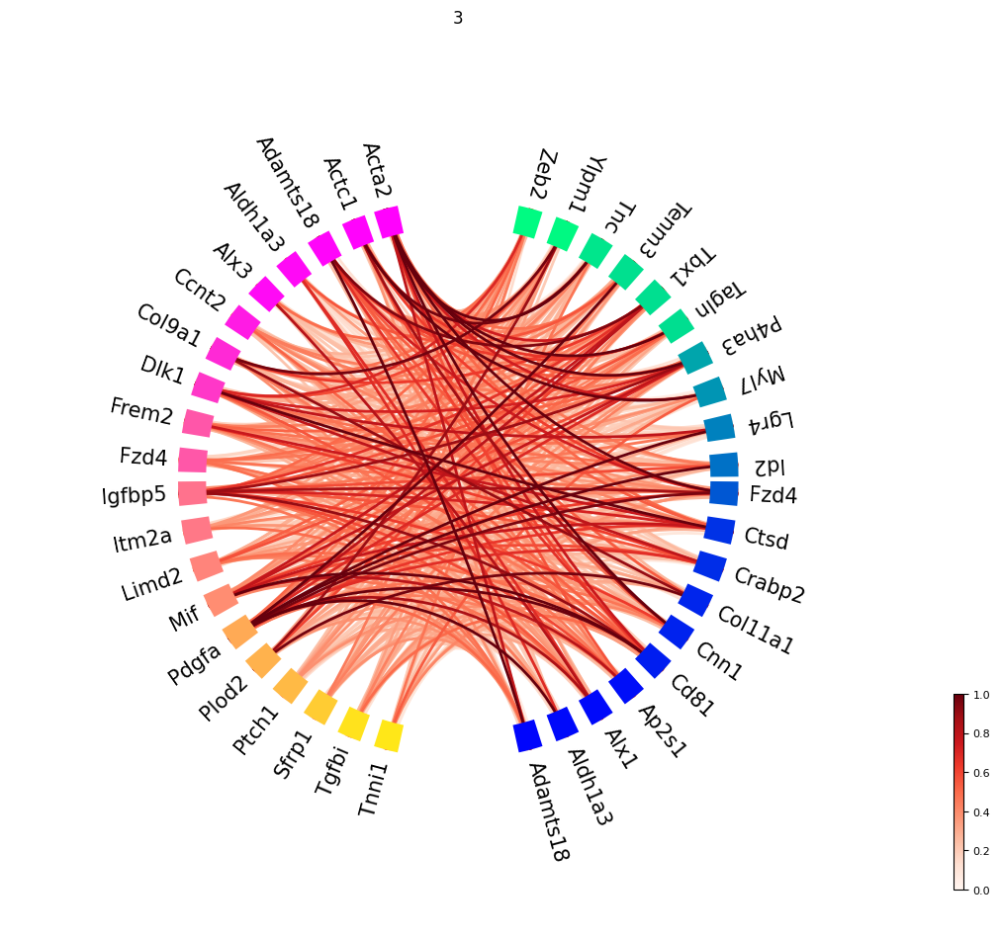

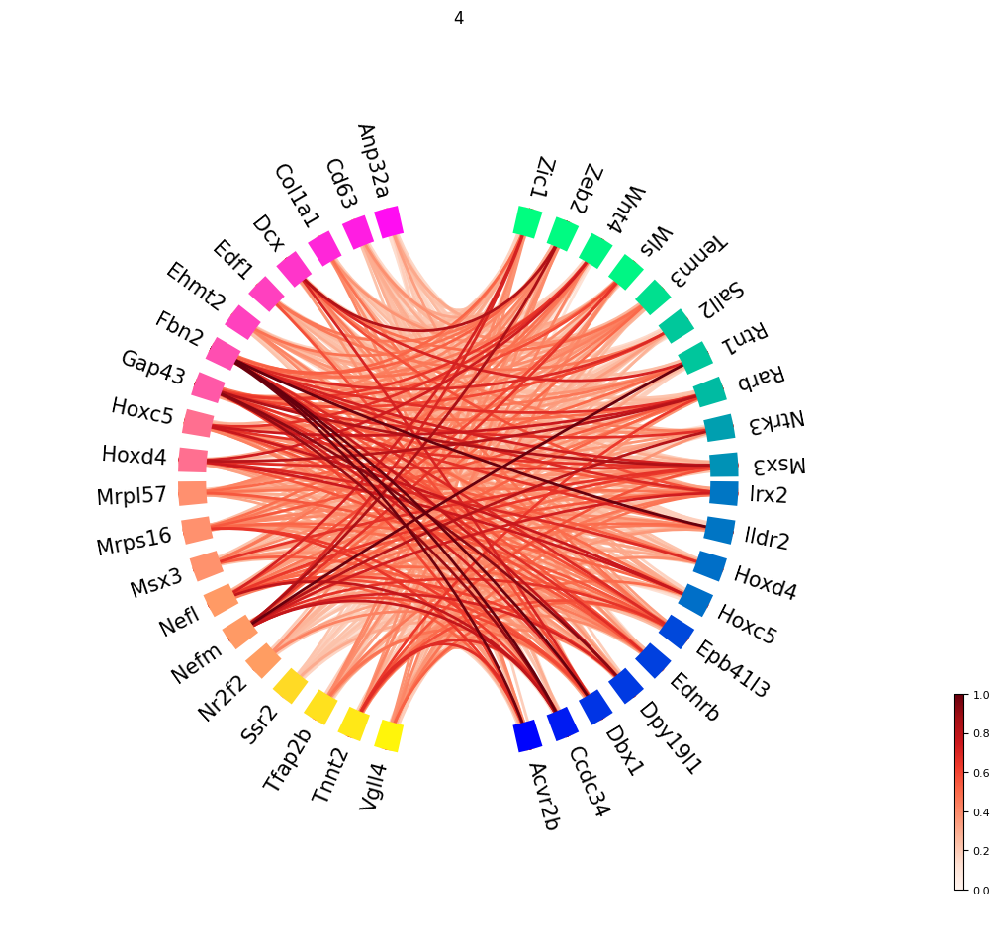

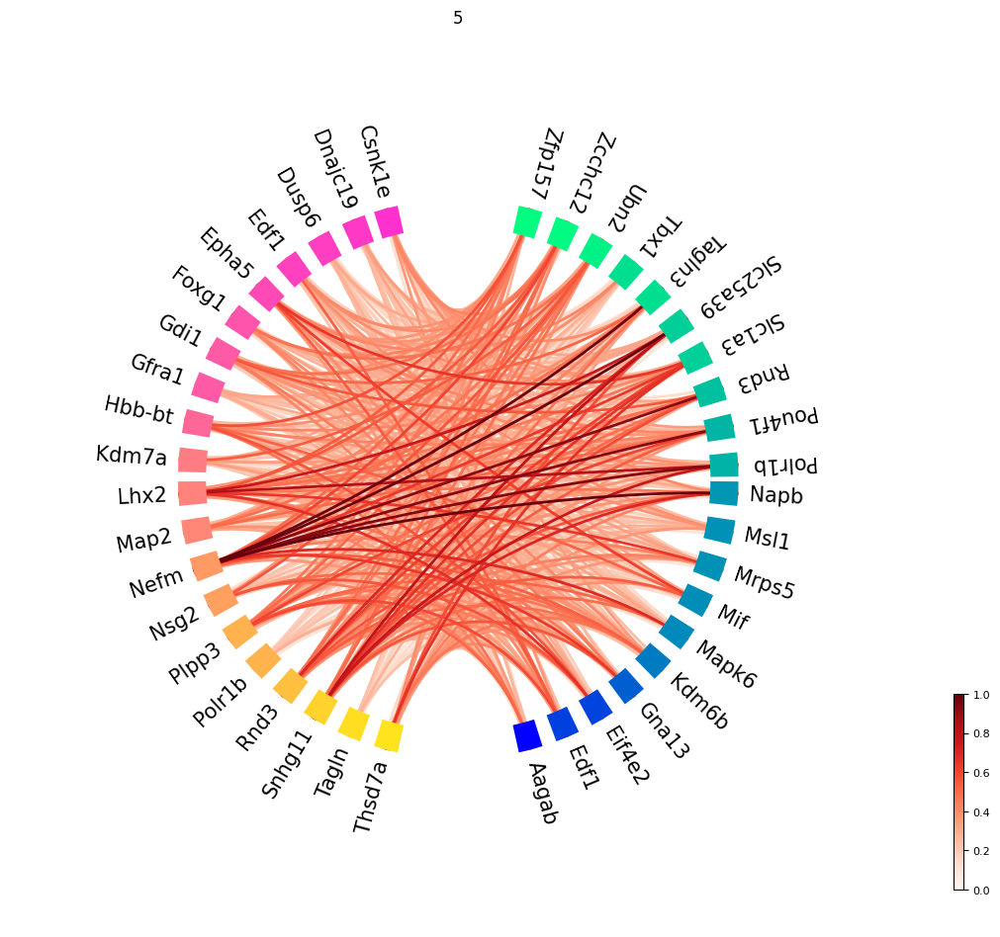

...

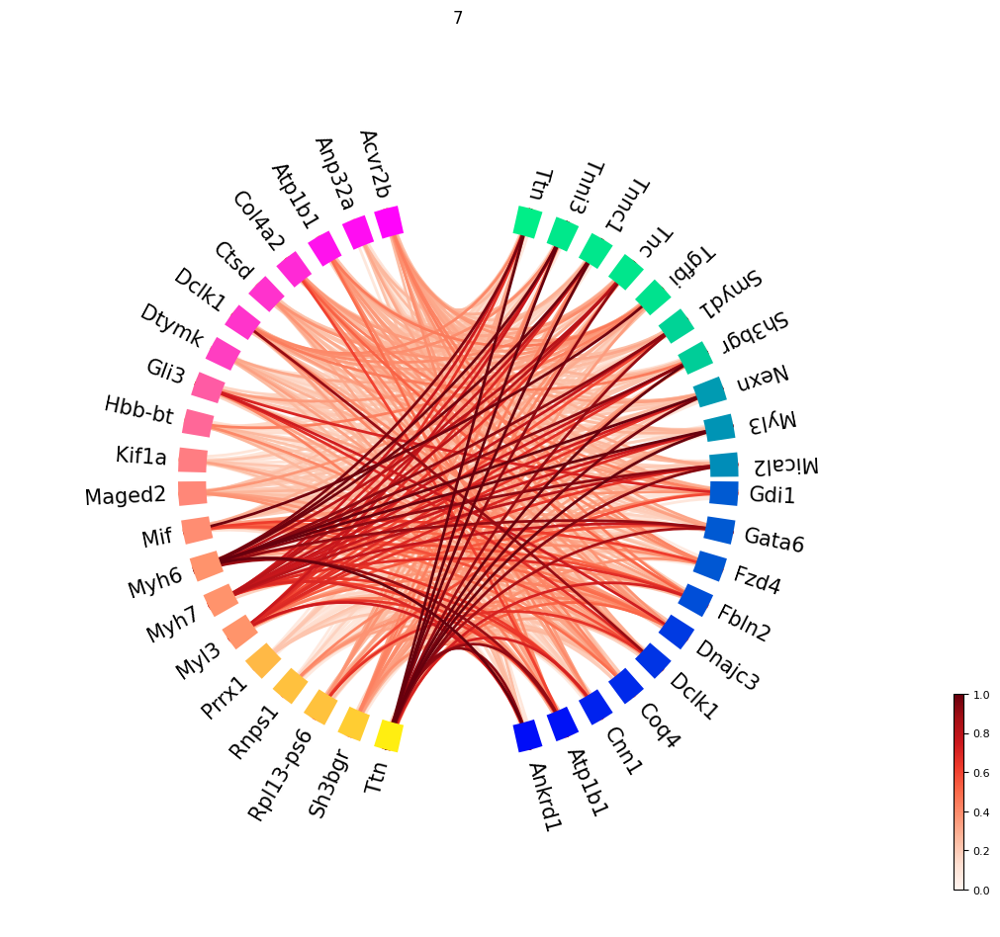

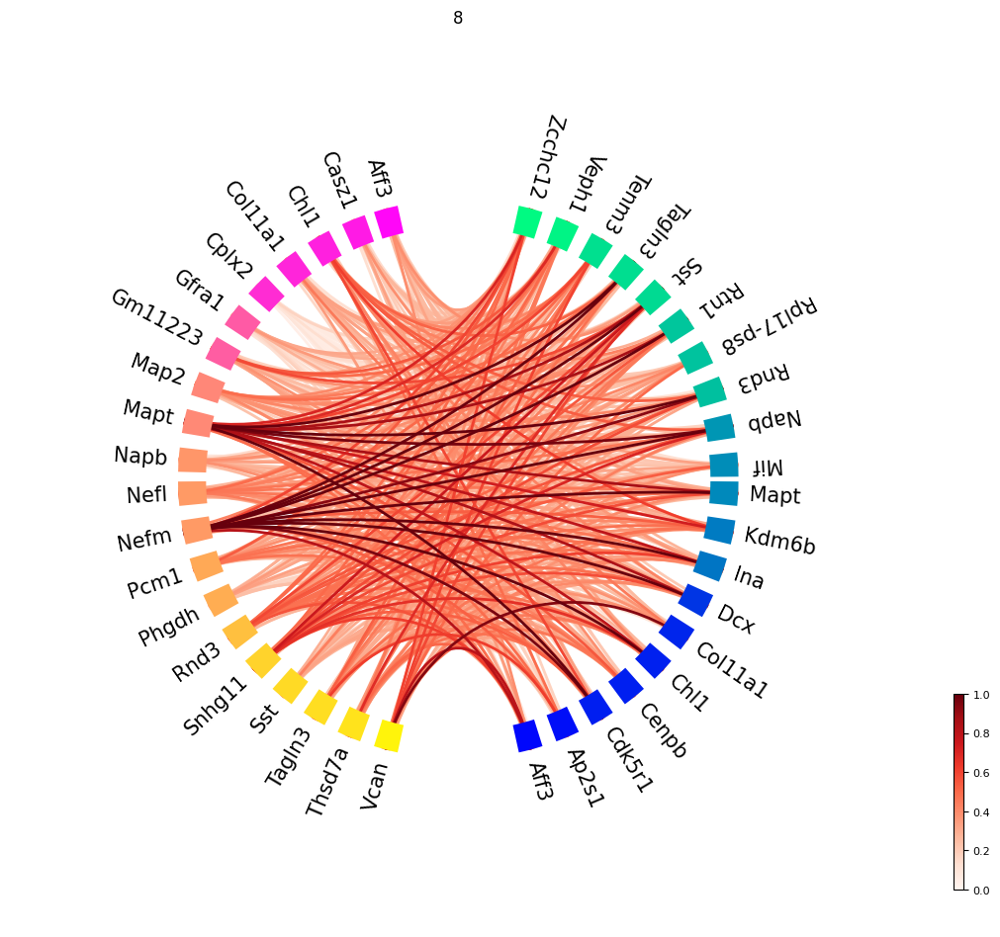

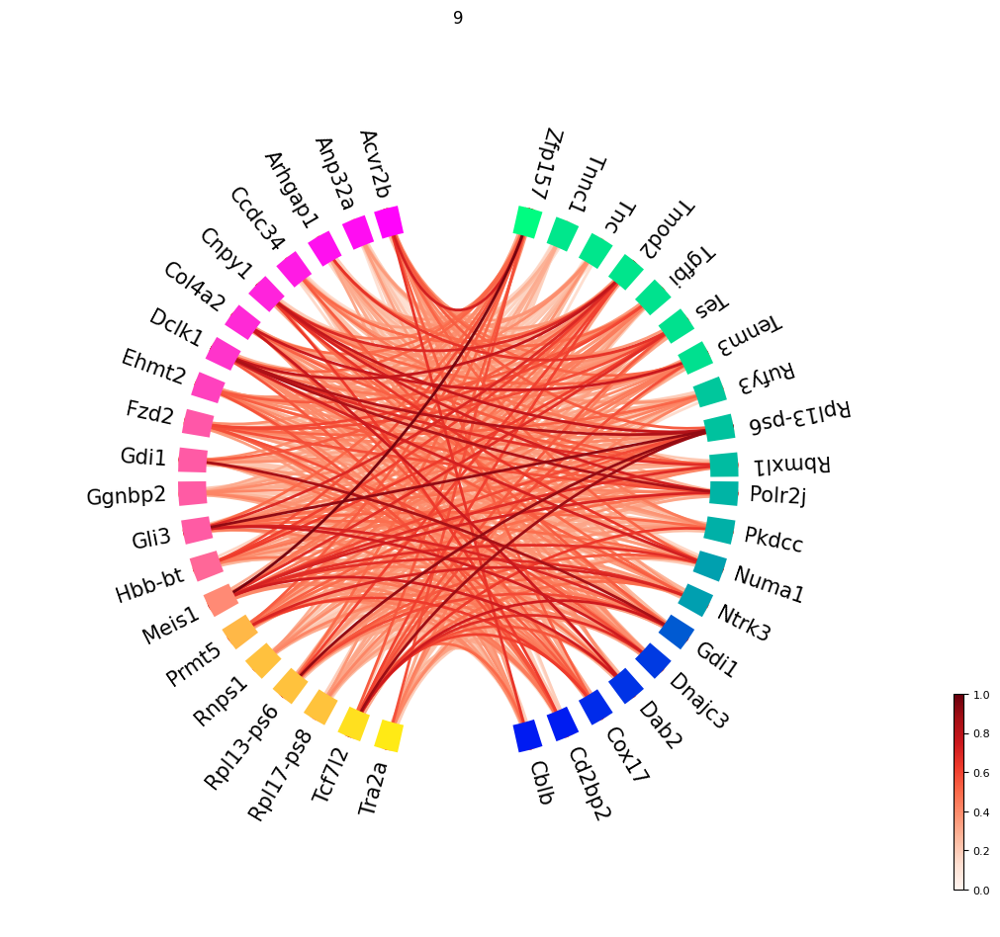

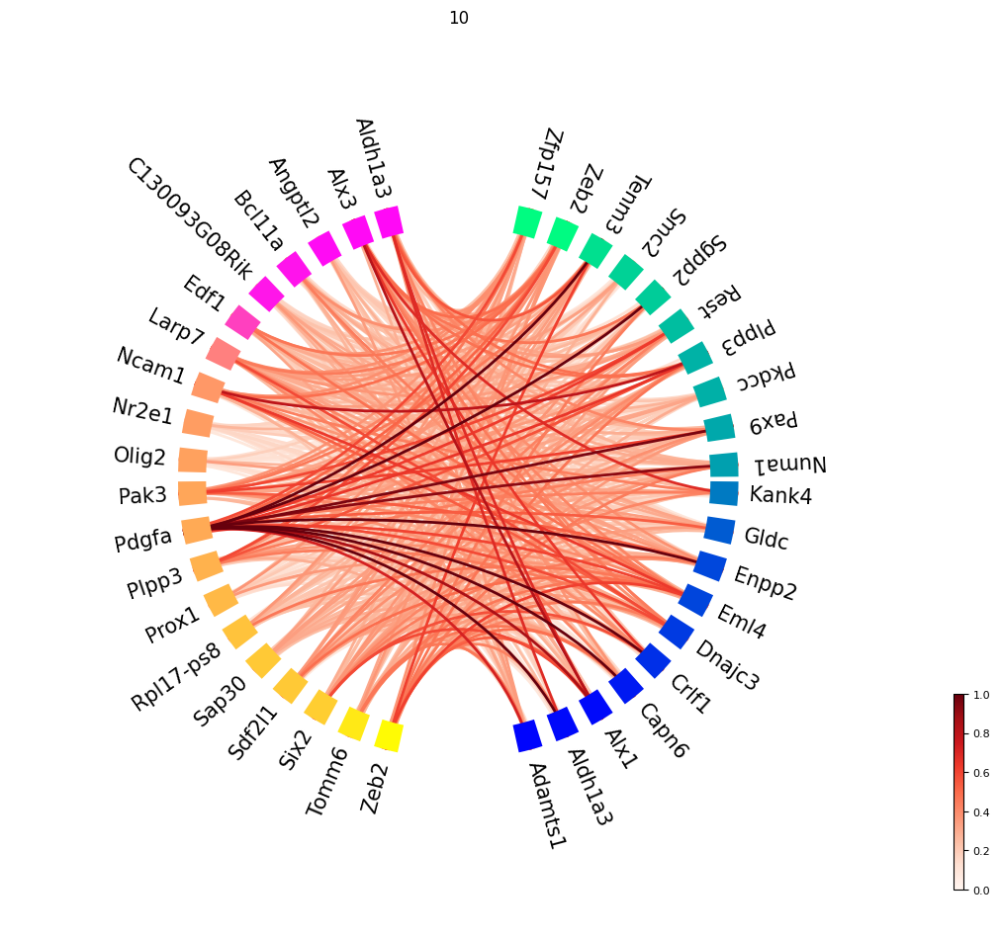

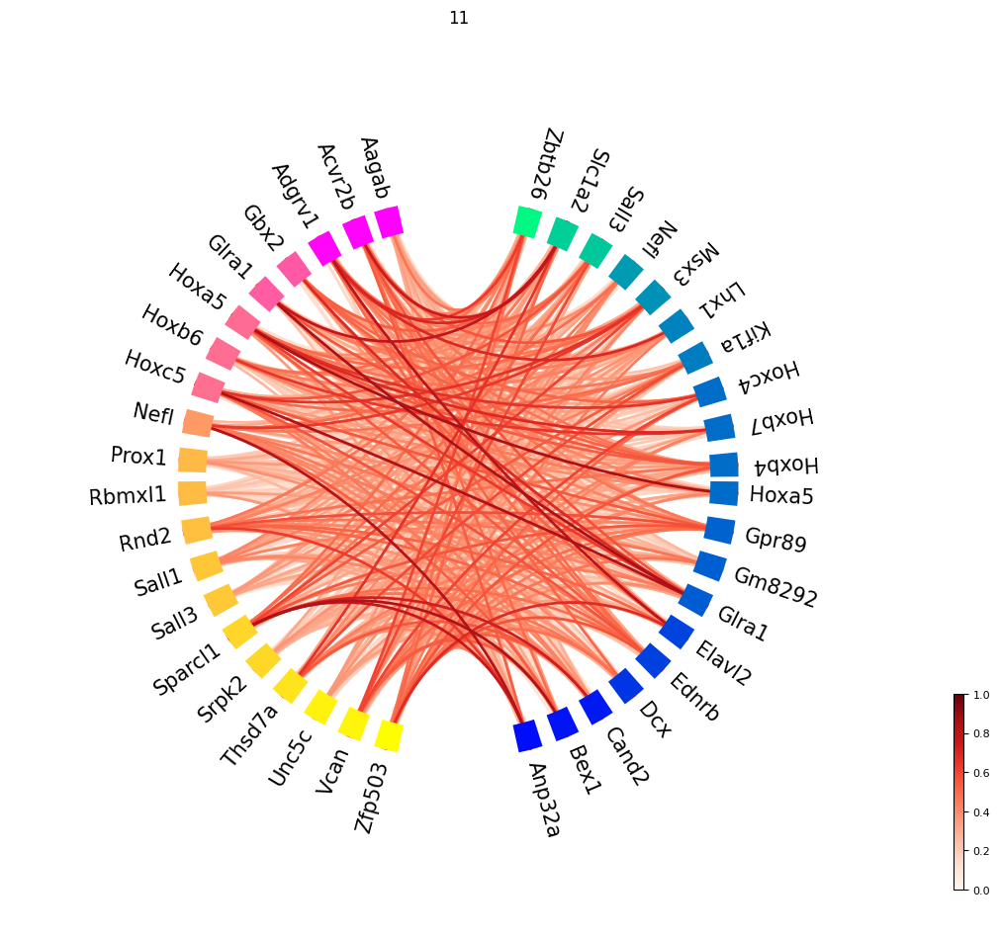

In [48]:
feature_feature_relevance(rna_index, niche_index, make_plot = True)

({0: array([[0.45110144, 0.28244633, 0.67083208, 0.22092018, 0.58068675,
          0.44550756, 0.20278742, 0.39371231, 0.65493711, 0.21485615,
          0.64274881, 0.34391225, 0.32387696, 0.41884266, 0.45895585,
          0.59140893, 0.28584664, 0.27609547, 0.19274262, 0.26065427],
         [1.        , 1.        , 0.94875845, 0.51289154, 1.        ,
          1.        , 0.42958169, 0.97346356, 1.        , 0.63467841,
          0.90259599, 1.        , 1.        , 1.        , 0.92319212,
          0.73938444, 1.        , 1.        , 0.85751998, 0.61064393],
         [0.07134879, 0.06470286, 0.11418347, 0.00839668, 0.09975672,
          0.19187359, 0.10942931, 0.20798327, 0.1049252 , 0.09372026,
          0.09921528, 0.15240748, 0.08734595, 0.33307938, 0.16348593,
          0.06737944, 0.06485016, 0.03602995, 0.1119941 , 0.10702938],
         [0.31884272, 0.21868352, 0.62563887, 0.27812109, 0.52017604,
          0.49956315, 0.63160671, 0.1580661 , 0.41477789, 0.14943442,
          0.57

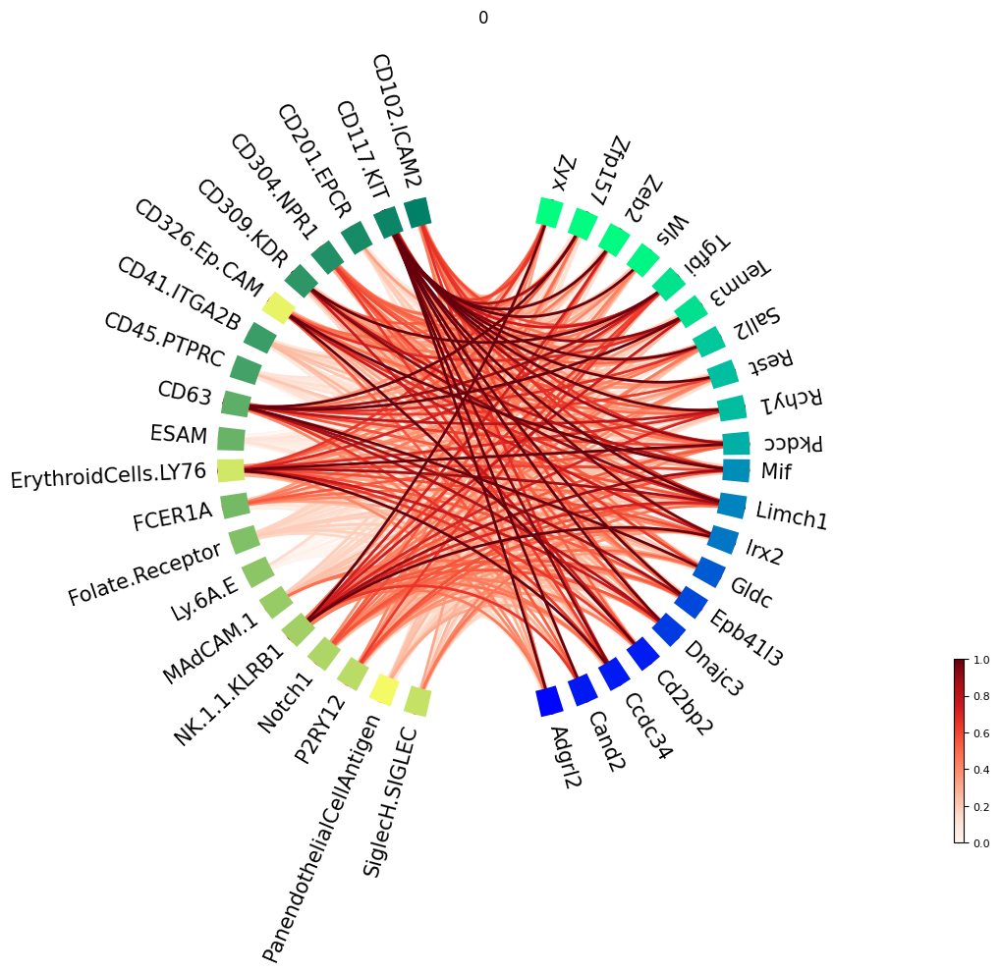

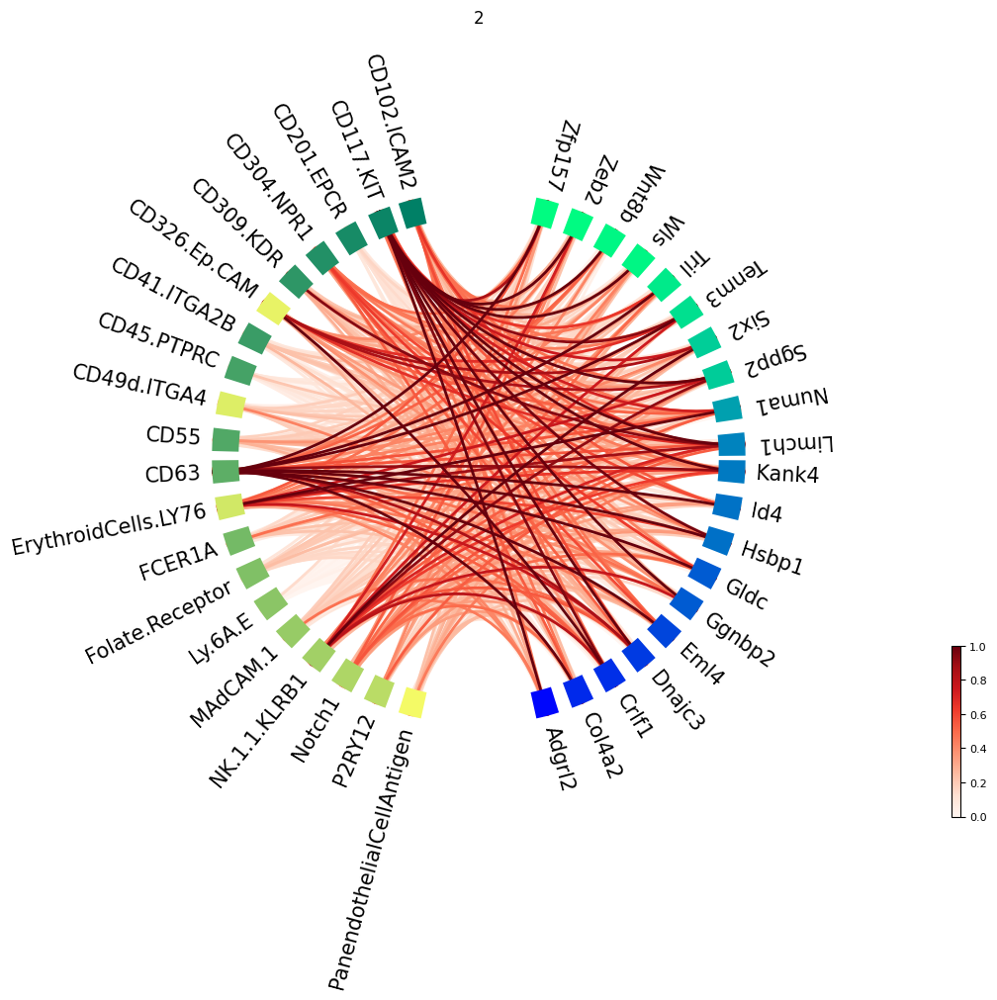

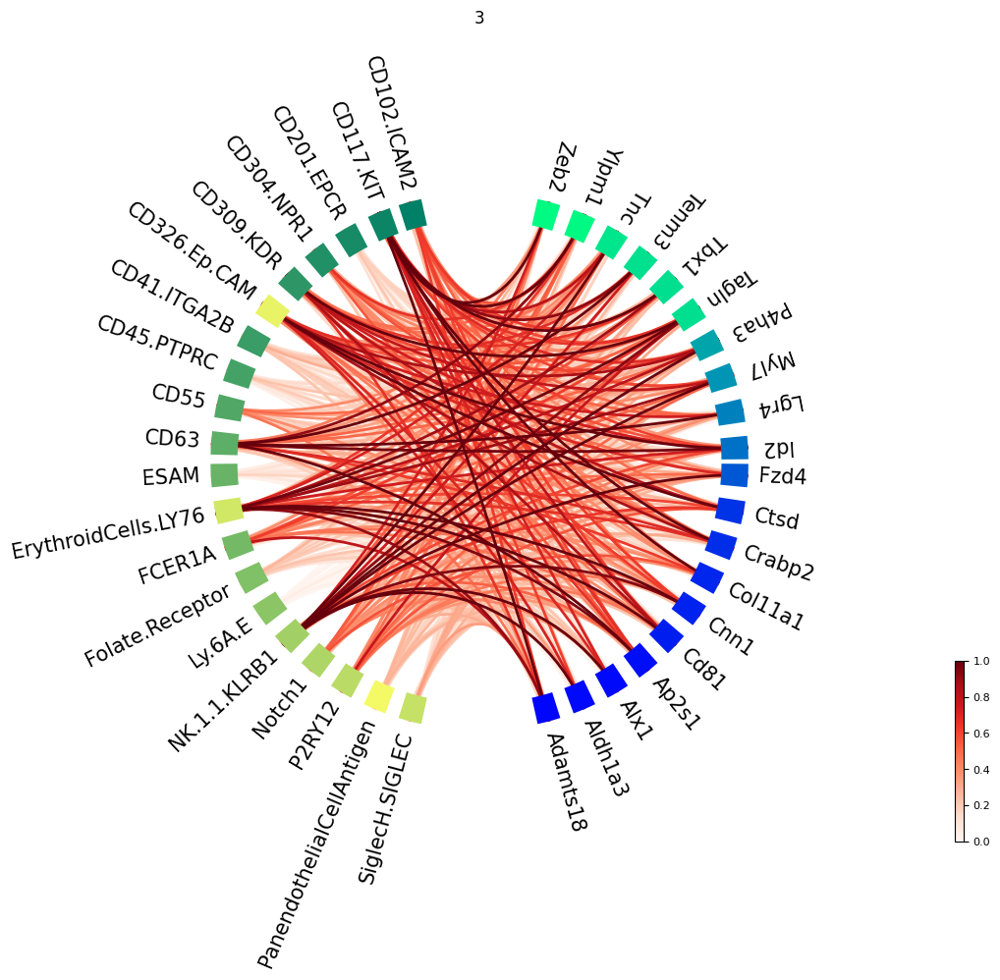

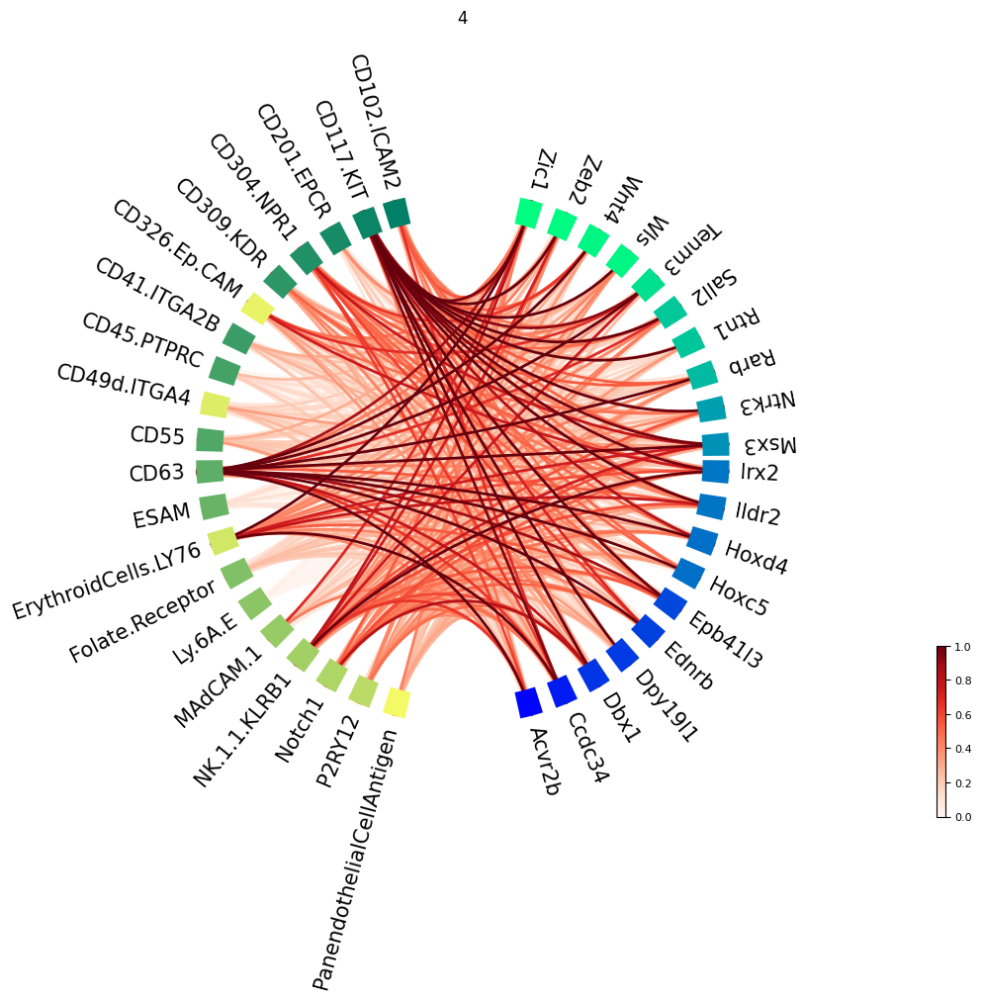

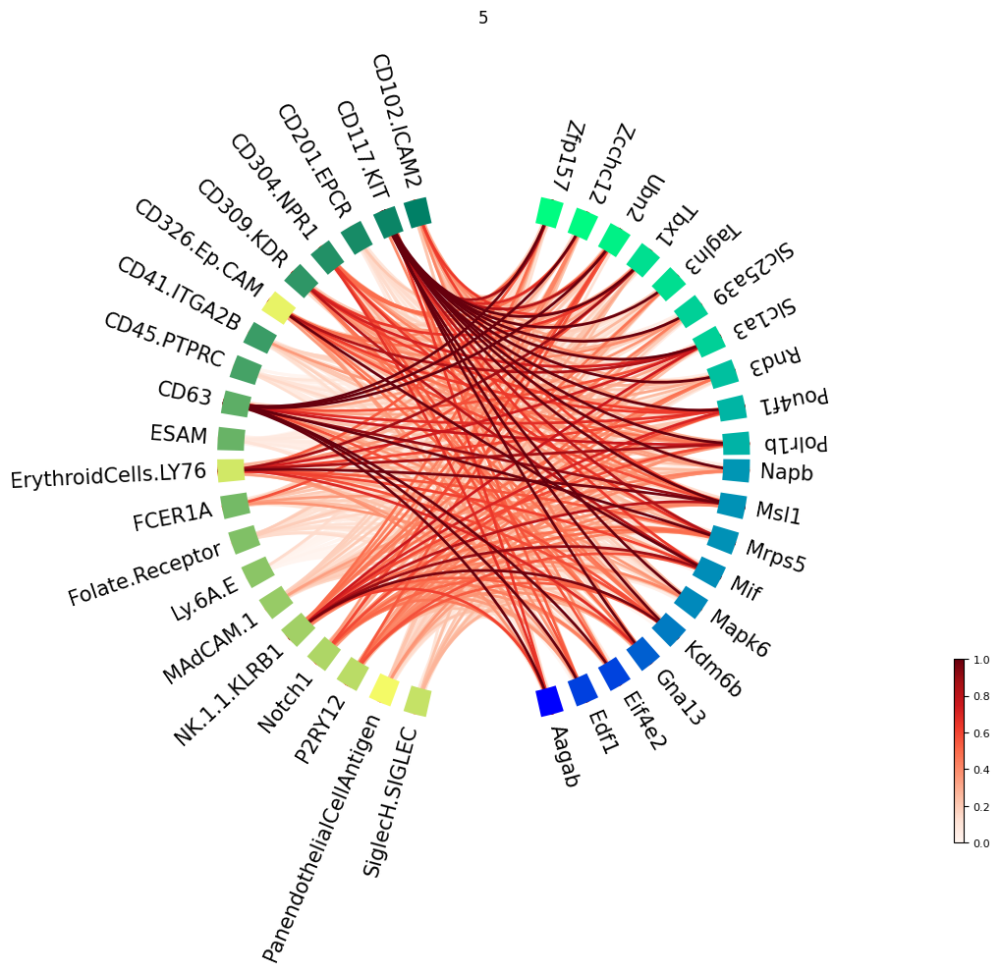

...

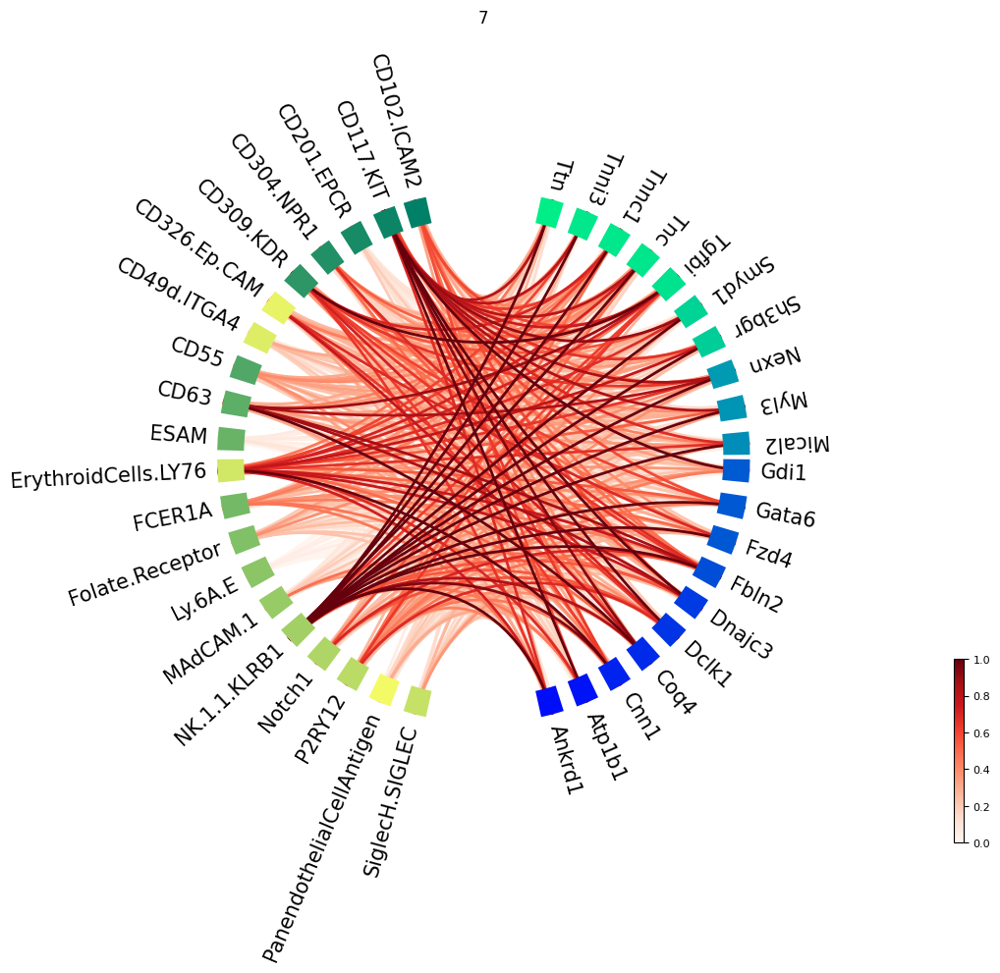

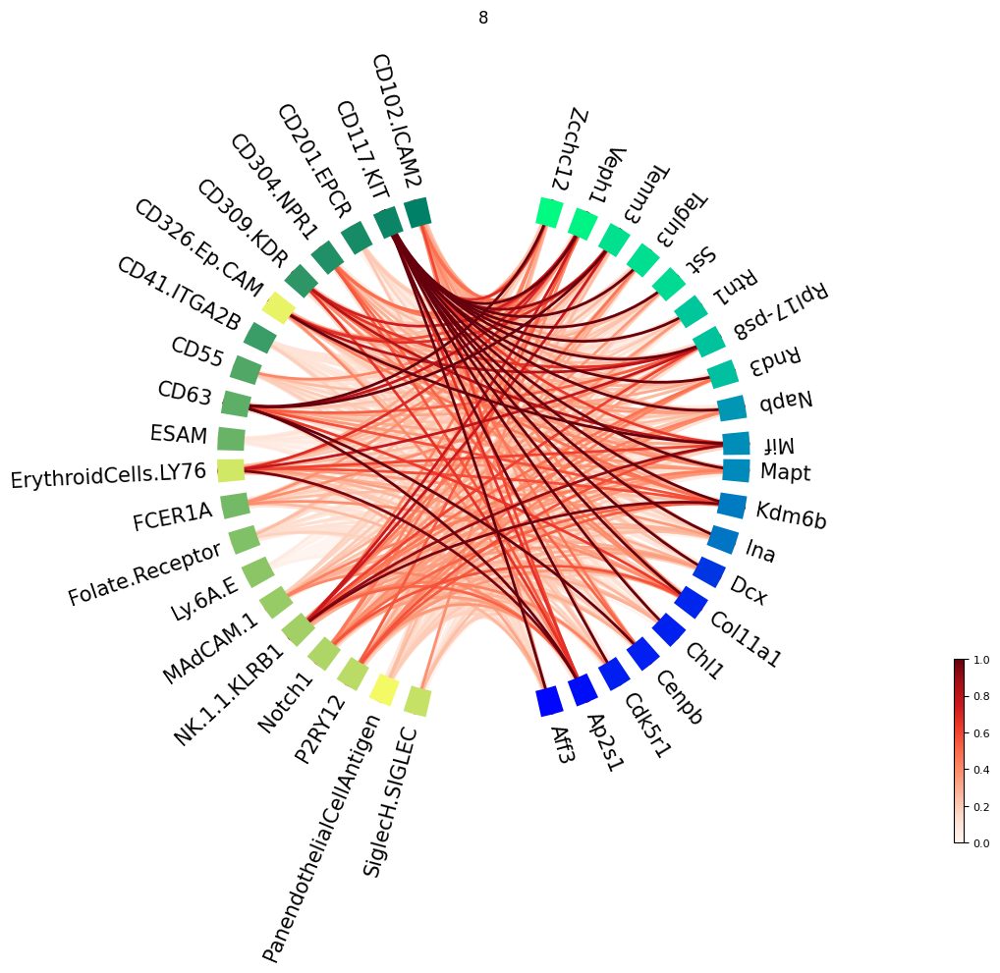

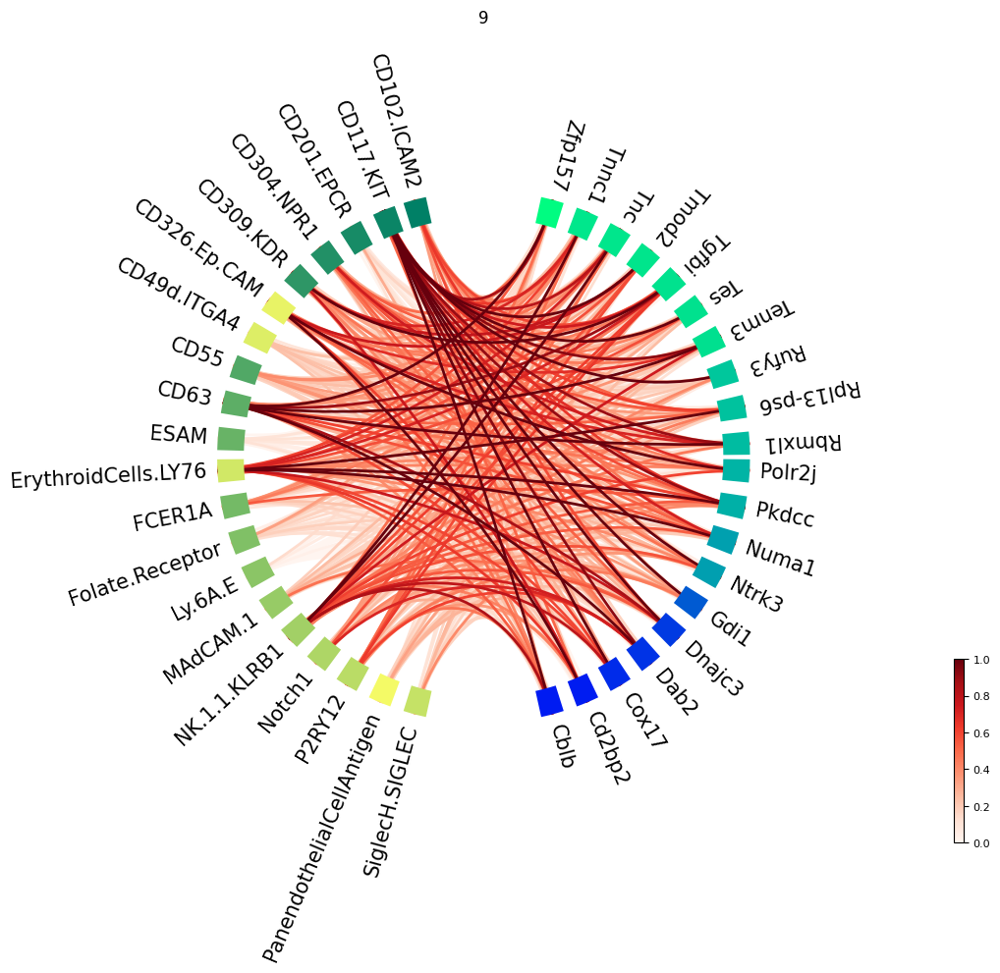

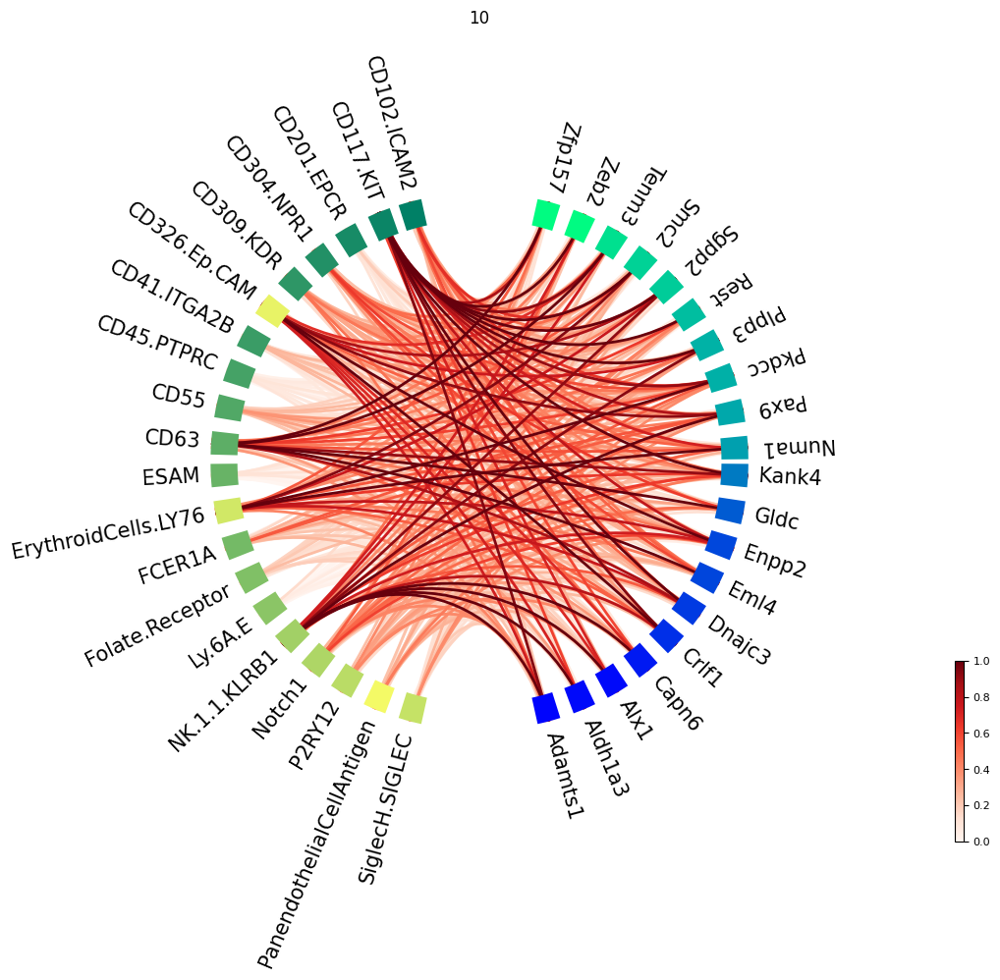

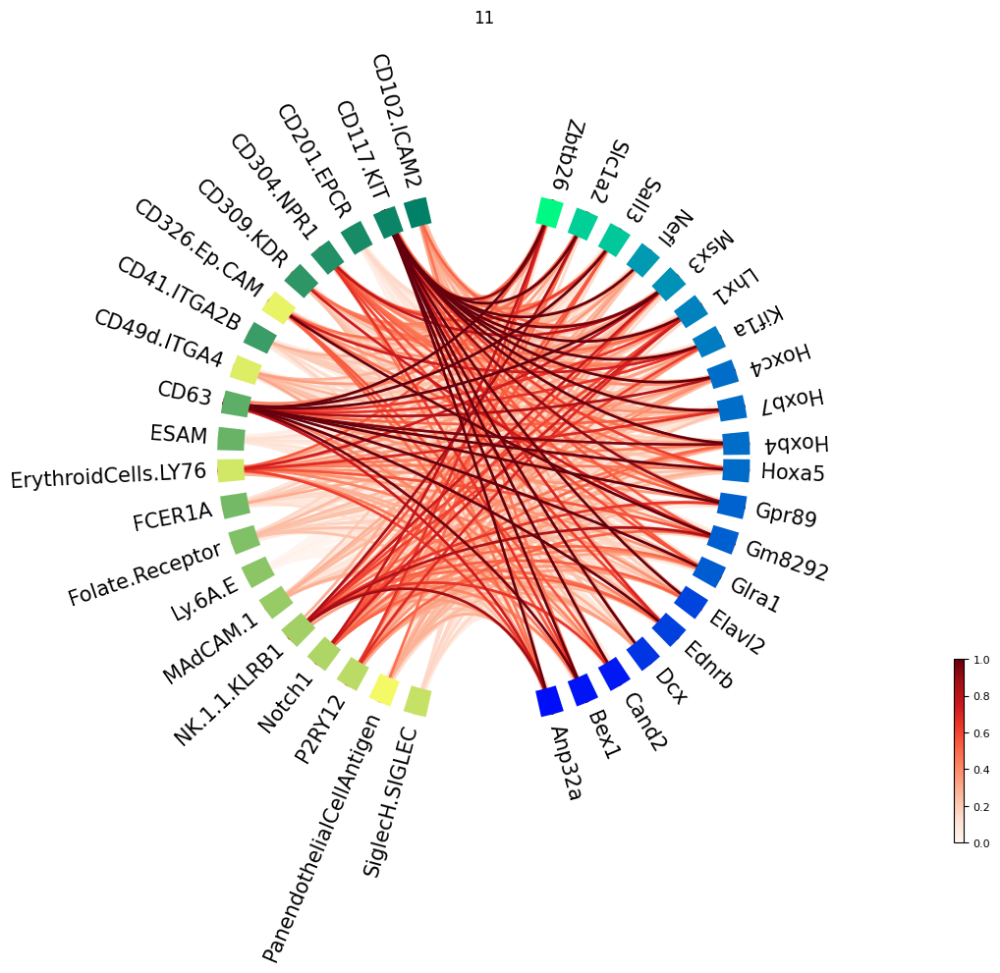

In [47]:
feature_feature_relevance(protein_index, niche_index, make_plot = True)

In [75]:
source_index = rna_index
target_index = protein_index
id2modality = {0: "RNA", 1: "Protein", 2: "Niche"}
rows = []

combinations = [[rna_index, protein_index], [rna_index, niche_index], [protein_index, niche_index]]

def feature_feature_values(source_index, target_index):
    values, labels = feature_feature_relevance(source_index, target_index, make_plot=False)

    for cluster_id, connections in values.items():
        cluster_labels = labels[cluster_id]
        source_labels = cluster_labels[0]
        target_labels = cluster_labels[1]
        target2source = np.transpose(connections)
        for target_label_id, target_label in enumerate(target_labels):
            for source_label_id, source_label in enumerate(source_labels):
                rows.append(
                    {
                        "Cluster": cluster_id,
                        "Direction": f"{id2modality[source_index]} -> {id2modality[target_index]}",
                        "Target": target_label,
                        "Source": source_label,
                        "Value": target2source[target_label_id][source_label_id],
                    }
                )
                
for comb in combinations:
    feature_feature_values(comb[0], comb[1])
    
df = pd.DataFrame(rows)
print(df)
df.to_csv(f'{saved_results}/feature_feature_importance.csv', index=False)

       Cluster         Direction       Target                     Source  \
0            0    RNA -> Protein  CD102.ICAM2                      Aagab   
1            0    RNA -> Protein  CD102.ICAM2                     Adgrl2   
2            0    RNA -> Protein  CD102.ICAM2                     Ccdc34   
3            0    RNA -> Protein  CD102.ICAM2                      Dclk1   
4            0    RNA -> Protein  CD102.ICAM2                      Echs1   
...        ...               ...          ...                        ...   
11995       11  Protein -> Niche       Zbtb26               NK.1.1.KLRB1   
11996       11  Protein -> Niche       Zbtb26                     Notch1   
11997       11  Protein -> Niche       Zbtb26                     P2RY12   
11998       11  Protein -> Niche       Zbtb26  PanendothelialCellAntigen   
11999       11  Protein -> Niche       Zbtb26             SiglecH.SIGLEC   

          Value  
0      0.444735  
1      0.552714  
2      0.467150  
3      0.250537

# 3.3 Coming full circle: Spatial mapping of KO-responsive genes

To spatially map the perturbation effect of the Six2 digital KO on the DBiT-seq dataset, we record the strongest associations of the KO-responsive genes with proteins, per spatial domain:




*   **Six2 (Cluster 10) -- ESAM?**





*   Vcan (Cluster 6,7,3,11) -- protein?
  - Cluster 6: Vcan & CD49d.ITGA4
  - Cluster 7: Vcan & CD41.ITGA2B
  - Cluster 3: Vcan & CD45.PTPRC
  - Cluster 11: Vcan & CD41.ITGA2B

*   Gpc3 (Cluster 6,7) -- protein?
  - Cluster 6: Gpc3 & CD45.PTPRC
  - Cluster 7: Gpc3 & CD326.Ep.CAM

*   Fbn2(Cluster 2,5) -- protein?
  - Cluster 2: Fbn2 & CD63
  - Cluster 5: Fbn2 & CD63


Top 10 Pathways:
15                                 Megakaryocyte
24                                Tight junction
23                                 Cell adhesion
12                                  Gastrulation
11                   Skeletal system development
132    Abnormal cardiovascular system physiology
10                            Tissue development
6                       Ureteric bud development
7                                 Cell migration
8                               Tube development
Name: description, dtype: object


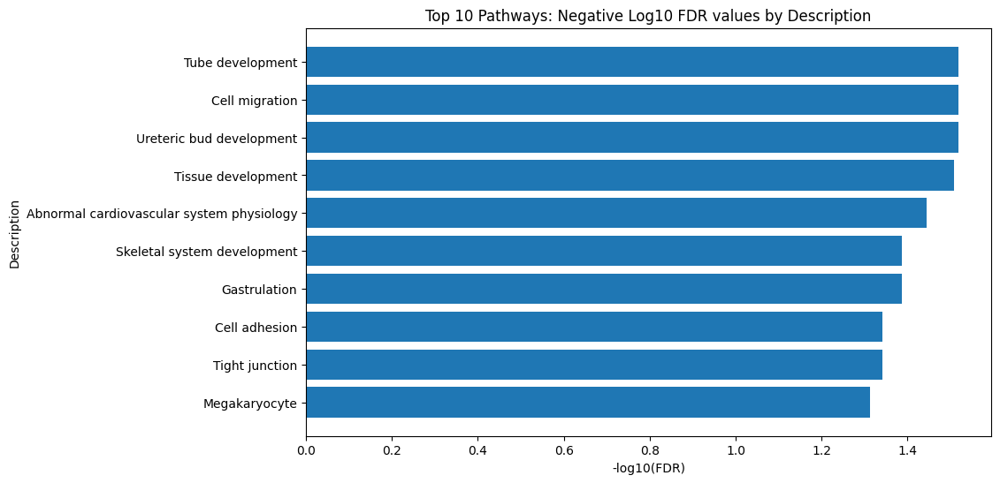

In [68]:
genes = ["Six2", "Vcan", "Gpc3", "Fbn2", "Esam", "Itga4", "Itga2b", "Ptprc", "Epcam"]
string_ids = stringdb.get_string_ids(genes, species = 10090)   # human is 'species=9606'

# Performe pathway enrichment
enrichment_df = stringdb.get_enrichment(string_ids.queryItem, species = 10090)
enrichment_df
df = enrichment_df
sorted_df = df.sort_values(by='fdr', ascending=False)

# Select the top 10 pathways to visualise
top_10_pathways = sorted_df['description'].head(10)

print("Top 10 Pathways:")
print(top_10_pathways)

# Plotting negative log10 of FDR values against description to discern most significant pathways
plt.figure(figsize=(10, 6))
plt.barh(sorted_df['description'].head(10), -1 * sorted_df['fdr'].head(10).apply(lambda x: math.log10(x)))
plt.xlabel('-log10(FDR)')
plt.ylabel('Description')
plt.title('Top 10 Pathways: Negative Log10 FDR values by Description')
plt.show()

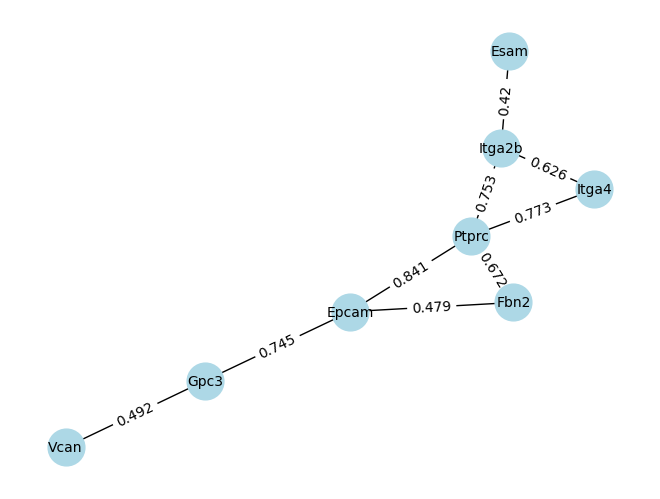

In [69]:
# Preparing visualization of STRINGdb network with Networkx
network_df = stringdb.get_network(string_ids.queryItem, species = 10090, required_score=400)
df = network_df
G = nx.Graph()
for index, row in df.iterrows():
    G.add_edge(row['preferredName_A'], row['preferredName_B'], weight=row['score'])

# Draw the graph
pos = nx.spring_layout(G)  # positions for all nodes
nx.draw(G, pos, with_labels=True, node_size=700, node_color='lightblue', font_size=10)

# Draw edge labels with weights
edge_labels = nx.get_edge_attributes(G, 'weight')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.show()

In [70]:
GenKI_list = ['Nefm', 'Hba-a2', 'Hba-x', 'Hbb-y', 'Hba-a1', 'Fbn2', 'Hbb-bh1', 'Hoxa5', 'Gpc3', 'Nefl']

In [71]:
UN_SHAP_list = ["Cd63", 'Epcam', 'Esam', 'Npr1', 'Ptprc']

In [72]:
STRINGdb_list = GenKI_list + UN_SHAP_list

In [73]:
STRINGdb_list

['Nefm',
 'Hba-a2',
 'Hba-x',
 'Hbb-y',
 'Hba-a1',
 'Fbn2',
 'Hbb-bh1',
 'Hoxa5',
 'Gpc3',
 'Nefl',
 'Cd63',
 'Epcam',
 'Esam',
 'Npr1',
 'Ptprc']

Top 10 Pathways:
144    RHO GTPases activate KTN1, and Neurofilament b...
33                                          Glycoprotein
19               Negative regulation of cellular process
18                          Myeloid cell differentiation
17                              Developmental maturation
16               Neurofilament cytoskeleton organization
15               Positive regulation of cellular process
3                                          Neurofilament
39        Intermediate filament head, DNA-binding domain
41       Intermediate filament head (DNA binding) region
14                                          Localization
143                                  Haptoglobin binding
24                                         Neurofilament
37                                 Hemoglobin, beta-type
38                                Hemoglobin, alpha-type
13                           Regulation of axon diameter
12                              Regulation of cell death
30            

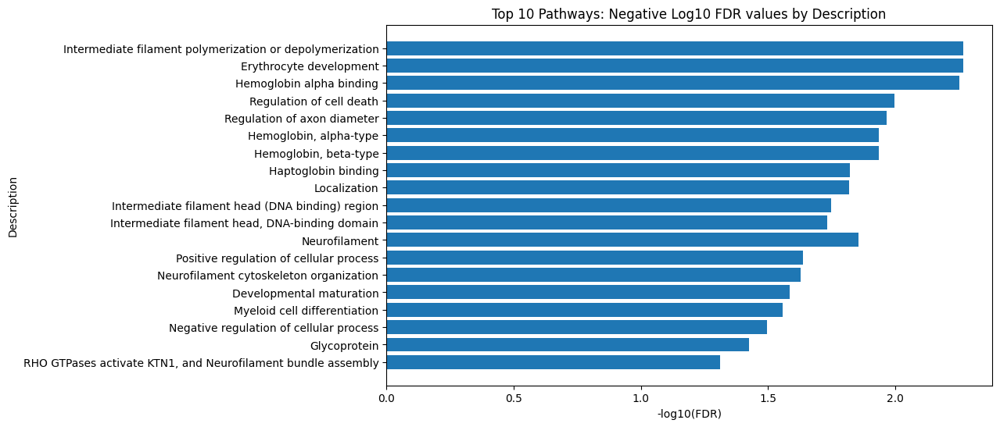

In [74]:
genes = STRINGdb_list
string_ids = stringdb.get_string_ids(genes, species = 10090)   # human is 'species=9606'

# Performe pathway enrichment
enrichment_df = stringdb.get_enrichment(string_ids.queryItem, species = 10090)
enrichment_df
df = enrichment_df
sorted_df = df.sort_values(by='fdr', ascending=False)

# Select the top 10 pathways to visualise
top_10_pathways = sorted_df['description'].head(20)

print("Top 10 Pathways:")
print(top_10_pathways)

# Plotting negative log10 of FDR values against description to discern most significant pathways
plt.figure(figsize=(10, 6))
plt.barh(sorted_df['description'].head(20), -1 * sorted_df['fdr'].head(20).apply(lambda x: math.log10(x)))
plt.xlabel('-log10(FDR)')
plt.ylabel('Description')
plt.title('Top 10 Pathways: Negative Log10 FDR values by Description')
plt.show()